In [22]:
import pinecone
from pinecone import Pinecone, ServerlessSpec
import os
from dotenv import load_dotenv
import base64

In [23]:
load_dotenv() 

True

## Pinecone Setup

In [24]:
pc=Pinecone(api_key=os.getenv("PINECONE_API_KEY"))
index_name=os.getenv("INDEX_NAME")
index_list = [index.name for index in pc.list_indexes()]

spec=ServerlessSpec(
    cloud="aws",
    region=os.getenv("PINECONE_ENVIRONMENT")
)

In [25]:
if index_name not in index_list:
    pc.create_index(
        name = index_name,
        dimension = 1024,
        metric = "cosine",
        spec = spec
    )
else: 
    index = pc.Index(index_name)
    dimension = index.describe_index_stats()["dimension"]
    if dimension != 1024:
        pc.delete_index(index_name)
        pc.create_index(
            name = index_name,
            dimension = 1024,
            metric = "cosine",
            spec = spec
        )

## OCR Setup

In [36]:
from mistralai import Mistral
from mistralai.models import OCRResponse
from IPython.display import Markdown, display

In [27]:
api_key = os.environ.get("MISTRAL_API_KEY")
client = Mistral(api_key=api_key)

In [28]:

def ocr_response(file_path: str) -> OCRResponse:
    '''
    This function takes a file path and returns the OCR response.
    '''
    uploaded_pdf = client.files.upload(
        file={
            "file_name": os.path.basename(file_path),
            "content": open(file_path, "rb"),
        },
    purpose="ocr"
    )  

    # Getting the signed URL for the uploaded PDF
    signed_url = client.files.get_signed_url(file_id=uploaded_pdf.id)

    # To extract text from the uploaded PDF using OCR
    ocr_response = client.ocr.process(
    model="mistral-ocr-latest",
    document={
        "type": "document_url",
        "document_url": signed_url.url,
      },
      include_image_base64=True
    )

    # response_dict = json.loads(ocr_response.model_dump_json())
    return ocr_response

In [29]:
def replace_images_in_markdown(markdown_str: str, images_dict: dict) -> str:
    """
    Replace image placeholders in markdown with base64-encoded images.

    Args:
        markdown_str: Markdown text containing image placeholders
        images_dict: Dictionary mapping image IDs to base64 strings

    Returns:
        Markdown text with images replaced by base64 data
    """
    for img_name, base64_str in images_dict.items():
        markdown_str = markdown_str.replace(
            f"![{img_name}]({img_name})", f"![{img_name}]({base64_str})"
        )
    return markdown_str

def get_combined_markdown(ocr_response: dict) -> str:
    """
    Combine OCR text and images into a single markdown document.

    Args:
        ocr_response: Response from OCR processing containing text and images

    Returns:
        Combined markdown string with embedded images
    """
    markdowns: list[str] = []
    # Extract images from page
    for page in ocr_response.pages:
        image_data = {}
        for img in page.images:
            image_data[img.id] = img.image_base64
        # Replace image placeholders with actual images
        markdowns.append(replace_images_in_markdown(page.markdown, image_data))

    return "\n\n".join(markdowns)

In [30]:
def get_ocr_response(file_path: str) -> OCRResponse:
    '''
    This function takes a file path and returns the OCR response.
    '''
    file_ocr = ocr_response(file_path)
    file_ocr_images = get_combined_markdown(file_ocr)
    return file_ocr, file_ocr_images

In [31]:
dir_name = 'Financial_Docs'
files = sorted(os.listdir(dir_name))
files

['apple_10k_2024.pdf', 'nvidia_10k_2025.pdf']

In [37]:
# Process each file with OCR
apple_10k_ocr, apple_10k_ocr_images = get_ocr_response(os.path.join(dir_name, files[0]))
nvidia_10k_ocr, nvidia_10k_ocr_images = get_ocr_response(os.path.join(dir_name, files[1]))

'# UNITED STATES <br> SECURITIES AND EXCHANGE COMMISSION Washington, D.C. 20549 \n\n## FORM 10-K\n\n(Mark One)\n(1) ANNUAL REPORT PURSUANT TO SECTION 13 OR 15(d) OF THE SECURITIES EXCHANGE ACT OF 1934\n\nFor the fiscal year ended September 28, 2024\nor\n$\\square$ TRANSITION REPORT PURSUANT TO SECTION 13 OR 15(d) OF THE SECURITIES EXCHANGE ACT OF 1934\nFor the transition period from $\\qquad$ to $\\qquad$ .\n\nCommission File Number: 001-36743\n\n## Apple Inc.\n\n(Exact name of Registrant as specified in its charter)\n\n## California\n\n(State or other jurisdiction of incorporation or organization)\n\n## One Apple Park Way\n\nCupertino, California\n(Address of principal executive offices)\n94-2404110\n(I.R.S. Employer Identification No.)\n\n## 95014\n\n(Zip Code)\n(408) 996-1010\n(Registrant\'s telephone number, including area code)\n\nSecurities registered pursuant to Section 12(b) of the Act:\n\n| Title of each class | Trading symbol(s) | Name of each exchange on which registered |\n
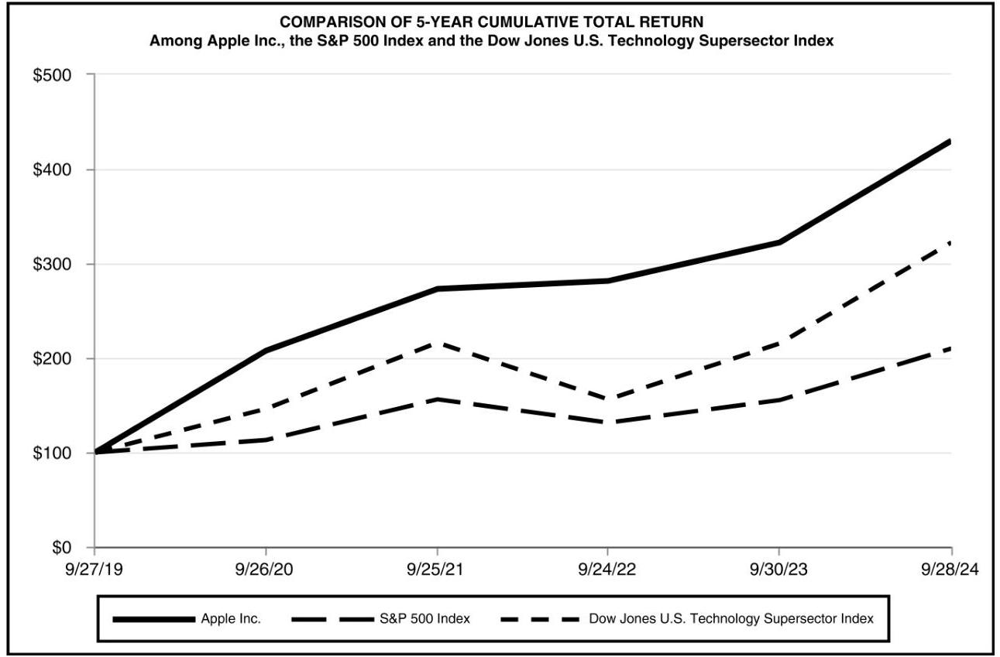

In [39]:
apple_10k_ocr_images

# UNITED STATES <br> SECURITIES AND EXCHANGE COMMISSION Washington, D.C. 20549 

## FORM 10-K

(Mark One)
(1) ANNUAL REPORT PURSUANT TO SECTION 13 OR 15(d) OF THE SECURITIES EXCHANGE ACT OF 1934

For the fiscal year ended September 28, 2024
or
$\square$ TRANSITION REPORT PURSUANT TO SECTION 13 OR 15(d) OF THE SECURITIES EXCHANGE ACT OF 1934
For the transition period from $\qquad$ to $\qquad$ .

Commission File Number: 001-36743

## Apple Inc.

(Exact name of Registrant as specified in its charter)

## California

(State or other jurisdiction of incorporation or organization)

## One Apple Park Way

Cupertino, California
(Address of principal executive offices)
94-2404110
(I.R.S. Employer Identification No.)

## 95014

(Zip Code)
(408) 996-1010
(Registrant's telephone number, including area code)

Securities registered pursuant to Section 12(b) of the Act:

| Title of each class | Trading symbol(s) | Name of each exchange on which registered |
| :--: | :--: | :--: |
| Common Stock, \$0.00001 par value per share | AAPL | The Nasdaq Stock Market LLC |
| $0.000 \%$ Notes due 2025 | - | The Nasdaq Stock Market LLC |
| $0.875 \%$ Notes due 2025 | - | The Nasdaq Stock Market LLC |
| $1.625 \%$ Notes due 2026 | - | The Nasdaq Stock Market LLC |
| $2.000 \%$ Notes due 2027 | - | The Nasdaq Stock Market LLC |
| $1.375 \%$ Notes due 2029 | - | The Nasdaq Stock Market LLC |
| $3.050 \%$ Notes due 2029 | - | The Nasdaq Stock Market LLC |
| $0.500 \%$ Notes due 2031 | - | The Nasdaq Stock Market LLC |
| $3.600 \%$ Notes due 2042 | - | The Nasdaq Stock Market LLC |

Securities registered pursuant to Section 12(g) of the Act: None

Indicate by check mark if the Registrant is a well-known seasoned issuer, as defined in Rule 405 of the Securities Act.
Yes $\boxtimes$ No $\square$
Indicate by check mark if the Registrant is not required to file reports pursuant to Section 13 or Section 15(d) of the Act.
Yes $\square$ No $\boxtimes$

Indicate by check mark whether the Registrant (1) has filed all reports required to be filed by Section 13 or 15(d) of the Securities Exchange Act of 1934 during the preceding 12 months (or for such shorter period that the Registrant was required to file such reports), and (2) has been subject to such filing requirements for the past 90 days.

Yes $\boxtimes$ No $\square$
Indicate by check mark whether the Registrant has submitted electronically every Interactive Data File required to be submitted pursuant to Rule 405 of Regulation S-T (§232.405 of this chapter) during the preceding 12 months (or for such shorter period that the Registrant was required to submit such files).

Indicate by check mark whether the Registrant is a large accelerated filer, an accelerated filer, a non-accelerated filer, a smaller reporting company, or an emerging growth company. See the definitions of "large accelerated filer," "accelerated filer," "smaller reporting company," and "emerging growth company" in Rule 12b-2 of the Exchange Act.

| Large accelerated filer | 园 | Accelerated filer |
| :--: | :--: | :--: |
| Non-accelerated filer | $\square$ | Smaller reporting company |
|  |  | Emerging growth company |

If an emerging growth company, indicate by check mark if the Registrant has elected not to use the extended transition period for complying with any new or revised financial accounting standards provided pursuant to Section 13(a) of the Exchange Act. $\square$

Indicate by check mark whether the Registrant has filed a report on and attestation to its management's assessment of the effectiveness of its internal control over financial reporting under Section 404(b) of the Sarbanes-Oxley Act (15 U.S.C. 7262(b)) by the registered public accounting firm that prepared or issued its audit report. $\boxtimes$

If securities are registered pursuant to Section 12(b) of the Act, indicate by check mark whether the financial statements of the registrant included in the filing reflect the correction of an error to previously issued financial statements. $\square$

Indicate by check mark whether any of those error corrections are restatements that required a recovery analysis of incentive-based compensation received by any of the registrant's executive officers during the relevant recovery period pursuant to $\S 240.10 \mathrm{D}-1(\mathrm{~b})$. $\square$

Indicate by check mark whether the Registrant is a shell company (as defined in Rule 12b-2 of the Act).
Yes $\square$ No $\boxtimes$
The aggregate market value of the voting and non-voting stock held by non-affiliates of the Registrant, as of March 29, 2024, the last business day of the Registrant's most recently completed second fiscal quarter, was approximately $\$ 2,628,553,000,000$. Solely for purposes of this disclosure, shares of common stock held by executive officers and directors of the Registrant as of such date have been excluded because such persons may be deemed to be affiliates. This determination of executive officers and directors as affiliates is not necessarily a conclusive determination for any other purposes.
$15,115,823,000$ shares of common stock were issued and outstanding as of October 18, 2024.

# DOCUMENTS INCORPORATED BY REFERENCE 

Portions of the Registrant's definitive proxy statement relating to its 2025 annual meeting of shareholders are incorporated by reference into Part III of this Annual Report on Form 10-K where indicated. The Registrant's definitive proxy statement will be filed with the U.S. Securities and Exchange Commission within 120 days after the end of the fiscal year to which this report relates.

|   |  |  |  |  |  |  |  |  |  |  |
| --- | --- | --- | --- | --- | --- | --- | --- | --- | --- | --- |
|   |  |  |  |  |  |  |  |  |  |  |
|  Apple Inc. |  |  |  |  |  |  |  |  |  |   |
|  Form 10-K |  |  |  |  |  |  |  |  |  |   |
|  For the Fiscal Year Ended September 28, 2024 |  |  |  |  |  |  |  |  |  |   |
|  TABLE OF CONTENTS |  |  |  |  |  |  |  |  |  |   |
|   |  |  |  | Part I |  |  |  |  |  |   |
|  Item 1. |  | Business |  |  |  |  |  |  |  | 1  |
|  Item 1A. |  | Risk Factors |  |  |  |  |  |  |  | 5  |
|  Item 1B. |  | Unresolved Staff Comments |  |  |  |  |  |  |  | 17  |
|  Item 1C. |  | Cybersecurity |  |  |  |  |  |  |  | 17  |
|  Item 2. |  | Properties |  |  |  |  |  |  |  | 18  |
|  Item 3. |  | Legal Proceedings |  |  |  |  |  |  |  | 18  |
|  Item 4. |  | Mine Safety Disclosures |  |  |  |  |  |  |  | 18  |
|   |  |  | Part II |  |  |  |  |  |  |   |
|  Item 5. |  | Market for Registrant’s Common Equity, Related Stockholder Matters and Issuer Purchases of Equity Securities |  |  |  |  |  |  |  | 19  |
|  Item 6. |  | (Reserved) |  |  |  |  |  |  |  | 20  |
|  Item 7. |  | Management’s Discussion and Analysis of Financial Condition and Results of Operations |  |  |  |  |  |  |  | 21  |
|  Item 7A. |  | Quantitative and Qualitative Disclosures About Market Risk |  |  |  |  |  |  |  | 27  |
|  Item 8. |  | Financial Statements and Supplementary Data |  |  |  |  |  |  |  | 28  |
|  Item 9. |  | Changes in and Disagreements with Accountants on Accounting and Financial Disclosure |  |  |  |  |  |  |  | 51  |
|  Item 9A. |  | Controls and Procedures |  |  |  |  |  |  |  | 51  |
|  Item 9B. |  | Other Information |  |  |  |  |  |  |  | 52  |
|  Item 9C. |  | Disclosure Regarding Foreign Jurisdictions that Prevent Inspections |  |  |  |  |  |  |  | 52  |
|   |  |  | Part III |  |  |  |  |  |  |   |
|  Item 10. |  | Directors, Executive Officers and Corporate Governance |  |  |  |  |  |  |  | 52  |
|  Item 11. |  | Executive Compensation |  |  |  |  |  |  |  | 52  |
|  Item 12. |  | Security Ownership of Certain Beneficial Owners and Management and Related Stockholder Matters |  |  |  |  |  |  |  | 52  |
|  Item 13. |  | Certain Relationships and Related Transactions and Director Independence |  |  |  |  |  |  |  | 52  |
|  Item 14. |  | Principal Accountant Fees and Services |  |  |  |  |  |  |  | 52  |
|   |  |  | Part IV |  |  |  |  |  |  |   |
|  Item 15. |  | Exhibit and Financial Statement Schedules |  |  |  |  |  |  |  | 53  |
|  Item 16. |  | Form 10-K Summary |  |  |  |  |  |  |  | 56  |

This Annual Report on Form 10-K ("Form 10-K") contains forward-looking statements, within the meaning of the Private Securities Litigation Reform Act of 1995, that involve risks and uncertainties. Many of the forward-looking statements are located in Part I, Item 1 of this Form 10-K under the heading "Business" and Part II, Item 7 of this Form 10-K under the heading "Management's Discussion and Analysis of Financial Condition and Results of Operations." Forward-looking statements provide current expectations of future events based on certain assumptions and include any statement that does not directly relate to any historical or current fact. For example, statements in this Form 10-K regarding the potential future impact of macroeconomic conditions on the Company's business and results of operations are forward-looking statements. Forward-looking statements can also be identified by words such as "future," "anticipates," "believes," "estimates," "expects," "intends," "plans," "predicts," "will," "would," "could," "can," "may," and similar terms. Forward-looking statements are not guarantees of future performance and the Company's actual results may differ significantly from the results discussed in the forward-looking statements. Factors that might cause such differences include, but are not limited to, those discussed in Part I, Item 1A of this Form 10-K under the heading "Risk Factors." The Company assumes no obligation to revise or update any forward-looking statements for any reason, except as required by law.

Unless otherwise stated, all information presented herein is based on the Company's fiscal calendar, and references to particular years, quarters, months or periods refer to the Company's fiscal years ended in September and the associated quarters, months and periods of those fiscal years. Each of the terms the "Company" and "Apple" as used herein refers collectively to Apple Inc. and its wholly owned subsidiaries, unless otherwise stated.

# PART I 

## Item 1. Business

## Company Background

The Company designs, manufactures and markets smartphones, personal computers, tablets, wearables and accessories, and sells a variety of related services. The Company's fiscal year is the 52- or 53-week period that ends on the last Saturday of September.

## Products

## iPhone

iPhone ${ }^{\circledR}$ is the Company's line of smartphones based on its iOS operating system. The iPhone line includes iPhone 16 Pro, iPhone 16, iPhone 15, iPhone 14 and iPhone $\mathrm{SE}^{\circledR}$.

## Mac

$\mathrm{Mac}^{\circledR}$ is the Company's line of personal computers based on its macOS ${ }^{\circledR}$ operating system. The Mac line includes laptops MacBook Air ${ }^{\circledR}$ and MacBook Pro ${ }^{\circledR}$, as well as desktops iMac ${ }^{\circledR}$, Mac mini ${ }^{\circledR}$, Mac Studio ${ }^{\circledR}$ and Mac Pro ${ }^{\circledR}$.

## iPad

iPad ${ }^{\circledR}$ is the Company's line of multipurpose tablets based on its iPadOS ${ }^{\circledR}$ operating system. The iPad line includes iPad Pro ${ }^{\circledR}$, iPad Air ${ }^{\circledR}$, iPad and iPad mini ${ }^{\circledR}$.

## Wearables, Home and Accessories

Wearables includes smartwatches, wireless headphones and spatial computers. The Company's line of smartwatches, based on its watchOS ${ }^{\circledR}$ operating system, includes Apple Watch Ultra ${ }^{\circledR}$ 2, Apple Watch ${ }^{\circledR}$ Series 10 and Apple Watch $\mathrm{SE}^{\circledR}$. The Company's line of wireless headphones includes AirPods ${ }^{\circledR}$, AirPods Pro ${ }^{\circledR}$, AirPods Max ${ }^{\circledR}$ and Beats ${ }^{\circledR}$ products. Apple Vision Pro ${ }^{\mathrm{TM}}$ is the Company's first spatial computer based on its visionOS ${ }^{\mathrm{TM}}$ operating system.

Home includes Apple TV ${ }^{\circledR}$, the Company's media streaming and gaming device based on its tvOS ${ }^{\circledR}$ operating system, and HomePod ${ }^{\circledR}$ and HomePod mini ${ }^{\circledR}$, high-fidelity wireless smart speakers.

Accessories includes Apple-branded and third-party accessories.

# Services 

## Advertising

The Company's advertising services include third-party licensing arrangements and the Company's own advertising platforms.

## AppleCare

The Company offers a portfolio of fee-based service and support products under the AppleCare ${ }^{\circledR}$ brand. The offerings provide priority access to Apple technical support, access to the global Apple authorized service network for repair and replacement services, and in many cases additional coverage for instances of accidental damage or theft and loss, depending on the country and type of product.

## Cloud Services

The Company's cloud services store and keep customers' content up-to-date and available across multiple Apple devices and Windows personal computers.

## Digital Content

The Company operates various platforms, including the App Store ${ }^{\circledR}$, that allow customers to discover and download applications and digital content, such as books, music, video, games and podcasts.

The Company also offers digital content through subscription-based services, including Apple Arcade ${ }^{\circledR}$, a game subscription service; Apple Fitness+ ${ }^{\text {S }}$, a personalized fitness service; Apple Music ${ }^{\circledR}$, which offers users a curated listening experience with on-demand radio stations; Apple News ${ }^{+{ }^{\circledR}}$, a subscription news and magazine service; and Apple TV+ ${ }^{\circledR}$, which offers exclusive original content and live sports.

## Payment Services

The Company offers payment services, including Apple Card ${ }^{\circledR}$, a co-branded credit card, and Apple Pay ${ }^{\circledR}$, a cashless payment service.

## Segments

The Company manages its business primarily on a geographic basis. The Company's reportable segments consist of the Americas, Europe, Greater China, Japan and Rest of Asia Pacific. Americas includes both North and South America. Europe includes European countries, as well as India, the Middle East and Africa. Greater China includes China mainland, Hong Kong and Taiwan. Rest of Asia Pacific includes Australia and those Asian countries not included in the Company's other reportable segments. Although the reportable segments provide similar hardware and software products and similar services, each one is managed separately to better align with the location of the Company's customers and distribution partners and the unique market dynamics of each geographic region.

## Markets and Distribution

The Company's customers are primarily in the consumer, small and mid-sized business, education, enterprise and government markets. The Company sells its products and resells third-party products in most of its major markets directly to customers through its retail and online stores and its direct sales force. The Company also employs a variety of indirect distribution channels, such as third-party cellular network carriers, wholesalers, retailers and resellers. During 2024, the Company's net sales through its direct and indirect distribution channels accounted for $38 \%$ and $62 \%$, respectively, of total net sales.

## Competition

The markets for the Company's products and services are highly competitive, and are characterized by aggressive price competition and resulting downward pressure on gross margins, frequent introduction of new products and services, short product life cycles, evolving industry standards, continual improvement in product price and performance characteristics, rapid adoption of technological advancements by competitors, and price sensitivity on the part of consumers and businesses. Many of the Company's competitors seek to compete primarily through aggressive pricing and very low cost structures, and by imitating the Company's products and infringing on its intellectual property.

The Company's ability to compete successfully depends heavily on ensuring the continuing and timely introduction of innovative new products, services and technologies to the marketplace. The Company designs and develops nearly the entire solution for its products, including the hardware, operating system, numerous software applications and related services. Principal competitive factors important to the Company include price, product and service features (including security features), relative price and performance, product and service quality and reliability, design innovation, a strong third-party software and accessories ecosystem, marketing and distribution capability, service and support, and corporate reputation.

The Company is focused on expanding its market opportunities related to smartphones, personal computers, tablets, wearables and accessories, and services. The Company faces substantial competition in these markets from companies that have significant technical, marketing, distribution and other resources, as well as established hardware, software, and service offerings with large customer bases. In addition, some of the Company's competitors have broader product lines, lower-priced products and a larger installed base of active devices. Competition has been particularly intense as competitors have aggressively cut prices and lowered product margins. Certain competitors have the resources, experience or cost structures to provide products at little or no profit or even at a loss. The Company's services compete with business models that provide content to users for free and use illegitimate means to obtain third-party digital content and applications. The Company faces significant competition as competitors imitate the Company's product features and applications within their products, or collaborate to offer integrated solutions that are more competitive than those they currently offer.

# Supply of Components 

Although most components essential to the Company's business are generally available from multiple sources, certain components are currently obtained from single or limited sources. The Company also competes for various components with other participants in the markets for smartphones, personal computers, tablets, wearables and accessories. Therefore, many components used by the Company, including those that are available from multiple sources, are at times subject to industry-wide shortage and significant commodity pricing fluctuations.

The Company uses some custom components that are not commonly used by its competitors, and new products introduced by the Company often utilize custom components available from only one source. When a component or product uses new technologies, initial capacity constraints may exist until the suppliers' yields have matured or their manufacturing capacities have increased. The continued availability of these components at acceptable prices, or at all, may be affected if suppliers decide to concentrate on the production of common components instead of components customized to meet the Company's requirements.

The Company has entered into agreements for the supply of many components; however, there can be no guarantee that the Company will be able to extend or renew these agreements on similar terms, or at all.

## Research and Development

Because the industries in which the Company competes are characterized by rapid technological advances, the Company's ability to compete successfully depends heavily upon its ability to ensure a continual and timely flow of competitive products, services and technologies to the marketplace. The Company continues to develop new technologies to enhance existing products and services, and to expand the range of its offerings through research and development ("R\&D"), licensing of intellectual property and acquisition of third-party businesses and technology.

## Intellectual Property

The Company currently holds a broad collection of intellectual property rights relating to certain aspects of its hardware, accessories, software and services. This includes patents, designs, copyrights, trademarks, trade secrets and other forms of intellectual property rights in the U.S. and various foreign countries. Although the Company believes the ownership of such intellectual property rights is an important factor in differentiating its business and that its success does depend in part on such ownership, the Company relies primarily on the innovative skills, technical competence and marketing abilities of its personnel.

The Company regularly files patent, design, copyright and trademark applications to protect innovations arising from its research, development, design and marketing, and is currently pursuing thousands of applications around the world. Over time, the Company has accumulated a large portfolio of issued and registered intellectual property rights around the world. No single intellectual property right is solely responsible for protecting the Company's products and services. The Company believes the duration of its intellectual property rights is adequate relative to the expected lives of its products and services.

In addition to Company-owned intellectual property, many of the Company's products and services are designed to include intellectual property owned by third parties. It may be necessary in the future to seek or renew licenses relating to various aspects of the Company's products, processes and services. While the Company has generally been able to obtain such licenses on commercially reasonable terms in the past, there is no guarantee that such licenses could be obtained in the future on reasonable terms or at all.

# Business Seasonality and Product Introductions 

The Company has historically experienced higher net sales in its first quarter compared to other quarters in its fiscal year due in part to seasonal holiday demand. Additionally, new product and service introductions can significantly impact net sales, cost of sales and operating expenses. The timing of product introductions can also impact the Company's net sales to its indirect distribution channels as these channels are filled with new inventory following a product launch, and channel inventory of an older product often declines as the launch of a newer product approaches. Net sales can also be affected when consumers and distributors anticipate a product introduction.

## Human Capital

The Company believes that its people play an important role in its success, and strives to attract, develop and retain the best talent. The Company works to create an inclusive, safe and supportive environment for all of its team members, so that its people can do the best work of their lives. As of September 28, 2024, the Company had approximately 164,000 full-time equivalent employees.

## Compensation and Benefits

The Company believes that compensation should be competitive and equitable, and should enable employees to share in the Company's success. The Company recognizes its people are most likely to thrive when they have the resources to meet their needs and the time and support to succeed in their professional and personal lives. In support of this, the Company offers a wide variety of benefits for employees around the world, including health, wellness and time away.

## Growth and Development

The Company invests in resources to help its people develop and achieve their career goals. The Company offers programs through Apple University on leadership, management and influence, as well as Apple culture and values. Team members can also take advantage of online classes for business, technical and personal development, as well as learning opportunities to support their well-being.

## Workplace Practices and Policies

The Company is an equal opportunity employer committed to inclusion and diversity and to providing a workplace free of harassment or discrimination.

## Inclusion and Diversity

The Company is committed to its vision to build and sustain a more inclusive workforce that is representative of the communities it serves. The Company continues to work to increase diverse representation at every level, foster an inclusive culture, and support equitable pay and access to opportunity for all employees.

## Engagement

The Company believes that open and honest communication among team members, managers and leaders helps create an open, collaborative work environment where everyone can contribute, grow and succeed. Team members are encouraged to come to their managers with questions, feedback or concerns, and the Company conducts surveys that gauge employee sentiment in areas like career development, manager performance and inclusivity.

## Health and Safety

The Company is committed to protecting its team members everywhere it operates. The Company identifies potential workplace risks in order to develop measures to mitigate possible hazards. The Company supports employees with general safety, security and crisis management training, and by putting specific programs in place for those working in potentially high-hazard environments. Additionally, the Company works to protect the safety and security of its team members, visitors and customers through its global security team.

# Available Information 

The Company's Annual Reports on Form 10-K, Quarterly Reports on Form 10-Q, Current Reports on Form 8-K, and amendments to reports filed pursuant to Sections 13(a) and 15(d) of the Securities Exchange Act of 1934, as amended (the "Exchange Act"), are filed with the U.S. Securities and Exchange Commission (the "SEC"). Such reports and other information filed by the Company with the SEC are available free of charge at investor.apple.com/investorrelations/sec-filings/default.aspx when such reports are available on the SEC's website. The Company periodically provides certain information for investors on its corporate website, www.apple.com, and its investor relations website, investor.apple.com. This includes press releases and other information about financial performance, information on environmental, social and governance matters, and details related to the Company's annual meeting of shareholders. The information contained on the websites referenced in this Form 10-K is not incorporated by reference into this filing. Further, the Company's references to website URLs are intended to be inactive textual references only.

## Item 1A. Risk Factors

The Company's business, reputation, results of operations, financial condition and stock price can be affected by a number of factors, whether currently known or unknown, including those described below. When any one or more of these risks materialize from time to time, the Company's business, reputation, results of operations, financial condition and stock price can be materially and adversely affected.

Because of the following factors, as well as other factors affecting the Company's results of operations and financial condition, past financial performance should not be considered to be a reliable indicator of future performance, and investors should not use historical trends to anticipate results or trends in future periods. This discussion of risk factors contains forward-looking statements.

This section should be read in conjunction with Part II, Item 7, "Management's Discussion and Analysis of Financial Condition and Results of Operations" and the consolidated financial statements and accompanying notes in Part II, Item 8, "Financial Statements and Supplementary Data" of this Form 10-K.

## Macroeconomic and Industry Risks

The Company's operations and performance depend significantly on global and regional economic conditions and adverse economic conditions can materially adversely affect the Company's business, results of operations and financial condition.
The Company has international operations with sales outside the U.S. representing a majority of the Company's total net sales. In addition, the Company's global supply chain is large and complex and a majority of the Company's supplier facilities, including manufacturing and assembly sites, are located outside the U.S. As a result, the Company's operations and performance depend significantly on global and regional economic conditions.

Adverse macroeconomic conditions, including slow growth or recession, high unemployment, inflation, tighter credit, higher interest rates, and currency fluctuations, can adversely impact consumer confidence and spending and materially adversely affect demand for the Company's products and services. In addition, consumer confidence and spending can be materially adversely affected in response to changes in fiscal and monetary policy, financial market volatility, declines in income or asset values, and other economic factors.

In addition to an adverse impact on demand for the Company's products and services, uncertainty about, or a decline in, global or regional economic conditions can have a significant impact on the Company's suppliers, contract manufacturers, logistics providers, distributors, cellular network carriers and other channel partners, and developers. Potential outcomes include financial instability; inability to obtain credit to finance business operations; and insolvency.

Adverse economic conditions can also lead to increased credit and collectibility risk on the Company's trade receivables; the failure of derivative counterparties and other financial institutions; limitations on the Company's ability to issue new debt; reduced liquidity; and declines in the fair values of the Company's financial instruments. These and other impacts can materially adversely affect the Company's business, results of operations, financial condition and stock price.

The Company's business can be impacted by political events, trade and other international disputes, geopolitical tensions, conflict, terrorism, natural disasters, public health issues, industrial accidents and other business interruptions.

Political events, trade and other international disputes, geopolitical tensions, conflict, terrorism, natural disasters, public health issues, industrial accidents and other business interruptions can have a material adverse effect on the Company and its customers, employees, suppliers, contract manufacturers, logistics providers, distributors, cellular network carriers and other channel partners.

The Company has a large, global business with sales outside the U.S. representing a majority of the Company's total net sales, and the Company believes that it generally benefits from growth in international trade. Substantially all of the Company's manufacturing is performed in whole or in part by outsourcing partners located primarily in China mainland, India, Japan, South Korea, Taiwan and Vietnam. Restrictions on international trade, such as tariffs and other controls on imports or exports of goods, technology or data, can materially adversely affect the Company's business and supply chain. The impact can be particularly significant if these restrictive measures apply to countries and regions where the Company derives a significant portion of its revenues and/or has significant supply chain operations. Restrictive measures can increase the cost of the Company's products and the components and raw materials that go into them, and can require the Company to take various actions, including changing suppliers, restructuring business relationships and operations, and ceasing to offer and distribute affected products, services and third-party applications to its customers. Changing the Company's business and supply chain in accordance with new or changed restrictions on international trade can be expensive, time-consuming and disruptive to the Company's operations. Such restrictions can be announced with little or no advance notice, which can create uncertainty, and the Company may not be able to effectively mitigate all adverse impacts from such measures. For example, tensions between governments, including the U.S. and China, have in the past led to tariffs and other restrictions affecting the Company's business. If disputes and conflicts further escalate in the future, actions by governments in response could be significantly more severe and restrictive and could materially adversely affect the Company's business.

Many of the Company's operations and facilities, as well as critical business operations of the Company's suppliers and contract manufacturers, are in locations that are prone to earthquakes and other natural disasters. Global climate change is resulting in certain types of natural disasters and extreme weather occurring more frequently or with more intense effects. In addition, the Company's and its suppliers' operations and facilities are subject to the risk of interruption by fire, power shortages, nuclear power plant accidents and other industrial accidents, terrorist attacks and other hostile acts, ransomware and other cybersecurity attacks, labor disputes, public health issues and other events beyond the Company's control. For example, global supply chains can be highly concentrated and geopolitical tensions or conflict could result in significant disruptions.

Such events can make it difficult or impossible for the Company to manufacture and deliver products to its customers, create delays and inefficiencies in the Company's supply and manufacturing chain, result in slowdowns and outages to the Company's service offerings, increase the Company's costs, and negatively impact consumer spending and demand in affected areas.

The Company's operations are also subject to the risks of industrial accidents at its suppliers and contract manufacturers. While the Company's suppliers are required to maintain safe working environments and operations, an industrial accident could occur and could result in serious injuries or loss of life, disruption to the Company's business, and harm to the Company's reputation. Major public health issues, including pandemics such as the COVID-19 pandemic, have adversely affected, and could in the future materially adversely affect, the Company due to their impact on the global economy and demand for consumer products; the imposition of protective public safety measures, such as stringent employee travel restrictions and limitations on freight services and the movement of products between regions; and disruptions in the Company's operations, supply chain and sales and distribution channels, resulting in interruptions to the supply of current products and offering of existing services, and delays in production ramps of new products and development of new services.

Following any interruption to its business, the Company can require substantial recovery time, experience significant expenditures to resume operations, and lose significant sales. Because the Company relies on single or limited sources for the supply and manufacture of many critical components, a business interruption affecting such sources would exacerbate any negative consequences to the Company. While the Company maintains insurance coverage for certain types of losses, such insurance coverage may be insufficient to cover all losses that may arise.

# Global markets for the Company's products and services are highly competitive and subject to rapid technological change, and the Company may be unable to compete effectively in these markets. 

The Company's products and services are offered in highly competitive global markets characterized by aggressive price competition and resulting downward pressure on gross margins, frequent introduction of new products and services, short product life cycles, evolving industry standards, continual improvement in product price and performance characteristics, rapid adoption of technological advancements by competitors, and price sensitivity on the part of consumers and businesses.

The Company's ability to compete successfully depends heavily on ensuring the continuing and timely introduction of innovative new products, services and technologies to the marketplace. The Company designs and develops nearly the entire solution for its products, including the hardware, operating system, numerous software applications and related services. As a result, the Company must make significant investments in R\&D. There can be no assurance these investments will achieve expected returns, and the Company may not be able to develop and market new products and services successfully.

The Company currently holds a significant number of patents, trademarks and copyrights and has registered, and applied to register, additional patents, trademarks and copyrights. In contrast, many of the Company's competitors seek to compete primarily through aggressive pricing and very low cost structures, and by imitating the Company's products and infringing on its intellectual property. Effective intellectual property protection is not consistently available in every country in which the Company operates. If the Company is unable to continue to develop and sell innovative new products with attractive margins or if competitors infringe on the Company's intellectual property, the Company's ability to maintain a competitive advantage could be materially adversely affected.

The Company has a minority market share in the global smartphone, personal computer and tablet markets. The Company faces substantial competition in these markets from companies that have significant technical, marketing, distribution and other resources, as well as established hardware, software and digital content supplier relationships. In addition, some of the Company's competitors have broader product lines, lower-priced products and a larger installed base of active devices. Competition has been particularly intense as competitors have aggressively cut prices and lowered product margins. Certain competitors have the resources, experience or cost structures to provide products at little or no profit or even at a loss. Some of the markets in which the Company competes have from time to time experienced little to no growth or contracted overall.

Additionally, the Company faces significant competition as competitors imitate the Company's product features and applications within their products or collaborate to offer solutions that are more competitive than those they currently offer. The Company also expects competition to intensify as competitors imitate the Company's approach to providing components seamlessly within their offerings or work collaboratively to offer integrated solutions.

The Company's services also face substantial competition, including from companies that have significant resources and experience and have established service offerings with large customer bases. The Company competes with business models that provide content to users for free. The Company also competes with illegitimate means to obtain third-party digital content and applications.

The Company's business, results of operations and financial condition depend substantially on the Company's ability to continually improve its products and services to maintain their functional and design advantages. There can be no assurance the Company will be able to continue to provide products and services that compete effectively.

## Business Risks

## To remain competitive and stimulate customer demand, the Company must successfully manage frequent introductions and transitions of products and services.

Due to the highly volatile and competitive nature of the markets and industries in which the Company competes, the Company must continually introduce new products, services and technologies, enhance existing products and services, effectively stimulate customer demand for new and upgraded products and services, and successfully manage the transition to these new and upgraded products and services. The success of new product and service introductions depends on a number of factors, including timely and successful development, market acceptance, the Company's ability to manage the risks associated with new technologies and production ramp-up issues, the availability of application software or other third-party support for the Company's products and services, the effective management of purchase commitments and inventory levels in line with anticipated product demand, the availability of products in appropriate quantities and at expected costs to meet anticipated demand, and the risk that new products and services may have quality or other defects or deficiencies. New products, services and technologies may replace or supersede existing offerings and may produce lower revenues and lower profit margins, which can materially adversely impact the Company's business, results of operations and financial condition. There can be no assurance the Company will successfully manage future introductions and transitions of products and services.

The Company depends on component and product manufacturing and logistical services provided by outsourcing partners, many of which are located outside of the U.S.

Substantially all of the Company's manufacturing is performed in whole or in part by outsourcing partners located primarily in China mainland, India, Japan, South Korea, Taiwan and Vietnam, and a significant concentration of this manufacturing is currently performed by a small number of outsourcing partners, often in single locations. The Company has also outsourced much of its transportation and logistics management. While these arrangements can lower operating costs, they also reduce the Company's direct control over production and distribution. Such diminished control has from time to time and may in the future have an adverse effect on the quality or quantity of products manufactured or services provided, or adversely affect the Company's flexibility to respond to changing conditions. Although arrangements with these partners may contain provisions for product defect expense reimbursement, the Company generally remains responsible to the consumer for warranty and out-of-warranty service in the event of product defects and experiences unanticipated product defect liabilities from time to time. While the Company relies on its partners to adhere to its supplier code of conduct, violations of the supplier code of conduct occur from time to time and can materially adversely affect the Company's business, reputation, results of operations and financial condition.

The Company relies on single-source outsourcing partners in the U.S., Asia and Europe to supply and manufacture many components, and on outsourcing partners primarily located in Asia, for final assembly of substantially all of the Company's hardware products. Any failure of these partners to perform can have a negative impact on the Company's cost or supply of components or finished goods. In addition, manufacturing or logistics in these locations or transit to final destinations can be disrupted for a variety of reasons, including natural and man-made disasters, information technology system failures, commercial disputes, economic, business, labor, environmental, public health or political issues, trade and other international disputes, geopolitical tensions, or conflict.

The Company has invested in manufacturing process equipment, much of which is held at certain of its outsourcing partners, and has made prepayments to certain of its suppliers associated with long-term supply agreements. While these arrangements help ensure the supply of components and finished goods, if these outsourcing partners or suppliers experience severe financial problems or other disruptions in their business, such continued supply can be disrupted or terminated, and the recoverability of manufacturing process equipment or prepayments can be negatively impacted.

Changes or additions to the Company's supply chain require considerable time and resources and involve significant risks and uncertainties, including exposure to additional regulatory and operational risks.

# Future operating results depend upon the Company's ability to obtain components in sufficient quantities on commercially reasonable terms. 

Because the Company currently obtains certain components from single or limited sources, the Company is subject to significant supply and pricing risks. Many components, including those that are available from multiple sources, are at times subject to industry-wide shortages and significant commodity pricing fluctuations that can materially adversely affect the Company's business, results of operations and financial condition. For example, the global semiconductor industry has in the past experienced high demand and shortages of supply, which adversely affected the Company's ability to obtain sufficient quantities of components and products on commercially reasonable terms, or at all. Such disruptions could occur in the future. While the Company has entered into agreements for the supply of many components, there can be no assurance the Company will be able to extend or renew these agreements on similar terms, or at all. In addition, component suppliers may suffer from poor financial conditions, which can lead to business failure for the supplier or consolidation within a particular industry, further limiting the Company's ability to obtain sufficient quantities of components on commercially reasonable terms, or at all. Therefore, the Company remains subject to significant risks of supply shortages and price increases that can materially adversely affect its business, results of operations and financial condition.

The Company's new products often utilize custom components available from only one source. When a component or product uses new technologies, initial capacity constraints may exist until the suppliers' yields have matured or their manufacturing capacities have increased. The continued availability of these components at acceptable prices, or at all, can be affected for any number of reasons, including if suppliers decide to concentrate on the production of common components instead of components customized to meet the Company's requirements. When the Company's supply of components for a new or existing product has been delayed or constrained, or when an outsourcing partner has delayed shipments of completed products to the Company, the Company's business, results of operations and financial condition have been adversely affected and future delays or constraints could materially adversely affect the Company's business, results of operations and financial condition. The Company's business and financial performance could also be materially adversely affected depending on the time required to obtain sufficient quantities from the source, or to identify and obtain sufficient quantities from an alternative source.

# The Company's products and services may be affected from time to time by design and manufacturing defects that could materially adversely affect the Company's business and result in harm to the Company's reputation. 

The Company offers complex hardware and software products and services that can be affected by design and manufacturing defects. Sophisticated operating system software and applications, such as those offered by the Company, often have issues that can unexpectedly interfere with the intended operation of hardware or software products and services. Defects can also exist in components and products the Company purchases from third parties. Component defects could make the Company's products unsafe and create a risk of environmental or property damage and personal injury. These risks may increase as the Company's products are introduced into specialized applications, including health. In addition, the Company's service offerings can have quality issues and from time to time experience outages, service slowdowns or errors. As a result, from time to time the Company's services have not performed as anticipated and may not meet customer expectations. The introduction of new and complex technologies, such as artificial intelligence features, can increase these and other safety risks, including exposing users to harmful, inaccurate or other negative content and experiences. There can be no assurance the Company will be able to detect and fix all issues and defects in the hardware, software and services it offers. Failure to do so can result in widespread technical and performance issues affecting the Company's products and services. Errors, bugs and vulnerabilities can be exploited by third parties, compromising the safety and security of a user's device. In addition, the Company can be exposed to product liability claims, recalls, product replacements or modifications, write-offs of inventory, property, plant and equipment or intangible assets, and significant warranty and other expenses, including litigation costs and regulatory fines. Quality problems can adversely affect the experience for users of the Company's products and services, and result in harm to the Company's reputation, loss of competitive advantage, poor market acceptance, reduced demand for products and services, delay in new product and service introductions and lost sales.

## The Company is exposed to the risk of write-downs on the value of its inventory and other assets, in addition to purchase commitment cancellation risk.

The Company records a write-down for product and component inventories that have become obsolete or exceed anticipated demand, or for which cost exceeds net realizable value. The Company also accrues necessary cancellation fee reserves for orders of excess products and components. The Company reviews long-lived assets, including capital assets held at its suppliers' facilities and inventory prepayments, for impairment whenever events or circumstances indicate the assets may not be recoverable. If the Company determines that an impairment has occurred, it records a write-down equal to the amount by which the carrying value of the asset exceeds its fair value. Although the Company believes its inventory, capital assets, inventory prepayments and other assets and purchase commitments are currently recoverable, there can be no assurance the Company will not incur write-downs, fees, impairments and other charges given the rapid and unpredictable pace of product obsolescence in the industries in which the Company competes.

The Company orders components for its products and builds inventory in advance of product announcements and shipments. Manufacturing purchase obligations cover the Company's forecasted component and manufacturing requirements, typically for periods up to 150 days. Because the Company's markets are volatile, competitive and subject to rapid technology and price changes, there is a risk the Company will forecast incorrectly and order or produce excess or insufficient amounts of components or products, or not fully utilize firm purchase commitments.

## The Company relies on access to third-party intellectual property, which may not be available to the Company on commercially reasonable terms, or at all.

The Company's products and services are designed to include intellectual property owned by third parties, which requires licenses from those third parties. In addition, because of technological changes in the industries in which the Company currently competes or in the future may compete, current extensive patent coverage and the rapid rate of issuance of new patents, the Company's products and services can unknowingly infringe existing patents or intellectual property rights of others. From time to time, the Company has been notified that it may be infringing certain patents or other intellectual property rights of third parties. Based on experience and industry practice, the Company believes licenses to such third-party intellectual property can generally be obtained on commercially reasonable terms. However, there can be no assurance the necessary licenses can be obtained on commercially reasonable terms or at all. Failure to obtain the right to use third-party intellectual property, or to use such intellectual property on commercially reasonable terms, can require the Company to modify certain products, services or features or preclude the Company from selling certain products or services, or otherwise have a material adverse impact on the Company's business, results of operations and financial condition.

# The Company's future performance depends in part on support from third-party software developers. 

The Company believes decisions by customers to purchase its hardware products depend in part on the availability of third-party software applications and services. There can be no assurance third-party developers will continue to develop and maintain software applications and services for the Company's products. If third-party software applications and services cease to be developed and maintained for the Company's products, customers may choose not to buy the Company's products.

The Company believes the availability of third-party software applications and services for its products depends in part on the developers' perception and analysis of the relative benefits of developing, maintaining and upgrading such software and services for the Company's products compared to competitors' platforms, such as Android for smartphones and tablets, Windows for personal computers and tablets, and PlayStation, Nintendo and Xbox for gaming platforms. This analysis may be based on factors such as the market position of the Company and its products, the anticipated revenue that may be generated, expected future growth of product sales, and the costs of developing such applications and services.

The Company's minority market share in the global smartphone, personal computer and tablet markets can make developers less inclined to develop or upgrade software for the Company's products and more inclined to devote their resources to developing and upgrading software for competitors' products with larger market share. When developers focus their efforts on these competing platforms, the availability and quality of applications for the Company's devices can suffer.

The Company relies on the continued availability and development of compelling and innovative software applications for its products. The Company's products and operating systems are subject to rapid technological change, and when third-party developers are unable to or choose not to keep up with this pace of change, their applications can fail to take advantage of these changes to deliver improved customer experiences, can operate incorrectly, and can result in dissatisfied customers and lower customer demand for the Company's products.

The Company distributes third-party applications for its products through the App Store. For the vast majority of applications, developers keep all of the revenue they generate on the App Store. Where applicable, the Company retains a commission from sales of applications and sales of digital services or goods initiated within an application. From time to time, the Company has made changes to its products and services, including taking actions in response to litigation, competition, market conditions and legal and regulatory requirements, and expects to make further business changes in the future. For example, in the U.S., the Company has implemented changes to how developers communicate with consumers within apps on the U.S. storefront of the iOS and iPadOS App Store regarding alternative purchasing mechanisms. The Company has also implemented changes to iOS, iPadOS, the App Store and Safari ${ }^{\circledR}$ in the European Union ("EU") as it seeks to comply with the Digital Markets Act (the "DMA"), including new business terms and alternative fee structures for iOS and iPadOS apps, alternative methods of distribution for iOS and iPadOS apps, alternative payment processing for apps across the Company's operating systems, and additional tools and application programming interfaces ("APIs") for developers. Changes to the Company's products and services could materially adversely affect the Company's business, results of operations and financial condition, including if such business changes result in reduced App Store or other sales, reductions in the rate of the commission that the Company retains on such sales, or if the rate of the commission is otherwise narrowed in scope or eliminated.

## Failure to obtain or create digital content that appeals to the Company's customers, or to make such content available on commercially reasonable terms, could have a material adverse impact on the Company's business, results of operations and financial condition.

The Company contracts with numerous third parties to offer their digital content to customers. This includes the right to sell, or offer subscriptions to, third-party content, as well as the right to incorporate specific content into the Company's own services. The licensing or other distribution arrangements for this content can be for relatively short time periods and do not guarantee the continuation or renewal of these arrangements on commercially reasonable terms, or at all. Some third-party content providers and distributors currently or in the future may offer competing products and services, and can take actions to make it difficult or impossible for the Company to license or otherwise distribute their content. Other content owners, providers or distributors may seek to limit the Company's access to, or increase the cost of, such content. The Company may be unable to continue to offer a wide variety of content at commercially reasonable prices with acceptable usage rules.

The Company also produces its own digital content, which can be costly to produce due to intense and increasing competition for talent, content and subscribers, and may fail to appeal to the Company's customers.

Some third-party digital content providers require the Company to provide digital rights management and other security solutions. If requirements change, the Company may have to develop or license new technology to provide these solutions. There can be no assurance the Company will be able to develop or license such solutions at a reasonable cost and in a timely manner.

The Company's success depends largely on the talents and efforts of its team members, the continued service and availability of highly skilled employees, including key personnel, and the Company's ability to nurture its distinctive and inclusive culture.

Much of the Company's future success depends on the talents and efforts of its team members and the continued availability and service of key personnel, including its Chief Executive Officer, executive team and other highly skilled employees. Experienced personnel in the technology industry are in high demand and competition for their talents is intense, especially in Silicon Valley, where most of the Company's key personnel are located. In addition to intense competition for talent, workforce dynamics are constantly evolving. If the Company does not manage changing workforce dynamics effectively, it could materially adversely affect the Company's culture, reputation and operational flexibility.

The Company believes that its distinctive and inclusive culture is a significant driver of its success. If the Company is unable to nurture its culture, it could materially adversely affect the Company's ability to recruit and retain the highly skilled employees who are critical to its success, and could otherwise materially adversely affect the Company's business, reputation, results of operations and financial condition.

# The Company depends on the performance of carriers, wholesalers, retailers and other resellers. 

The Company distributes its products and certain of its services through cellular network carriers, wholesalers, retailers and resellers, many of which distribute products and services from competitors. The Company also sells its products and services and resells third-party products in most of its major markets directly to consumers, small and mid-sized businesses, and education, enterprise and government customers through its retail and online stores and its direct sales force.

Some carriers providing cellular network service for the Company's products offer financing, installment payment plans or subsidies for users' purchases of the device. There can be no assurance such offers will be continued at all or in the same amounts.

The Company has invested and will continue to invest in programs to enhance reseller sales, including staffing selected resellers' stores with Company employees and contractors, and improving product placement displays. These programs can require a substantial investment while not assuring return or incremental sales. The financial condition of these resellers could weaken, these resellers could stop distributing the Company's products, or uncertainty regarding demand for some or all of the Company's products could cause resellers to reduce their ordering and marketing of the Company's products.

## The Company's business and reputation are impacted by information technology system failures and network disruptions.

The Company and its global supply chain are dependent on complex information technology systems and are exposed to information technology system failures or network disruptions caused by natural disasters, accidents, power disruptions, telecommunications failures, acts of terrorism or war, computer viruses, physical or electronic break-ins, ransomware or other cybersecurity incidents, or other events or disruptions. System upgrades, redundancy and other continuity measures may be ineffective or inadequate, and the Company's or its vendors' business continuity and disaster recovery planning may not be sufficient for all eventualities. Such failures or disruptions can adversely impact the Company's business by, among other things, preventing access to the Company's online services, interfering with customer transactions or impeding the manufacturing and shipping of the Company's products. These events could materially adversely affect the Company's business, reputation, results of operations and financial condition.

## Losses or unauthorized access to or releases of confidential information, including personal information, could subject the Company to significant reputational, financial, legal and operational consequences.

The Company's business requires it to use and store confidential information, including personal information with respect to the Company's customers and employees. The Company devotes significant resources to systems and data security, including through the use of encryption and other security measures intended to protect its systems and data. But these measures cannot provide absolute security, and losses or unauthorized access to or releases of confidential information occur and could materially adversely affect the Company's business, reputation, results of operations and financial condition.

The Company's business also requires it to share confidential information with suppliers and other third parties. The Company relies on global suppliers that are also exposed to ransomware and other malicious attacks that can disrupt business operations. Although the Company takes steps to secure confidential information that is provided to or accessible by third parties working on the Company's behalf, such measures are not always effective and losses or unauthorized access to, or releases of, confidential information occur. Such incidents and other malicious attacks could materially adversely affect the Company's business, reputation, results of operations and financial condition.

The Company experiences malicious attacks and other attempts to gain unauthorized access to its systems on a regular basis. These attacks seek to compromise the confidentiality, integrity or availability of confidential information or disrupt normal business operations, and can, among other things, impair the Company's ability to attract and retain customers for its products and services, impact the Company's stock price, materially damage commercial relationships, and expose the Company to litigation or government investigations, which can result in penalties, fines or judgments against the Company. Globally, attacks are expected to continue accelerating in both frequency and sophistication with increasing use by actors of tools and techniques that are designed to circumvent controls, avoid detection, and remove or obfuscate forensic evidence, all of which hinders the Company's ability to identify, investigate and recover from incidents. In addition, attacks against the Company and its customers can escalate during periods of geopolitical tensions or conflict.

Although malicious attacks perpetrated to gain access to confidential information, including personal information, affect many companies across various industries, the Company is at a relatively greater risk of being targeted because of its high profile and the value of the confidential information it creates, owns, manages, stores and processes.

The Company has implemented systems and processes intended to secure its information technology systems and prevent unauthorized access to or loss of sensitive data, and mitigate the impact of unauthorized access, including through the use of encryption and authentication technologies. As with all companies, these security measures may not be sufficient for all eventualities and are vulnerable to hacking, ransomware attacks, employee error, malfeasance, system error, faulty password management or other irregularities. For example, third parties can fraudulently induce the Company's or its suppliers' and other third parties' employees or customers into disclosing usernames, passwords or other sensitive information, which can, in turn, be used for unauthorized access to the Company's or such suppliers' or third parties' systems and services. To help protect customers and the Company, the Company deploys and makes available technologies like multifactor authentication, monitors its services and systems for unusual activity and may freeze accounts under suspicious circumstances, which, among other things, can result in the delay or loss of customer orders or impede customer access to the Company's products and services.

While the Company maintains insurance coverage that is intended to address certain aspects of data security risks, such insurance coverage may be insufficient to cover all losses or all types of claims that may arise.

Investment in new business strategies and acquisitions could disrupt the Company's ongoing business, present risks not originally contemplated and materially adversely affect the Company's business, reputation, results of operations and financial condition.

The Company has invested, and in the future may invest, in new business strategies or acquisitions. Such endeavors may involve significant risks and uncertainties, including distraction of management from current operations, greater-than-expected liabilities and expenses, economic, political, legal and regulatory challenges associated with operating in new businesses, regions or countries, inadequate return on capital, potential impairment of tangible and intangible assets, and significant write-offs. Investment and acquisition transactions are exposed to additional risks, including failing to obtain required regulatory approvals on a timely basis or at all, or the imposition of onerous conditions that could delay or prevent the Company from completing a transaction or otherwise limit the Company's ability to fully realize the anticipated benefits of a transaction. These new ventures are inherently risky and may not be successful. The failure of any significant investment could materially adversely affect the Company's business, reputation, results of operations and financial condition.

# The Company's retail stores are subject to numerous risks and uncertainties. 

The Company's retail operations are subject to many factors that pose risks and uncertainties and could adversely impact the Company's business, results of operations and financial condition, including macroeconomic factors that could have an adverse effect on general retail activity. Other factors include the Company's ability to: manage costs associated with retail store construction and operation; manage relationships with existing retail partners; manage costs associated with fluctuations in the value of retail inventory; and obtain and renew leases in quality retail locations at a reasonable cost.

# Legal and Regulatory Compliance Risks 

## The Company's business, results of operations and financial condition could be adversely impacted by unfavorable results of legal proceedings or government investigations.

The Company is subject to various claims, legal proceedings and government investigations that have arisen in the ordinary course of business and have not yet been fully resolved, and new matters may arise in the future. In addition, agreements entered into by the Company sometimes include indemnification provisions which can subject the Company to costs and damages in the event of a claim against an indemnified third party. The number of claims, legal proceedings and government investigations involving the Company, and the alleged magnitude of such claims, proceedings and government investigations, has generally increased over time and may continue to increase.

The Company has faced and continues to face a significant number of patent claims relating to its cellular-enabled products, and new claims may arise in the future, including as a result of new legal or regulatory frameworks. For example, technology and other patent-holding companies frequently assert their patents and seek royalties and often enter into litigation based on allegations of patent infringement or other violations of intellectual property rights. The Company is vigorously defending infringement actions in courts in several U.S. jurisdictions, as well as internationally in various countries. The plaintiffs in these actions frequently seek broad injunctive relief and substantial damages.

Regardless of the merit of particular claims, defending against litigation or responding to government investigations can be expensive, time-consuming and disruptive to the Company's operations. In recognition of these considerations, the Company may enter into agreements or other arrangements to settle litigation and resolve such challenges. There can be no assurance such agreements can be obtained on acceptable terms or that litigation will not occur. These agreements can also significantly increase the Company's cost of sales and operating expenses and require the Company to change its business practices and limit the Company's ability to offer certain products and services.

The outcome of litigation or government investigations is inherently uncertain. If one or more legal matters were resolved against the Company or an indemnified third party in a reporting period for amounts above management's expectations, the Company's results of operations and financial condition for that reporting period could be materially adversely affected. Further, such an outcome can result in significant monetary damages, disgorgement of revenue or profits, remedial corporate measures or injunctive relief against the Company, and has from time to time required, and can in the future require, the Company to change its business practices and limit the Company's ability to develop, manufacture, use, import or offer for sale certain products and services, all of which could materially adversely affect the Company's business, reputation, results of operations and financial condition.

While the Company maintains insurance coverage for certain types of claims, such insurance coverage may be insufficient to cover all losses or all types of claims that may arise.

## The Company is subject to complex and changing laws and regulations worldwide, which exposes the Company to potential liabilities, increased costs and other adverse effects on the Company's business.

The Company's global operations are subject to complex and changing laws and regulations on subjects, including antitrust; privacy, data security and data localization; consumer protection; advertising, sales, billing and e-commerce; financial services and technology; product liability; intellectual property ownership and infringement; digital platforms; machine learning and artificial intelligence; internet, telecommunications and mobile communications; media, television, film and digital content; availability of third-party software applications and services; labor and employment; anticorruption; import, export and trade; foreign exchange controls and cash repatriation restrictions; anti-money laundering; foreign ownership and investment; tax; and environmental, health and safety, including electronic waste, recycling, product design and climate change.

Compliance with these laws and regulations is onerous and expensive. New and changing laws and regulations can adversely affect the Company's business by increasing the Company's costs, limiting the Company's ability to offer a product, service or feature to customers, imposing changes to the design of the Company's products and services, impacting customer demand for the Company's products and services, and requiring changes to the Company's business or supply chain. New and changing laws and regulations can also create uncertainty about how such laws and regulations will be interpreted and applied. These risks and costs may increase as the Company's products and services are introduced into specialized applications, including health and financial services, or as the Company expands the use of technologies, such as machine learning and artificial intelligence features, and must navigate new legal, regulatory and ethical considerations relating to such technologies. The Company has implemented policies and procedures designed to ensure compliance with applicable laws and regulations, but there can be no assurance the Company's employees, contractors or agents will not violate such laws and regulations or the Company's policies and procedures. If the Company is found to have violated laws and regulations, it could materially adversely affect the Company's business, reputation, results of operations and financial condition.

Regulatory changes and other actions that materially adversely affect the Company's business may be announced with little or no advance notice and the Company may not be able to effectively mitigate all adverse impacts from such measures. For example, the Company is subject to changing regulations relating to the export and import of its products. Although the Company has programs, policies and procedures in place that are designed to satisfy regulatory requirements, there can be no assurance that such policies and procedures will be effective in preventing a violation or a claim of a violation. As a result, the Company's products could be banned, delayed or prohibited from importation, which could materially adversely affect the Company's business, reputation, results of operations and financial condition.

Expectations relating to environmental, social and governance considerations and related reporting obligations expose the Company to potential liabilities, increased costs, reputational harm, and other adverse effects on the Company's business.
Many governments, regulators, investors, employees, customers and other stakeholders are increasingly focused on environmental, social and governance considerations relating to businesses, including climate change and greenhouse gas emissions, human and civil rights, and diversity, equity and inclusion. In addition, the Company makes statements about its goals and initiatives through its various non-financial reports, information provided on its website, press statements and other communications. Responding to these environmental, social and governance considerations and implementation of the Company's announced goals and initiatives involves risks and uncertainties, requires investments, and depends in part on third-party performance or data that is outside the Company's control. The Company cannot guarantee that it will achieve its announced environmental, social and governance goals and initiatives. In addition, some stakeholders may disagree with the Company's goals and initiatives. Any failure, or perceived failure, by the Company to achieve its goals, further its initiatives, adhere to its public statements, comply with federal, state and international environmental, social and governance laws and regulations, or meet evolving and varied stakeholder expectations and standards could result in legal and regulatory proceedings against the Company and materially adversely affect the Company's business, reputation, results of operations, financial condition and stock price.

The technology industry, including, in some instances, the Company, is subject to intense media, political and regulatory scrutiny, which exposes the Company to increasing regulation, government investigations, legal actions and penalties.

From time to time, the Company has made changes to its App Store, including actions taken in response to litigation, competition, market conditions and legal and regulatory requirements. The Company expects to make further business changes in the future. For example, in the U.S. the Company has implemented changes to how developers communicate with consumers within apps on the U.S. storefront of the iOS and iPadOS App Store regarding alternative purchasing mechanisms.

The Company has also implemented changes to iOS, iPadOS, the App Store and Safari in the EU as it seeks to comply with the DMA, including new business terms and alternative fee structures for iOS and iPadOS apps, alternative methods of distribution for iOS and iPadOS apps, alternative payment processing for apps across the Company's operating systems, and additional tools and APIs for developers. The Company has also continued to make changes to its compliance plan in response to feedback and engagement with the European Commission (the "Commission"). Although the Company's compliance plan is intended to address the DMA's obligations, it has been challenged by the Commission and may be challenged further by private litigants. The DMA provides for significant fines and penalties for noncompliance, and other jurisdictions may seek to require the Company to make changes to its business. While the changes introduced by the Company in the EU are intended to reduce new privacy and security risks that the DMA poses to EU users, many risks will remain.

The Company is also currently subject to antitrust investigations and litigation in various jurisdictions around the world, which can result in legal proceedings and claims against the Company that could, individually or in the aggregate, have a materially adverse impact on the Company's business, results of operations and financial condition. For example, the Company is subject to civil antitrust lawsuits in the U.S. alleging monopolization or attempted monopolization in the markets for "performance smartphones" and "smartphones" generally in violation of U.S. antitrust laws. In addition, the Company is the subject of investigations in Europe and other jurisdictions relating to App Store terms and conditions. If such investigations or litigation are resolved against the Company, the Company can be exposed to significant fines and may be required to make further changes to its business practices, all of which could materially adversely affect the Company's business, reputation, results of operations and financial condition.

Further, the Company has commercial relationships with other companies in the technology industry that are or may become subject to investigations and litigation that, if resolved against those other companies, could materially adversely affect the Company's commercial relationships with those business partners and materially adversely affect the Company's business, results of operations and financial condition. For example, the Company earns revenue from licensing arrangements with Google LLC and other companies to offer their search services on the Company's platforms and applications, and certain of these arrangements are currently subject to government investigations and legal proceedings.

There can be no assurance the Company's business will not be materially adversely affected, individually or in the aggregate, by the outcomes of such investigations, litigation or changes to laws and regulations in the future. Changes to the Company's business practices to comply with new laws and regulations or in connection with other legal proceedings can negatively impact the reputation of the Company's products for privacy and security and otherwise adversely affect the experience for users of the Company's products and services, and result in harm to the Company's reputation, loss of competitive advantage, poor market acceptance, reduced demand for products and services, and lost sales.

# The Company's business is subject to a variety of U.S. and international laws, rules, policies and other obligations regarding data protection. 

The Company is subject to an increasing number of federal, state and international laws relating to the collection, use, retention, security and transfer of various types of personal information. In many cases, these laws apply not only to third-party transactions, but also restrict transfers of personal information among the Company and its international subsidiaries. Several jurisdictions have passed laws in this area, and additional jurisdictions are considering imposing additional restrictions or have laws that are pending. These laws continue to develop and may be inconsistent from jurisdiction to jurisdiction. Complying with emerging and changing requirements causes the Company to incur substantial costs and has required and may in the future require the Company to change its business practices. Noncompliance could result in significant penalties or legal liability.

The Company makes statements about its use and disclosure of personal information through its privacy policy, information provided on its website, press statements and other privacy notices provided to customers. Any failure by the Company to comply with these public statements or with federal, state or international privacy or data protection laws and regulations could result in inquiries or proceedings against the Company by governmental entities or others. In addition to reputational impacts, penalties could include ongoing audit requirements and significant legal liability.

In addition to the risks generally relating to the collection, use, retention, security and transfer of personal information, the Company is also subject to specific obligations relating to information considered sensitive under applicable laws, such as health data, financial data and biometric data. Health data and financial data are subject to additional privacy, security and breach notification requirements, and the Company is subject to audit by governmental authorities regarding the Company's compliance with these obligations. If the Company fails to adequately comply with these rules and requirements, or if health data or financial data is handled in a manner not permitted by law or under the Company's agreements with healthcare or financial institutions, the Company can be subject to litigation or government investigations, and can be liable for associated investigatory expenses, and can also incur significant fees or fines.

Payment card data is also subject to additional requirements. Under payment card rules and obligations, if cardholder information is potentially compromised, the Company can be liable for associated investigatory expenses and can also incur significant fees or fines if the Company fails to follow payment card industry data security standards. The Company could also experience a significant increase in payment card transaction costs or lose the ability to process payment cards if it fails to follow payment card industry data security standards, which could materially adversely affect the Company's business, reputation, results of operations and financial condition.

## Financial Risks

## The Company expects its quarterly net sales and results of operations to fluctuate.

The Company's profit margins vary across its products, services, geographic segments and distribution channels. For example, the gross margins on the Company's products and services vary significantly and can change over time. The Company's gross margins are subject to volatility and downward pressure due to a variety of factors, including: continued industry-wide global product pricing pressures and product pricing actions that the Company may take in response to such pressures; increased competition; the Company's ability to effectively stimulate demand for certain of its products and services; compressed product life cycles; supply shortages; potential increases in the cost of components, outside manufacturing services, and developing, acquiring and delivering content for the Company's services; the Company's ability to manage product quality and warranty costs effectively; shifts in the mix of products and services, or in the geographic, currency or channel mix, including to the extent that regulatory changes require the Company to modify its product and service offerings; fluctuations in foreign exchange rates; inflation and other macroeconomic pressures; and the introduction of new products or services, including new products or services with lower profit margins. These and other factors could have a materially adverse impact on the Company's results of operations and financial condition.

The Company has historically experienced higher net sales in its first quarter compared to other quarters in its fiscal year due in part to seasonal holiday demand. Additionally, new product and service introductions can significantly impact net sales, cost of sales and operating expenses. Further, the Company generates a significant portion of its net sales from a single product and a decline in demand for that product could significantly impact quarterly net sales. The Company could also be subject to unexpected developments, such as lower-than-anticipated demand for the Company's products or services, issues with new product or service introductions, information technology system failures or network disruptions, or failure of one of the Company's logistics, supply or manufacturing partners.

# The Company's financial performance is subject to risks associated with changes in the value of the U.S. dollar relative to local currencies. 

The Company's primary exposure to movements in foreign exchange rates relates to non-U.S. dollar-denominated sales, cost of sales and operating expenses worldwide. Gross margins on the Company's products in foreign countries and on products that include components obtained from foreign suppliers have in the past been adversely affected and could in the future be materially adversely affected by foreign exchange rate fluctuations.

The weakening of foreign currencies relative to the U.S. dollar adversely affects the U.S. dollar value of the Company's foreign currency-denominated sales and earnings, and generally leads the Company to raise international pricing, potentially reducing demand for the Company's products. In some circumstances, for competitive or other reasons, the Company may decide not to raise international pricing to offset the U.S. dollar's strengthening, which would adversely affect the U.S. dollar value of the gross margins the Company earns on foreign currency-denominated sales.

Conversely, a strengthening of foreign currencies relative to the U.S. dollar, while generally beneficial to the Company's foreign currency-denominated sales and earnings, could cause the Company to reduce international pricing or incur losses on its foreign currency derivative instruments, thereby limiting the benefit. Additionally, strengthening of foreign currencies may increase the Company's cost of product components denominated in those currencies, thus adversely affecting gross margins.

The Company uses derivative instruments, such as foreign currency forward and option contracts, to hedge certain exposures to fluctuations in foreign exchange rates. The use of such hedging activities may not be effective to offset any, or more than a portion, of the adverse financial effects of unfavorable movements in foreign exchange rates over the limited time the hedges are in place.

## The Company is exposed to credit risk and fluctuations in the values of its investment portfolio.

The Company's investments can be negatively affected by changes in liquidity, credit deterioration, financial results, market and economic conditions, political risk, sovereign risk, interest rate fluctuations or other factors. As a result, the value and liquidity of the Company's cash, cash equivalents and marketable securities may fluctuate substantially. Although the Company has not realized significant losses on its cash, cash equivalents and marketable securities, future fluctuations in their value could result in significant losses and could have a material adverse impact on the Company's results of operations and financial condition.

The Company is exposed to credit risk on its trade accounts receivable, vendor non-trade receivables and prepayments related to long-term supply agreements, and this risk is heightened during periods when economic conditions worsen.

The Company distributes its products and certain of its services through third-party cellular network carriers, wholesalers, retailers and resellers. The Company also sells its products and services directly to small and mid-sized businesses and education, enterprise and government customers. A substantial majority of the Company's outstanding trade receivables are not covered by collateral, third-party bank support or financing arrangements, or credit insurance, and a significant portion of the Company's trade receivables can be concentrated within cellular network carriers or other resellers. The Company's exposure to credit and collectibility risk on its trade receivables is higher in certain international markets and its ability to mitigate such risks may be limited. The Company also has unsecured vendor non-trade receivables resulting from purchases of components by outsourcing partners and other vendors that manufacture subassemblies or assemble final products for the Company. In addition, the Company has made prepayments associated with long-term supply agreements to secure supply of inventory components. As of September 28, 2024, the Company's vendor non-trade receivables and prepayments related to long-term supply agreements were concentrated among a few individual vendors located primarily in Asia. While the Company has procedures to monitor and limit exposure to credit risk on its trade and vendor non-trade receivables, as well as long-term prepayments, there can be no assurance such procedures will effectively limit its credit risk and avoid losses.

## The Company is subject to changes in tax rates, the adoption of new U.S. or international tax legislation and exposure to additional tax liabilities.

The Company is subject to taxes in the U.S. and numerous foreign jurisdictions, including Ireland and Singapore, where a number of the Company's subsidiaries are organized. Due to economic and political conditions, tax laws and tax rates for income taxes and other non-income taxes in various jurisdictions may be subject to significant change. For example, the Organisation for Economic Co-operation and Development continues to advance proposals for modernizing international tax rules, including the introduction of global minimum tax standards. The Company's effective tax rates are affected by changes in the mix of earnings in countries with differing statutory tax rates, changes in the valuation of deferred tax assets and liabilities, the introduction of new taxes, and changes in tax laws or their interpretation. The application of tax laws may be uncertain, require significant judgment and be subject to differing interpretations.

The Company is also subject to the examination of its tax returns and other tax matters by the U.S. Internal Revenue Service and other tax authorities and governmental bodies. The Company regularly assesses the likelihood of an adverse outcome resulting from these examinations to determine the adequacy of its provision for taxes. There can be no assurance as to the outcome of these examinations. If the Company's effective tax rates were to increase, or if the ultimate determination of the Company's taxes owed is for an amount in excess of amounts previously accrued, the Company's business, results of operations and financial condition could be materially adversely affected.

# General Risks 

## The price of the Company's stock is subject to volatility.

The Company's stock has experienced substantial price volatility in the past and may continue to do so in the future. Additionally, the Company, the technology industry and the stock market as a whole have, from time to time, experienced extreme stock price and volume fluctuations that have affected stock prices in ways that may have been unrelated to these companies' operating performance. Price volatility may cause the average price at which the Company repurchases its stock in a given period to exceed the stock's price at a given point in time. The Company believes the price of its stock should reflect expectations of future growth and profitability. The Company also believes the price of its stock should reflect expectations that its cash dividend will continue at current levels or grow, and that its current share repurchase program will be fully consummated. Future dividends are subject to declaration by the Company's Board of Directors (the "Board"), and the Company's share repurchase program does not obligate it to acquire any specific number of shares. If the Company fails to meet expectations related to future growth, profitability, dividends, share repurchases or other market expectations, the price of the Company's stock may decline significantly, which could have a material adverse impact on investor confidence and employee retention.

## Item 1B. Unresolved Staff Comments

None.

## Item 1C. Cybersecurity

The Company's management, led by its Head of Corporate Information Security, has overall responsibility for identifying, assessing and managing any material risks from cybersecurity threats. The Company's Head of Corporate Information Security leads a dedicated Information Security team of highly skilled individuals with experience across industries that, among other things, develops and distributes information security policies, standards and procedures; engages in employee cybersecurity training; implements security controls; assesses security risk and compliance posture; monitors and responds to security events; and executes security testing and assessments. The Company's Head of Corporate Information Security has extensive knowledge and skills gained from over 25 years of experience in the cybersecurity industry, including serving in leadership positions at other large technology companies and leading the Company's Information Security team since 2016.

The Company's Information Security team coordinates with teams across the Company to prevent, respond to and manage security incidents, and engages third parties, as appropriate, to assess, test or otherwise assist with aspects of its security processes and incident response. A dedicated Supplier Trust team manages information security risks the Company is exposed to through its supplier relationships. The Company has processes to log, track, address, and escalate for further assessment and report, as appropriate, cybersecurity incidents across the Company and its suppliers to senior management and the Audit and Finance Committee (the "Audit Committee") of the Board. The Company's enterprise risk management program is designed to identify, assess, and monitor the Company's business risks, including financial, operational, compliance and reputational risks, and reflects management's assessment of cybersecurity risks.

The Audit Committee assists the Board in the oversight and monitoring of cybersecurity matters. The Audit Committee regularly reviews and discusses the Company's cybersecurity risks with management, including the Company's Head of Corporate Information Security, its General Counsel and the Heads of Compliance and Business Conduct, Business Assurance, and Internal Audit, and receives updates, as necessary, regarding cybersecurity incidents. The Chair of the Audit Committee regularly reports the substance of such reviews and discussions to the Board, as necessary, and recommends to the Board such actions as the Audit Committee deems appropriate.

For a discussion of the Company's cybersecurity-related risks, see Item 1A of this Form 10-K under the heading "Risk Factors."

# Item 2. Properties 

The Company's headquarters is located in Cupertino, California. As of September 28, 2024, the Company owned or leased facilities and land for corporate functions, R\&D, data centers, retail and other purposes at locations throughout the U.S. and in various places outside the U.S. The Company believes its existing facilities and equipment, which are used by all reportable segments, are in good operating condition and are suitable for the conduct of its business.

## Item 3. Legal Proceedings

## Digital Markets Act Investigations

On March 25, 2024, the Commission announced that it had opened two formal noncompliance investigations against the Company under the DMA. The Commission's investigations concern (1) Article 5(4) of the DMA, which relates to how developers may communicate and promote offers to end users for apps distributed through the App Store as well as how developers may conclude contracts with those end users; and (2) Article 6(3) of the DMA, which relates to default settings, uninstallation of apps, and a web browser choice screen on iOS. On June 24, 2024, the Commission announced its preliminary findings in the Article 5(4) investigation alleging that the Company's App Store rules are in breach of the DMA and announced that it had opened a third formal investigation against the Company regarding whether the Company's new contractual requirements for third-party app developers and app marketplaces may violate the DMA. If the Commission makes a final determination that there has been a violation, it can issue a cease and desist order and may impose fines up to $10 \%$ of the Company's annual worldwide net sales. Although any decision by the Commission can be appealed to the General Court of the EU, the effectiveness of the Commission's order would apply immediately while the appeal is pending, unless a stay of the order is granted. The Company believes that it complies with the DMA and has continued to make changes to its compliance plan in response to feedback and engagement with the Commission.

## Department of Justice Lawsuit

On March 21, 2024, the U.S. Department of Justice (the "DOJ") and a number of state and district attorneys general filed a civil antitrust lawsuit in the U.S. District Court for the District of New Jersey against the Company alleging monopolization or attempted monopolization in the markets for "performance smartphones" and "smartphones" in violation of U.S. antitrust laws. The DOJ is seeking equitable relief to redress the alleged anticompetitive behavior. In addition, various civil litigation matters have been filed in state and federal courts in the U.S. alleging similar violations of U.S. antitrust laws and seeking monetary damages and other nonmonetary relief. The Company believes it has substantial defenses and intends to vigorously defend itself.

## Epic Games

Epic Games, Inc. ("Epic") filed a lawsuit in the U.S. District Court for the Northern District of California (the "California District Court") against the Company alleging violations of federal and state antitrust laws and California's unfair competition law based upon the Company's operation of its App Store. The California District Court found that certain provisions of the Company's App Store Review Guidelines violate California's unfair competition law and issued an injunction enjoining the Company from prohibiting developers from including in their apps external links that direct customers to purchasing mechanisms other than Apple in-app purchasing. The injunction applies to apps on the U.S. storefront of the iOS and iPadOS App Store. On January 16, 2024, the Company implemented a plan to comply with the injunction and filed a statement of compliance with the California District Court. A motion by Epic disputing the Company's compliance plan and seeking to enforce the injunction, which the Company has opposed, is pending before the California District Court. On September 30, 2024, the Company filed a motion with the California District Court to narrow or vacate the injunction. The Company believes it has substantial defenses and intends to vigorously defend itself.

## Other Legal Proceedings

The Company is subject to other legal proceedings and claims that have not been fully resolved and that have arisen in the ordinary course of business. The Company settled certain matters during the fourth quarter of 2024 that did not individually or in the aggregate have a material impact on the Company's financial condition or operating results. The outcome of litigation is inherently uncertain. If one or more legal matters were resolved against the Company in a reporting period for amounts above management's expectations, the Company's financial condition and operating results for that reporting period could be materially adversely affected.

## Item 4. Mine Safety Disclosures

Not applicable.

# PART II 

## Item 5. Market for Registrant's Common Equity, Related Stockholder Matters and Issuer Purchases of Equity Securities

The Company's common stock is traded on The Nasdaq Stock Market LLC under the symbol AAPL.

## Holders

As of October 18, 2024, there were 23,301 shareholders of record.

## Purchases of Equity Securities by the Issuer and Affiliated Purchasers

Share repurchase activity during the three months ended September 28, 2024 was as follows (in millions, except number of shares, which are reflected in thousands, and per-share amounts):

| Periods | Total Number of Shares Purchased | Average Price Paid Per Share | Total Number of Shares Purchased as Part of Publicly Announced Plans or Programs | Approximate Dollar Value of Shares That May Yet Be Purchased Under the Plans or Programs ${ }^{(1)}$ |
| :--: | :--: | :--: | :--: | :--: |
| June 30, 2024 to August 3, 2024: | 35,697 | \$ 224.11 | 35,697 |  |
| Open market and privately negotiated purchases | 35,697 | \$ 224.11 | 35,697 |  |

August 4, 2024 to August 31, 2024:
Open market and privately negotiated purchases
42,910
\$ 221.39
42,910

| September 1, 2024 to September 28, 2024: |  |  |  |
| :--: | :--: | :--: | :--: |
| Open market and privately negotiated purchases | 33,653 | \$ 222.86 | 33,653 |
| Total | 112,260 |  | \$ 89,074 |

(1) As of September 28, 2024, the Company was authorized by the Board to purchase up to $\$ 110$ billion of the Company's common stock under a share repurchase program announced on May 2, 2024, of which $\$ 20.9$ billion had been utilized. During the fourth quarter of 2024, the Company also utilized the final $\$ 4.1$ billion under its previous repurchase program, which was authorized in May 2023. The programs do not obligate the Company to acquire a minimum amount of shares. Under the programs, shares may be repurchased in privately negotiated or open market transactions, including under plans complying with Rule 10b5-1 under the Exchange Act.

# Company Stock Performance 

The following graph shows a comparison of five-year cumulative total shareholder return, calculated on a dividend-reinvested basis, for the Company, the S\&P 500 Index and the Dow Jones U.S. Technology Supersector Index. The graph assumes $\$ 100$ was invested in each of the Company's common stock, the S\&P 500 Index and the Dow Jones U.S. Technology Supersector Index as of the market close on September 27, 2019. Past stock price performance is not necessarily indicative of future stock price performance.
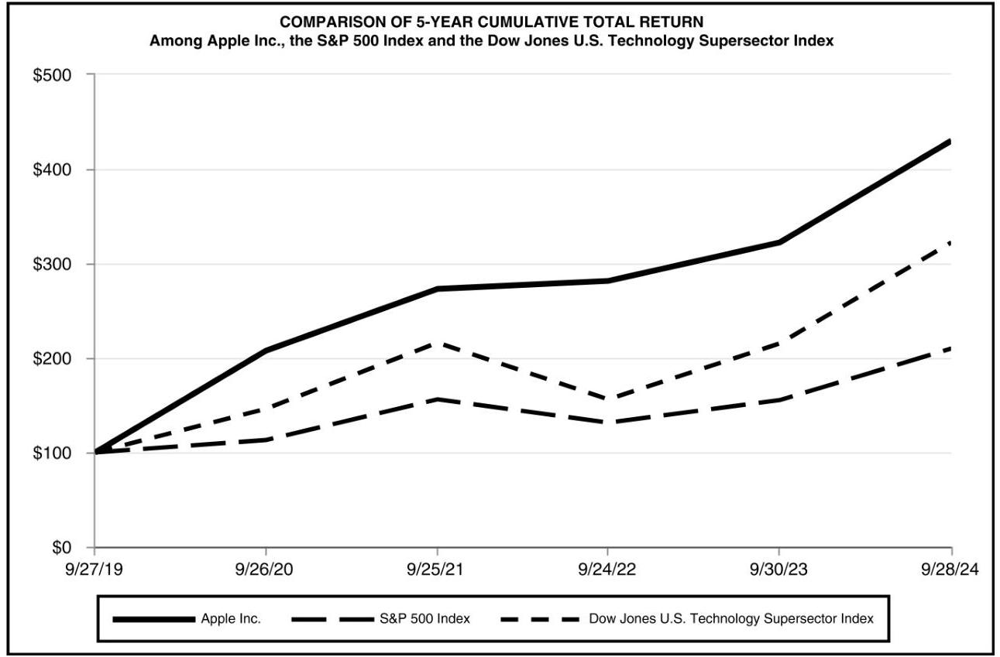

|  | September <br> 2019 | September <br> 2020 | September <br> 2021 | September <br> 2022 | September <br> 2023 | September <br> 2024 |
| :-- | :--: | :--: | :--: | :--: | :--: | :--: |
| Apple Inc. | $\$ 100$ | $\$ 207$ | $\$ 273$ | $\$ 281$ | $\$ 322$ | $\$ 430$ |
| S\&P 500 Index | $\$ 100$ | $\$ 113$ | $\$ 156$ | $\$ 131$ | $\$ 155$ | $\$ 210$ |
| Dow Jones U.S. Technology Supersector Index | $\$ 100$ | $\$ 146$ | $\$ 216$ | $\$ 156$ | $\$ 215$ | $\$ 322$ |

Item 6. [Reserved]

# Item 7. Management's Discussion and Analysis of Financial Condition and Results of Operations 

The following discussion should be read in conjunction with the consolidated financial statements and accompanying notes included in Part II, Item 8 of this Form 10-K. This Item generally discusses 2024 and 2023 items and year-to-year comparisons between 2024 and 2023. Discussions of 2022 items and year-toyear comparisons between 2023 and 2022 are not included, and can be found in "Management's Discussion and Analysis of Financial Condition and Results of Operations" in Part II, Item 7 of the Company's Annual Report on Form 10-K for the fiscal year ended September 30, 2023.

## Product, Service and Software Announcements

The Company announces new product, service and software offerings at various times during the year. Significant announcements during fiscal year 2024 included the following:

First Quarter 2024:

- MacBook Pro 14-in.;
- MacBook Pro 16-in.; and
- iMac.

Second Quarter 2024:

- MacBook Air 13-in.; and
- MacBook Air 15-in.

Third Quarter 2024:

- iPad Air;
- iPad Pro;
- iOS 18, macOS Sequoia, iPadOS 18, watchOS 11, visionOS 2 and tvOS 18, updates to the Company's operating systems; and
- Apple Intelligence ${ }^{\text {TM }}$, a personal intelligence system that uses generative models.

Fourth Quarter 2024:

- iPhone 16, iPhone 16 Plus, iPhone 16 Pro and iPhone 16 Pro Max;
- Apple Watch Series 10; and
- AirPods 4.


## Fiscal Period

The Company's fiscal year is the 52- or 53-week period that ends on the last Saturday of September. An additional week is included in the first fiscal quarter every five or six years to realign the Company's fiscal quarters with calendar quarters, which occurred in the first quarter of 2023. The Company's fiscal years 2024 and 2022 spanned 52 weeks each, whereas fiscal year 2023 spanned 53 weeks.

## Macroeconomic Conditions

Macroeconomic conditions, including inflation, interest rates and currency fluctuations, have directly and indirectly impacted, and could in the future materially impact, the Company's results of operations and financial condition.

# Segment Operating Performance 

The following table shows net sales by reportable segment for 2024, 2023 and 2022 (dollars in millions):

|  | 2024 | Change | 2023 | Change | 2022 |
| :--: | :--: | :--: | :--: | :--: | :--: |
| Americas | \$ 167,045 | $3 \%$ | \$ 162,560 | (4)\% | \$ 169,658 |
| Europe | 101,328 | $7 \%$ | 94,294 | (1)\% | 95,118 |
| Greater China | 66,952 | $(8) \%$ | 72,559 | (2)\% | 74,200 |
| Japan | 25,052 | $3 \%$ | 24,257 | (7)\% | 25,977 |
| Rest of Asia Pacific | 30,658 | $4 \%$ | 29,615 | $1 \%$ | 29,375 |
| Total net sales | \$ 391,035 | $2 \%$ | \$ 383,285 | (3)\% | \$ 394,328 |

## Americas

Americas net sales increased during 2024 compared to 2023 due primarily to higher net sales of Services.

## Europe

Europe net sales increased during 2024 compared to 2023 due primarily to higher net sales of Services and iPhone.

## Greater China

Greater China net sales decreased during 2024 compared to 2023 due primarily to lower net sales of iPhone and iPad. The weakness in the renminbi relative to the U.S. dollar had an unfavorable year-over-year impact on Greater China net sales during 2024.

## Japan

Japan net sales increased during 2024 compared to 2023 due primarily to higher net sales of iPhone. The weakness in the yen relative to the U.S. dollar had an unfavorable year-over-year impact on Japan net sales during 2024.

## Rest of Asia Pacific

Rest of Asia Pacific net sales increased during 2024 compared to 2023 due primarily to higher net sales of Services. The weakness in foreign currencies relative to the U.S. dollar had a net unfavorable year-over-year impact on Rest of Asia Pacific net sales during 2024.

# Products and Services Performance 

The following table shows net sales by category for 2024, 2023 and 2022 (dollars in millions):

|  | 2024 | Change | 2023 | Change | 2022 |
| :--: | :--: | :--: | :--: | :--: | :--: |
| iPhone | \$ 201,183 | - \% | \$ 200,583 | (2)\% | \$ 205,489 |
| Mac | 29,984 | $2 \%$ | 29,357 | (27)\% | 40,177 |
| iPad | 26,694 | (6)\% | 28,300 | (3)\% | 29,292 |
| Wearables, Home and Accessories | 37,005 | (7)\% | 39,845 | (3)\% | 41,241 |
| Services ${ }^{(1)}$ | 96,169 | $13 \%$ | 85,200 | $9 \%$ | 78,129 |
| Total net sales | \$ 391,035 | $2 \%$ | \$ 383,285 | (3)\% | \$ 394,328 |

(1) Services net sales include amortization of the deferred value of services bundled in the sales price of certain products.
iPhone
iPhone net sales were relatively flat during 2024 compared to 2023.

Mac
Mac net sales increased during 2024 compared to 2023 due primarily to higher net sales of laptops.
iPad
iPad net sales decreased during 2024 compared to 2023 due primarily to lower net sales of iPad Pro and the entry-level iPad models, partially offset by higher net sales of iPad Air.

## Wearables, Home and Accessories

Wearables, Home and Accessories net sales decreased during 2024 compared to 2023 due primarily to lower net sales of Wearables and Accessories.

## Services

Services net sales increased during 2024 compared to 2023 due primarily to higher net sales from advertising, the App Store ${ }^{\circledR}$ and cloud services.

# Gross Margin 

Products and Services gross margin and gross margin percentage for 2024, 2023 and 2022 were as follows (dollars in millions):

|  | 2024 | 2023 | 2022 |
| :--: | :--: | :--: | :--: |
| Gross margin: |  |  |  |
| Products | \$ 109,633 | \$ 108,803 | \$ 114,728 |
| Services | 71,050 | 60,345 | 56,054 |
| Total gross margin | \$ 180,683 | \$ 169,148 | \$ 170,782 |

Gross margin percentage:

| Products | $37.2 \%$ | $36.5 \%$ | $36.3 \%$ |
| :-- | --: | --: | --: |
| Services | $73.9 \%$ | $70.8 \%$ | $71.7 \%$ |
| Total gross margin percentage | $46.2 \%$ | $44.1 \%$ | $43.3 \%$ |

## Products Gross Margin

Products gross margin and Products gross margin percentage increased during 2024 compared to 2023 due to cost savings, partially offset by a different Products mix and the weakness in foreign currencies relative to the U.S. dollar.

## Services Gross Margin

Services gross margin increased during 2024 compared to 2023 due primarily to higher Services net sales.
Services gross margin percentage increased during 2024 compared to 2023 due to a different Services mix.

The Company's future gross margins can be impacted by a variety of factors, as discussed in Part I, Item 1A of this Form 10-K under the heading "Risk Factors." As a result, the Company believes, in general, gross margins will be subject to volatility and downward pressure.

## Operating Expenses

Operating expenses for 2024, 2023 and 2022 were as follows (dollars in millions):

|  | 2024 | Change | 2023 | Change | 2022 |
| :--: | :--: | :--: | :--: | :--: | :--: |
| Research and development | \$ 31,370 | $5 \%$ | \$ 29,915 | $14 \%$ | \$ 26,251 |
| Percentage of total net sales | $8 \%$ |  | $8 \%$ |  | $7 \%$ |
| Selling, general and administrative | \$ 26,097 | $5 \%$ | \$ 24,932 | $(1) \%$ | \$ 25,094 |
| Percentage of total net sales | $7 \%$ |  | $7 \%$ |  | $6 \%$ |
| Total operating expenses | \$ 57,467 | $5 \%$ | \$ 54,847 | $7 \%$ | \$ 51,345 |
| Percentage of total net sales | $15 \%$ |  | $14 \%$ |  | $13 \%$ |

## Research and Development

The growth in R\&D expense during 2024 compared to 2023 was driven primarily by increases in headcount-related expenses.

## Selling, General and Administrative

Selling, general and administrative expense increased $\$ 1.2$ billion during 2024 compared to 2023.

# Provision for Income Taxes 

Provision for income taxes, effective tax rate and statutory federal income tax rate for 2024, 2023 and 2022 were as follows (dollars in millions):

|  | 2024 | 2023 |  | 2022 |  |
| :--: | :--: | :--: | :--: | :--: | :--: |
| Provision for income taxes | \$ | 29,749 | \$ | 16,741 | \$ | 19,300 |
| Effective tax rate |  | $24.1 \%$ |  | $14.7 \%$ |  | $16.2 \%$ |
| Statutory federal income tax rate |  | $21 \%$ |  | $21 \%$ |  | $21 \%$ |

The Company's effective tax rate for 2024 was higher than the statutory federal income tax rate due primarily to a one-time income tax charge of $\$ 10.2$ billion, net, related to the State Aid Decision (refer to Note 7, "Income Taxes" in the Notes to Consolidated Financial Statements in Part II, Item 8 of this Form 10-K) and state income taxes, partially offset by a lower effective tax rate on foreign earnings, the impact of the U.S. federal R\&D credit, and tax benefits from share-based compensation.

The Company's effective tax rate for 2024 was higher compared to 2023 due primarily to a one-time income tax charge of $\$ 10.2$ billion, net, related to the State Aid Decision, a higher effective tax rate on foreign earnings and lower tax benefits from share-based compensation.

## Liquidity and Capital Resources

The Company believes its balances of unrestricted cash, cash equivalents and marketable securities, which totaled $\$ 140.8$ billion as of September 28, 2024, along with cash generated by ongoing operations and continued access to debt markets, will be sufficient to satisfy its cash requirements and capital return program over the next 12 months and beyond.

The Company's material cash requirements include the following contractual obligations:

## Debt

As of September 28, 2024, the Company had outstanding fixed-rate notes with varying maturities for an aggregate principal amount of $\$ 97.3$ billion (collectively the "Notes"), with $\$ 10.9$ billion payable within 12 months. Future interest payments associated with the Notes total $\$ 38.5$ billion, with $\$ 2.6$ billion payable within 12 months.

The Company also issues unsecured short-term promissory notes pursuant to a commercial paper program. As of September 28, 2024, the Company had $\$ 10.0$ billion of commercial paper outstanding, all of which was payable within 12 months.

## Leases

The Company has lease arrangements for certain equipment and facilities, including corporate, data center, manufacturing and retail space. As of September 28, 2024, the Company had fixed lease payment obligations of $\$ 15.6$ billion, with $\$ 2.0$ billion payable within 12 months.

## Manufacturing Purchase Obligations

The Company utilizes several outsourcing partners to manufacture subassemblies for the Company's products and to perform final assembly and testing of finished products. The Company also obtains individual components for its products from a wide variety of individual suppliers. As of September 28, 2024, the Company had manufacturing purchase obligations of $\$ 53.0$ billion, with $\$ 52.9$ billion payable within 12 months.

## Other Purchase Obligations

The Company's other purchase obligations primarily consist of noncancelable obligations to acquire capital assets, including assets related to product manufacturing, and noncancelable obligations related to supplier arrangements, licensed intellectual property and content, and distribution rights. As of September 28, 2024, the Company had other purchase obligations of $\$ 12.0$ billion, with $\$ 4.1$ billion payable within 12 months.

## Deemed Repatriation Tax Payable

As of September 28, 2024, the balance of the deemed repatriation tax payable imposed by the U.S. Tax Cuts and Jobs Act of 2017 (the "TCJA") was $\$ 16.5$ billion, with $\$ 7.2$ billion expected to be paid within 12 months.

# State Aid Decision Tax Payable 

As of September 28, 2024, the Company had an obligation to pay $€ 14.2$ billion or $\$ 15.8$ billion to Ireland in connection with the State Aid Decision, all of which was expected to be paid within 12 months. The funds necessary to settle the obligation were held in escrow as of September 28, 2024, and restricted from general use.

## Capital Return Program

In addition to its contractual cash requirements, the Company has an authorized share repurchase program. The program does not obligate the Company to acquire a minimum amount of shares. As of September 28, 2024, the Company's quarterly cash dividend was $\$ 0.25$ per share. The Company intends to increase its dividend on an annual basis, subject to declaration by the Board.

In May 2024, the Company announced a new share repurchase program of up to $\$ 110$ billion and raised its quarterly dividend from $\$ 0.24$ to $\$ 0.25$ per share beginning in May 2024. During 2024, the Company repurchased $\$ 95.0$ billion of its common stock and paid dividends and dividend equivalents of $\$ 15.2$ billion.

## Recent Accounting Pronouncements

## Income Taxes

In December 2023, the Financial Accounting Standards Board (the "FASB") issued Accounting Standards Update ("ASU") No. 2023-09, Income Taxes (Topic 740): Improvements to Income Tax Disclosures ("ASU 2023-09"), which will require the Company to disclose specified additional information in its income tax rate reconciliation and provide additional information for reconciling items that meet a quantitative threshold. ASU 2023-09 will also require the Company to disaggregate its income taxes paid disclosure by federal, state and foreign taxes, with further disaggregation required for significant individual jurisdictions. The Company will adopt ASU 2023-09 in its fourth quarter of 2026 using a prospective transition method.

## Segment Reporting

In November 2023, the FASB issued ASU No. 2023-07, Segment Reporting (Topic 280): Improvements to Reportable Segment Disclosures ("ASU 2023-07"), which will require the Company to disclose segment expenses that are significant and regularly provided to the Company's chief operating decision maker ("CODM"). In addition, ASU 2023-07 will require the Company to disclose the title and position of its CODM and how the CODM uses segment profit or loss information in assessing segment performance and deciding how to allocate resources. The Company will adopt ASU 2023-07 in its fourth quarter of 2025 using a retrospective transition method.

## Critical Accounting Estimates

The preparation of financial statements and related disclosures in conformity with U.S. generally accepted accounting principles ("GAAP") and the Company's discussion and analysis of its financial condition and operating results require the Company's management to make judgments, assumptions and estimates that affect the amounts reported. Note 1, "Summary of Significant Accounting Policies" of the Notes to Consolidated Financial Statements in Part II, Item 8 of this Form 10-K describes the significant accounting policies and methods used in the preparation of the Company's consolidated financial statements. Management bases its estimates on historical experience and on various other assumptions it believes to be reasonable under the circumstances, the results of which form the basis for making judgments about the carrying values of assets and liabilities.

## Uncertain Tax Positions

The Company is subject to income taxes in the U.S. and numerous foreign jurisdictions. The evaluation of the Company's uncertain tax positions involves significant judgment in the interpretation and application of GAAP and complex domestic and international tax laws, including the TCJA and the allocation of international taxation rights between countries. Although management believes the Company's reserves are reasonable, no assurance can be given that the final outcome of these uncertainties will not be different from that reflected in the Company's reserves. Reserves are adjusted considering changing facts and circumstances, such as the closing of a tax examination. Resolution of these uncertainties in a manner inconsistent with management's expectations could have a material impact on the Company's financial condition and operating results.

## Legal and Other Contingencies

The Company is subject to various legal proceedings and claims that arise in the ordinary course of business, the outcomes of which are inherently uncertain. The Company records a liability when it is probable that a loss has been incurred and the amount is reasonably estimable, the determination of which requires significant judgment. Resolution of legal matters in a manner inconsistent with management's expectations could have a material impact on the Company's financial condition and operating results.

# Item 7A. Quantitative and Qualitative Disclosures About Market Risk 

The Company is exposed to economic risk from interest rates and foreign exchange rates. The Company uses various strategies to manage these risks; however, they may still impact the Company's consolidated financial statements.

## Interest Rate Risk

The Company is primarily exposed to fluctuations in U.S. interest rates and their impact on the Company's investment portfolio and term debt. Increases in interest rates will negatively affect the fair value of the Company's investment portfolio and increase the interest expense on the Company's term debt. To protect against interest rate risk, the Company may use derivative instruments, offset interest rate-sensitive assets and liabilities, or control duration of the investment and term debt portfolios.

The following table sets forth potential impacts on the Company's investment portfolio and term debt, including the effects of any associated derivatives, that would result from a hypothetical increase in relevant interest rates as of September 28, 2024 and September 30, 2023 (dollars in millions):

| Interest Rate <br> Sensitive Instrument | Hypothetical Interest <br> Rate Increase | Potential Impact | 2024 |  | 2023 |  |
| :-- | :-- | :-- | :-- | :-- | :-- | :-- |
| Investment portfolio | 100 basis points, all tenors | Decline in fair value | $\$ 2,755$ | $\$ 3,089$ |  |  |
| Term debt | 100 basis points, all tenors | Increase in annual interest expense | $\$$ | 139 | $\$$ | 194 |

## Foreign Exchange Rate Risk

The Company's exposure to foreign exchange rate risk relates primarily to the Company being a net receiver of currencies other than the U.S. dollar. Changes in exchange rates, and in particular a strengthening of the U.S. dollar, will negatively affect the Company's net sales and gross margins as expressed in U.S. dollars. Fluctuations in exchange rates may also affect the fair values of certain of the Company's assets and liabilities. To protect against foreign exchange rate risk, the Company may use derivative instruments, offset exposures, or adjust local currency pricing of its products and services. However, the Company may choose to not hedge certain foreign currency exposures for a variety of reasons, including accounting considerations or prohibitive cost.

The Company applied a value-at-risk ("VAR") model to its foreign currency derivative positions to assess the potential impact of fluctuations in exchange rates. The VAR model used a Monte Carlo simulation. The VAR is the maximum expected loss in fair value, for a given confidence interval, to the Company's foreign currency derivative positions due to adverse movements in rates. Based on the results of the model, the Company estimates, with $95 \%$ confidence, a maximum one-day loss in fair value of $\$ 538$ million and $\$ 669$ million as of September 28, 2024 and September 30, 2023, respectively. Changes in the Company's underlying foreign currency exposures, which were excluded from the assessment, generally offset changes in the fair values of the Company's foreign currency derivatives.

| Index to Consolidated Financial Statements | Page |
| --- | --- |
| Consolidated Statements of Operations for the years ended September 28, 2024, September 30, 2023 and September 24, 2022 | 29 |
| Consolidated Statements of Comprehensive Income for the years ended September 28, 2024, September 30, 2023 and September 24, 2022 | 30 |
| Consolidated Balance Sheets as of September 28, 2024 and September 30, 2023 | 31 |
| Consolidated Statements of Shareholders' Equity for the years ended September 28, 2024, September 30, 2023 and September 24, 2022 | 32 |
| Consolidated Statements of Cash Flows for the years ended September 28, 2024, September 30, 2023 and September 24, 2022 | 33 |
| Notes to Consolidated Financial Statements | 34 |
| Reports of Independent Registered Public Accounting Firm | 48 |

All financial statement schedules have been omitted, since the required information is not applicable or is not present in amounts sufficient to require submission of the schedule, or because the information required is included in the consolidated financial statements and accompanying notes.

Apple Inc.
CONSOLIDATED STATEMENTS OF OPERATIONS
(In millions, except number of shares, which are reflected in thousands, and per-share amounts)

|  | Years ended |
| --- | --- |
|  | September 28, 2024 | September 30, 2023 | September 24, 2022 |
| Net sales: |  |  |  |
| Products | $294,866 | $298,085 | $316,199 |
| Services | 96,169 | 85,200 | 78,129 |
| Total net sales | 391,035 | 383,285 | 394,328 |
| Cost of sales: |  |  |  |
| Products | 185,233 | 189,282 | 201,471 |
| Services | 25,119 | 24,855 | 22,075 |
| Total cost of sales | 210,352 | 214,137 | 223,546 |
| Gross margin | 180,683 | 169,148 | 170,782 |
| Operating expenses: |  |  |  |
| Research and development | 31,370 | 29,915 | 26,251 |
| Selling, general and administrative | 26,097 | 24,932 | 25,094 |
| Total operating expenses | 57,467 | 54,847 | 51,345 |
| Operating income | 123,216 | 114,301 | 119,437 |
| Other income/(expense), net | 269 | (565) | (334) |
| Income before provision for income taxes | 123,485 | 113,736 | 119,103 |
| Provision for income taxes | 29,749 | 16,741 | 19,300 |
| Net income | $93,736 | $96,995 | $99,803 |
| Earnings per share: |  |  |  |
| Basic | $6.11 | $6.16 | $6.15 |
| Diluted | $6.08 | $6.13 | $6.11 |
| Shares used in computing earnings per share: |  |  |  |
| Basic | 15,343,783 | 15,744,231 | 16,215,963 |
| Diluted | 15,408,095 | 15,812,547 | 16,325,819 |

See accompanying Notes to Consolidated Financial Statements.

|   | Years ended  |   |   |
| --- | --- | --- | --- |
|   | September 28, 2024 | September 30, 2023 | September 24, 2022  |
|  Net income | $93,736 | $96,995 | $99,803  |
|  Other comprehensive income/(loss): |  |  |   |
|  Change in foreign currency translation, net of tax | 395 | (765) | (1,511)  |
|  Change in unrealized gains/losses on derivative instruments, net of tax: |  |  |   |
|  Change in fair value of derivative instruments | (832) | 323 | 3,212  |
|  Adjustment for net (gains)/losses realized and included in net income | (1,337) | (1,717) | (1,074)  |
|  Total change in unrealized gains/losses on derivative instruments | (2,169) | (1,394) | 2,138  |
|  Change in unrealized gains/losses on marketable debt securities, net of tax: |  |  |   |
|  Change in fair value of marketable debt securities | 5,850 | 1,563 | (12,104)  |
|  Adjustment for net (gains)/losses realized and included in net income | 204 | 253 | 205  |
|  Total change in unrealized gains/losses on marketable debt securities | 6,054 | 1,816 | (11,899)  |
|  Total other comprehensive income/(loss) | 4,280 | (343) | (11,272)  |
|  Total comprehensive income | $98,016 | $96,652 | $88,531  |

|  Apple Inc. |  |   |
| --- | --- | --- |
|  CONSOLIDATED BALANCE SHEETS |   |   |
|  (In millions, except number of shares, which are reflected in thousands, and par value) |   |   |
|   | September 28, 2024 | September 30, 2023  |
|  ASSETS: |  |   |
|  Current assets: |  |   |
|  Cash and cash equivalents | $29,943 | $29,965  |
|  Marketable securities | 35,228 | 31,590  |
|  Accounts receivable, net | 33,410 | 29,508  |
|  Vendor non-trade receivables | 32,833 | 31,477  |
|  Inventories | 7,286 | 6,331  |
|  Other current assets | 14,287 | 14,695  |
|  Total current assets | 152,987 | 143,566  |
|  Non-current assets: |  |   |
|  Marketable securities | 91,479 | 100,544  |
|  Property, plant and equipment, net | 45,680 | 43,715  |
|  Other non-current assets | 74,834 | 64,758  |
|  Total non-current assets | 211,993 | 209,017  |
|  Total assets | $364,980 | $352,583  |
|  LIABILITIES AND SHAREHOLDERS’ EQUITY: |  |   |
|  Current liabilities: |  |   |
|  Accounts payable | $68,960 | $62,611  |
|  Other current liabilities | 78,304 | 58,829  |
|  Deferred revenue | 8,249 | 8,061  |
|  Commercial paper | 9,967 | 5,985  |
|  Term debt | 10,912 | 9,822  |
|  Total current liabilities | 176,392 | 145,308  |
|  Non-current liabilities: |  |   |
|  Term debt | 85,750 | 95,281  |
|  Other non-current liabilities | 45,888 | 49,848  |
|  Total non-current liabilities | 131,638 | 145,129  |
|  Total liabilities | 308,030 | 290,437  |
|  Commitments and contingencies |  |   |
|  Shareholders’ equity: |  |   |
|  Common stock and additional paid-in capital, $0.00001 par value: 50,400,000 shares authorized; 15,116,786 and 15,550,061 shares issued and outstanding, respectively | 83,276 | 73,812  |
|  Accumulated deficit | (19,154) | (214)  |
|  Accumulated other comprehensive loss | (7,172) | (11,452)  |
|  Total shareholders’ equity | 56,950 | 62,146  |
|  Total liabilities and shareholders’ equity | $364,980 | $352,583  |
|  See accompanying Notes to Consolidated Financial Statements. |   |   |

|   | Years ended  |   |   |
| --- | --- | --- | --- |
|   | September 28, 2024 | September 30, 2023 | September 24, 2022  |
|  Total shareholders’ equity, beginning balances | $62,146 | $50,672 | $63,090  |
|  Common stock and additional paid-in capital: |  |  |   |
|  Beginning balances | 73,812 | 64,849 | 57,365  |
|  Common stock issued | 1,423 | 1,346 | 1,175  |
|  Common stock withheld related to net share settlement of equity awards | (3,993) | (3,521) | (2,971)  |
|  Share-based compensation | 12,034 | 11,138 | 9,280  |
|  Ending balances | 83,276 | 73,812 | 64,849  |
|  Retained earnings/(Accumulated deficit): |  |  |   |
|  Beginning balances | (214) | (3,068) | 5,562  |
|  Net income | 93,736 | 96,995 | 99,803  |
|  Dividends and dividend equivalents declared | (15,218) | (14,996) | (14,793)  |
|  Common stock withheld related to net share settlement of equity awards | (1,612) | (2,099) | (3,454)  |
|  Common stock repurchased | (95,846) | (77,046) | (90,186)  |
|  Ending balances | (19,154) | (214) | (3,068)  |
|  Accumulated other comprehensive income/(loss): |  |  |   |
|  Beginning balances | (11,452) | (11,109) | 163  |
|  Other comprehensive income/(loss) | 4,280 | (343) | (11,272)  |
|  Ending balances | (7,172) | (11,452) | (11,109)  |
|  Total shareholders’ equity, ending balances | $56,950 | $62,146 | $50,672  |
|  Dividends and dividend equivalents declared per share or RSU | $0.98 | $0.94 | $0.90  |
|  See accompanying Notes to Consolidated Financial Statements. |   |   |   |

|   |  | Years ended |   |   |
| --- | --- | --- | --- | --- |
|   | September 28, 2024 | September 30, 2023 | September 24, 2022 |   |
|  Cash, cash equivalents, and restricted cash and cash equivalents, beginning balances | $30,737 | $24,977 | $35,929 |   |
|  Operating activities: |  |  |  |   |
|  Net income | 93,736 | 96,995 | 99,803 |   |
|  Adjustments to reconcile net income to cash generated by operating activities: |  |  |  |   |
|  Depreciation and amortization | 11,445 | 11,519 | 11,104 |   |
|  Share-based compensation expense | 11,688 | 10,833 | 9,038 |   |
|  Other | (2,266) | (2,227) | 1,006 |   |
|  Changes in operating assets and liabilities: |  |  |  |   |
|  Accounts receivable, net | (3,788) | (1,688) | (1,823) |   |
|  Vendor non-trade receivables | (1,356) | 1,271 | (7,520) |   |
|  Inventories | (1,046) | (1,618) | 1,484 |   |
|  Other current and non-current assets | (11,731) | (5,684) | (6,499) |   |
|  Accounts payable | 6,020 | (1,889) | 9,448 |   |
|  Other current and non-current liabilities | 15,552 | 3,031 | 6,110 |   |
|  Cash generated by operating activities | 118,254 | 110,543 | 122,151 |   |
|  Investing activities: |  |  |  |   |
|  Purchases of marketable securities | (48,656) | (29,513) | (76,923) |   |
|  Proceeds from maturities of marketable securities | 51,211 | 39,686 | 29,917 |   |
|  Proceeds from sales of marketable securities | 11,135 | 5,828 | 37,446 |   |
|  Payments for acquisition of property, plant and equipment | (9,447) | (10,959) | (10,708) |   |
|  Other | (1,308) | (1,337) | (2,086) |   |
|  Cash generated by/(used in) investing activities | 2,935 | 3,705 | (22,354) |   |
|  Financing activities: |  |  |  |   |
|  Payments for taxes related to net share settlement of equity awards | (5,441) | (5,431) | (6,223) |   |
|  Payments for dividends and dividend equivalents | (15,234) | (15,025) | (14,841) |   |
|  Repurchases of common stock | (94,949) | (77,550) | (89,402) |   |
|  Proceeds from issuance of term debt, net | — | 5,228 | 5,465 |   |
|  Repayments of term debt | (9,958) | (11,151) | (9,543) |   |
|  Proceeds from/(Repayments of) commercial paper, net | 3,960 | (3,978) | 3,955 |   |
|  Other | (361) | (581) | (160) |   |
|  Cash used in financing activities | (121,983) | (108,488) | (110,749) |   |
|  Increase/(Decrease) in cash, cash equivalents, and restricted cash and cash equivalents | (794) | 5,760 | (10,952) |   |
|  Cash, cash equivalents, and restricted cash and cash equivalents, ending balances | $29,943 | $30,737 | $24,977 |   |
|  Supplemental cash flow disclosure: |  |  |  |   |
|  Cash paid for income taxes, net | $26,102 | $18,679 | $19,573 |   |
|  See accompanying Notes to Consolidated Financial Statements. |   |  |  |   |

# Note 1 - Summary of Significant Accounting Policies 

## Basis of Presentation and Preparation

The consolidated financial statements include the accounts of Apple Inc. and its wholly owned subsidiaries. The preparation of these consolidated financial statements and accompanying notes in conformity with GAAP requires the use of management estimates. Certain prior period amounts in the consolidated financial statements and accompanying notes have been reclassified to conform to the current period's presentation.

The Company's fiscal year is the 52- or 53-week period that ends on the last Saturday of September. An additional week is included in the first fiscal quarter every five or six years to realign the Company's fiscal quarters with calendar quarters, which occurred in the first fiscal quarter of 2023. The Company's fiscal years 2024 and 2022 spanned 52 weeks each, whereas fiscal year 2023 spanned 53 weeks. Unless otherwise stated, references to particular years, quarters, months and periods refer to the Company's fiscal years ended in September and the associated quarters, months and periods of those fiscal years.

## Revenue

The Company records revenue net of taxes collected from customers that are remitted to governmental authorities.

## Share-Based Compensation

The Company recognizes share-based compensation expense on a straight-line basis for its estimate of equity awards that will ultimately vest.

## Cash Equivalents

All highly liquid investments with maturities of three months or less at the date of purchase are treated as cash equivalents.

## Marketable Securities

The cost of securities sold is determined using the specific identification method.

## Inventories

Inventories are measured using the first-in, first-out method.

## Property, Plant and Equipment

Depreciation on property, plant and equipment is recognized on a straight-line basis.

## Derivative Instruments

The Company presents derivative assets and liabilities at their gross fair values in the Consolidated Balance Sheets.

## Income Taxes

The Company records certain deferred tax assets and liabilities in connection with the minimum tax on certain foreign earnings created by the TCJA.

## Leases

The Company combines and accounts for lease and nonlease components as a single lease component for leases of corporate, data center and retail facilities.

# Note 2 - Revenue 

The Company recognizes revenue at the amount to which it expects to be entitled when control of the products or services is transferred to its customers. Control is generally transferred when the Company has a present right to payment and title and the significant risks and rewards of ownership of products or services are transferred to its customers. For most of the Company's Products net sales, control transfers when products are shipped. For the Company's Services net sales, control transfers over time as services are delivered. Payment for Products and Services net sales is collected within a short period following transfer of control or commencement of delivery of services, as applicable.

The Company records reductions to Products net sales related to future product returns, price protection and other customer incentive programs based on the Company's expectations and historical experience.

For arrangements with multiple performance obligations, which represent promises within an arrangement that are distinct, the Company allocates revenue to all distinct performance obligations based on their relative stand-alone selling prices ("SSPs"). When available, the Company uses observable prices to determine SSPs. When observable prices are not available, SSPs are established that reflect the Company's best estimates of what the selling prices of the performance obligations would be if they were sold regularly on a stand-alone basis. The Company's process for estimating SSPs without observable prices considers multiple factors that may vary depending upon the unique facts and circumstances related to each performance obligation including, where applicable, prices charged by the Company for similar offerings, market trends in the pricing for similar offerings, product-specific business objectives and the estimated cost to provide the performance obligation.

The Company has identified the performance obligations regularly included in arrangements involving the sale of iPhone, Mac and iPad. The first material performance obligation, which represents the substantial portion of the allocated sales price, is the hardware and bundled software delivered at the time of sale. The second material performance obligation is the right to receive certain product-related bundled services, which include iCloud ${ }^{\circledR}$, $\operatorname{Sin}^{\circledR}$ and Maps. The Company allocates revenue and any related discounts to all of its performance obligations based on their relative SSPs. Because the Company lacks observable prices for product-related bundled services, the allocation of revenue is based on the Company's estimated SSPs. Revenue allocated to the delivered hardware and bundled software is recognized when control has transferred to the customer, which generally occurs when the product is shipped. Revenue allocated to product-related bundled services is deferred and recognized on a straight-line basis over the estimated period they are expected to be provided.

For certain long-term service arrangements, the Company has performance obligations for services it has not yet delivered. For these arrangements, the Company does not have a right to bill for the undelivered services. The Company has determined that any unbilled consideration relates entirely to the value of the undelivered services. Accordingly, the Company has not recognized revenue, and does not disclose amounts, related to these undelivered services.

For the sale of third-party products where the Company obtains control of the product before transferring it to the customer, the Company recognizes revenue based on the gross amount billed to customers. The Company considers multiple factors when determining whether it obtains control of third-party products, including evaluating if it can establish the price of the product, retains inventory risk for tangible products or has the responsibility for ensuring acceptability of the product. For third-party applications sold through the App Store, the Company does not obtain control of the product before transferring it to the customer. Therefore, the Company accounts for all third-party application-related sales on a net basis by recognizing in Services net sales only the commission it retains.

Net sales disaggregated by significant products and services for 2024, 2023 and 2022 were as follows (in millions):

|  | 2024 | 2023 | 2022 |
| :--: | :--: | :--: | :--: |
| iPhone | \$ 201,183 | \$ 200,583 | \$ 205,489 |
| Mac | 29,984 | 29,357 | 40,177 |
| iPad | 26,694 | 28,300 | 29,292 |
| Wearables, Home and Accessories | 37,005 | 39,845 | 41,241 |
| Services ${ }^{(1)}$ | 96,169 | 85,200 | 78,129 |
| Total net sales | \$ 391,035 | \$ 383,285 | \$ 394,328 |

(1) Services net sales include amortization of the deferred value of services bundled in the sales price of certain products.

Total net sales include $\$ 7.7$ billion of revenue recognized in 2024 that was included in deferred revenue as of September 30, 2023, $\$ 8.2$ billion of revenue recognized in 2023 that was included in deferred revenue as of September 24, 2022, and $\$ 7.5$ billion of revenue recognized in 2022 that was included in deferred revenue as of September 25, 2021.

The Company's proportion of net sales by disaggregated revenue source was generally consistent for each reportable segment in Note 13, "Segment Information and Geographic Data" for 2024, 2023 and 2022, except in Greater China, where iPhone revenue represented a moderately higher proportion of net sales.

As of September 28, 2024 and September 30, 2023, the Company had total deferred revenue of $\$ 12.8$ billion and $\$ 12.1$ billion, respectively. As of September 28, 2024, the Company expects $64 \%$ of total deferred revenue to be realized in less than a year, $25 \%$ within one-to-two years, $9 \%$ within two-to-three years and $2 \%$ in greater than three years.

# Note 3 - Earnings Per Share 

The following table shows the computation of basic and diluted earnings per share for 2024, 2023 and 2022 (net income in millions and shares in thousands):

|  | 2024 | 2023 | 2022 |
| :--: | :--: | :--: | :--: |
| Numerator: |  |  |  |
| Net income | \$ 93,736 | \$ 96,995 | \$ 99,803 |
| Denominator: |  |  |  |
| Weighted-average basic shares outstanding | $15,343,783$ | $15,744,231$ | $16,215,963$ |
| Effect of dilutive share-based awards | 64,312 | 68,316 | 109,856 |
| Weighted-average diluted shares | $15,408,095$ | $15,812,547$ | $16,325,819$ |
| Basic earnings per share | \$ 6.11 | \$ 6.16 | \$ 6.15 |
| Diluted earnings per share | \$ 6.08 | \$ 6.13 | \$ 6.11 |

Approximately 24 million restricted stock units ("RSUs") were excluded from the computation of diluted earnings per share for 2023 because their effect would have been antidilutive.

## Note 4 - Financial Instruments

## Cash, Cash Equivalents and Marketable Securities

The following tables show the Company's cash, cash equivalents and marketable securities by significant investment category as of September 28, 2024 and September 30, 2023 (in millions):

|  | 2024 |  |  |  |  |  |  |
| :--: | :--: | :--: | :--: | :--: | :--: | :--: | :--: |
|  | Adjusted Cost | Unrealized Gains | Unrealized Losses | Fair Value | Cash and <br> Equivalents | Current <br> Marketable <br> Securities | Non-Current <br> Marketable <br> Securities |
| Cash | \$ 27,199 | \$ — | \$ — | \$ 27,199 | \$ 27,199 | \$ — | \$ — |
| Level 1: |  |  |  |  |  |  |  |
| Money market funds | 778 | - | - | 778 | 778 | - | - |
| Mutual funds | 515 | 105 | (3) | 617 | - | 617 | - |
| Subtotal | 1,293 | 105 | (3) | 1,395 | 778 | 617 | - |
| Level $2{ }^{(1)}$ : |  |  |  |  |  |  |  |
| U.S. Treasury securities | 16,150 | 45 | (516) | 15,679 | 212 | 4,087 | 11,380 |
| U.S. agency securities | 5,431 | - | (272) | 5,159 | 155 | 703 | 4,301 |
| Non-U.S. government securities | 17,959 | 93 | (484) | 17,568 | 1,158 | 10,810 | 5,600 |
| Certificates of deposit and time deposits | 873 | - | - | 873 | 387 | 478 | 8 |
| Commercial paper | 1,066 | - | - | 1,066 | 28 | 1,038 | - |
| Corporate debt securities | 65,622 | 270 | (1,953) | 63,939 | 26 | 16,027 | 47,886 |
| Municipal securities | 412 | - | (7) | 405 | - | 190 | 215 |
| Mortgage- and asset-backed securities | 24,595 | 175 | (1,403) | 23,367 | - | 1,278 | 22,089 |
| Subtotal | 132,108 | 583 | (4,635) | 128,056 | 1,966 | 34,611 | 91,479 |
| Total ${ }^{(2)(3)}$ | \$ 160,600 | \$ 688 | \$ (4,638) | \$ 156,650 | \$ 29,943 | \$ 35,228 | \$ 91,479 |

|   | 2023  |   |   |   |   |   |   |   |
| --- | --- | --- | --- | --- | --- | --- | --- | --- |
|   | Adjusted Cost | Unrealized Gains |   | Unrealized Losses | Fair Value | Cash and Cash Equivalents | Current Marketable Securities | Non-Current Marketable Securities  |
|  Cash | $28,359 | $— |  | $— | $28,359 | $28,359 | $— | $—  |
|  Level 1: |  |  |  |  |  |  |  |   |
|  Money market funds | 481 | — |  | — | 481 | 481 | — | —  |
|  Mutual funds and equity securities | 442 | 12 |  | (26) | 428 | — | 428 | —  |
|  Subtotal | 923 | 12 |  | (26) | 909 | 481 | 428 | —  |
|  Level 2 ^{ (1) } : |  |  |  |  |  |  |  |   |
|  U.S. Treasury securities | 19,406 | — |  | (1,292) | 18,114 | 35 | 5,468 | 12,611  |
|  U.S. agency securities | 5,736 | — |  | (600) | 5,136 | 36 | 271 | 4,829  |
|  Non-U.S. government securities | 17,533 | 6 |  | (1,048) | 16,491 | — | 11,332 | 5,159  |
|  Certificates of deposit and time deposits | 1,354 | — |  | — | 1,354 | 1,034 | 320 | —  |
|  Commercial paper | 608 | — |  | — | 608 | — | 608 | —  |
|  Corporate debt securities | 76,840 | 6 |  | (5,956) | 70,890 | 20 | 12,627 | 58,243  |
|  Municipal securities | 628 | — |  | (26) | 602 | — | 192 | 410  |
|  Mortgage- and asset-backed securities | 22,365 | 6 |  | (2,735) | 19,636 | — | 344 | 19,292  |
|  Subtotal | 144,470 | 18 |  | (11,657) | 132,831 | 1,125 | 31,162 | 100,544  |
|  Total ^{ (3) } | $173,752 | $30 |  | $(11,683) | $162,099 | $29,965 | $31,590 | $100,544  |
|  (1) | The valuation techniques used to measure the fair values of the Company’s Level 2 financial instruments, which generally have counterparties with high credit ratings, are based on quoted market prices or model-driven valuations using significant inputs derived from or corroborated by observable market data.  |   |   |   |   |   |   |   |
|  (2) | As of September 28, 2024, cash and cash equivalents included $2.6 billion held in escrow and restricted from general use. These restricted cash and cash equivalents were designated to settle the Company’s obligation related to the State Aid Decision (refer to Note 7, “Income Taxes”).  |   |   |   |   |   |   |   |
|  (3) | As of September 28, 2024 and September 30, 2023, total marketable securities included $13.2 billion and $13.8 billion, respectively, held in escrow and restricted from general use. The September 28, 2024 restricted marketable securities were designated to settle the Company’s obligation related to the State Aid Decision (refer to Note 7, “Income Taxes”).  |   |   |   |   |   |   |   |
|  As of September 28, 2024, 86% of the Company’s non-current marketable debt securities other than mortgage- and asset-backed securities had maturities between 1 and 5 years, 10% between 5 and 10 years, and 4% greater than 10 years. As of September 28, 2024, 14% of the Company’s non-current mortgageand asset-backed securities had maturities between 1 and 5 years, 9% between 5 and 10 years, and 77% greater than 10 years.  |   |   |   |   |   |   |   |   |
|  The Company’s investments in marketable debt securities have been classified and accounted for as available-for-sale. The Company classifies marketable debt securities as either current or non-current based on each instrument’s underlying maturity. | |   |   |   |   |   |   |   |   |
|  Derivative Instruments and Hedging | |   |   |   |   |   |   |   |   |
|  The Company may use derivative instruments to partially offset its business exposure to foreign exchange and interest rate risk. However, the Company may choose not to hedge certain exposures for a variety of reasons including accounting considerations or the prohibitive economic cost of hedging particular exposures. There can be no assurance the hedges will offset more than a portion of the financial impact resulting from movements in foreign exchange or interest rates.  |   |   |   |   |   |   |   |   |
|  The Company classifies cash flows related to derivative instruments in the same section of the Consolidated Statements of Cash Flows as the items being hedged, which are generally classified as operating activities. | |   |   |   |   |   |   |   |   |
|  Foreign Exchange Rate Risk | |   |   |   |   |   |   |   |   |
|  To protect gross margins from fluctuations in foreign exchange rates, the Company may use forwards, options or other instruments, and may designate these instruments as cash flow hedges. The Company generally hedges portions of its forecasted foreign currency exposure associated with revenue and inventory purchases, typically for up to 12 months. | |   |   |   |   |   |   |   |   |

To protect the Company's foreign currency-denominated term debt or marketable securities from fluctuations in foreign exchange rates, the Company may use forwards, cross-currency swaps or other instruments. The Company designates these instruments as either cash flow or fair value hedges. As of September 28, 2024, the maximum length of time over which the Company is hedging its exposure to the variability in future cash flows for term debt-related foreign currency transactions is 18 years.

The Company may also use derivative instruments that are not designated as accounting hedges to protect gross margins from certain fluctuations in foreign exchange rates, as well as to offset a portion of the foreign currency gains and losses generated by the remeasurement of certain assets and liabilities denominated in non-functional currencies.

# Interest Rate Risk 

To protect the Company's term debt or marketable securities from fluctuations in interest rates, the Company may use interest rate swaps, options or other instruments. The Company designates these instruments as either cash flow or fair value hedges.

The notional amounts of the Company's outstanding derivative instruments as of September 28, 2024 and September 30, 2023 were as follows (in millions):

|  | 2024 | 2023 |
| :--: | :--: | :--: |
| Derivative instruments designated as accounting hedges: |  |  |
| Foreign exchange contracts | \$ | 64,069 |
| Interest rate contracts | \$ | 14,575 |

Derivative instruments not designated as accounting hedges:
Foreign exchange contracts $\$$ 91,493 \$ 104,777

The carrying amounts of the Company's hedged items in fair value hedges as of September 28, 2024 and September 30, 2023 were as follows (in millions):

|  | 2024 | 2023 |
| :--: | :--: | :--: |
| Hedged assets/(liabilities): |  |  |
| Current and non-current marketable securities | \$ | 14,433 |
| Current and non-current term debt | \$ $(13,505)$ | $(18,247)$ |

## Accounts Receivable

## Trade Receivables

The Company's third-party cellular network carriers accounted for $38 \%$ and $41 \%$ of total trade receivables as of September 28, 2024 and September 30, 2023, respectively. The Company requires third-party credit support or collateral from certain customers to limit credit risk.

## Vendor Non-Trade Receivables

The Company has non-trade receivables from certain of its manufacturing vendors resulting from the sale of components to these vendors who manufacture subassemblies or assemble final products for the Company. The Company purchases these components directly from suppliers. The Company does not reflect the sale of these components in products net sales. Rather, the Company recognizes any gain on these sales as a reduction of products cost of sales when the related final products are sold by the Company. As of September 28, 2024, the Company had two vendors that individually represented $10 \%$ or more of total vendor non-trade receivables, which accounted for $44 \%$ and $23 \%$. As of September 30, 2023, the Company had two vendors that individually represented $10 \%$ or more of total vendor non-trade receivables, which accounted for $48 \%$ and $23 \%$.

# Note 5 - Property, Plant and Equipment 

The following table shows the Company's gross property, plant and equipment by major asset class and accumulated depreciation as of September 28, 2024 and September 30, 2023 (in millions):

|  | 2024 | 2023 |
| :--: | :--: | :--: |
| Land and buildings | \$ | 24,690 | \$ 23,446 |
| Machinery, equipment and internal-use software |  | 80,205 | 78,314 |
| Leasehold improvements |  | 14,233 | 12,839 |
| Gross property, plant and equipment |  | 119,128 | 114,599 |
| Accumulated depreciation |  | $(73,448)$ | $(70,884)$ |
| Total property, plant and equipment, net | \$ | 45,680 | \$ 43,715 |

Depreciation expense on property, plant and equipment was $\$ 8.2$ billion, $\$ 8.5$ billion and $\$ 8.7$ billion during 2024, 2023 and 2022, respectively.

## Note 6 - Consolidated Financial Statement Details

The following tables show the Company's consolidated financial statement details as of September 28, 2024 and September 30, 2023 (in millions):

## Other Non-Current Assets

|  | 2024 | 2023 |
| :--: | :--: | :--: |
| Deferred tax assets | \$ | 19,499 | \$ 17,852 |
| Other non-current assets |  | 55,335 | 46,906 |
| Total other non-current assets | \$ | 74,834 | \$ 64,758 |

## Other Current Liabilities

|  | 2024 | 2023 |
| :--: | :--: | :--: |
| Income taxes payable | \$ | 26,601 | \$ 8,819 |
| Other current liabilities |  | 51,703 | 50,010 |
| Total other current liabilities | \$ | 78,304 | \$ 58,829 |

## Other Non-Current Liabilities

|  | 2024 | 2023 |
| :--: | :--: | :--: |
| Income taxes payable | \$ | 9,254 | \$ 15,457 |
| Other non-current liabilities |  | 36,634 | 34,391 |
| Total other non-current liabilities | \$ | 45,888 | \$ 49,848 |

## Note 7 - Income Taxes

## European Commission State Aid Decision

On August 30, 2016, the Commission announced its decision that Ireland granted state aid to the Company by providing tax opinions in 1991 and 2007 concerning the tax allocation of profits of the Irish branches of two subsidiaries of the Company (the "State Aid Decision"). The State Aid Decision ordered Ireland to calculate and recover additional taxes from the Company for the period June 2003 through December 2014. Irish legislative changes, effective as of January 2015, eliminated the application of the tax opinions from that date forward. The recovery amount was calculated to be $€ 13.1$ billion, plus interest of $€ 1.2$ billion.

From time to time, the Company requested approval from the Irish Minister for Finance to reduce the recovery amount for certain taxes paid to other countries. As of September 28, 2024, the adjusted recovery amount of $€ 12.7$ billion plus interest of $€ 1.2$ billion was held in escrow and restricted from general use. The total balance of the escrow, including net unrealized investment gains, was $€ 14.2$ billion or $\$ 15.8$ billion as of September 28, 2024, of which $\$ 2.6$ billion was classified as cash and cash equivalents and $\$ 13.2$ billion was classified as current marketable securities in the Consolidated Balance Sheet. Refer to the Cash, Cash Equivalents and Marketable Securities section of Note 4, "Financial Instruments" for more information.

The Company and Ireland appealed the State Aid Decision to the General Court of the Court of Justice of the European Union (the "General Court"). On July 15, 2020, the General Court annulled the State Aid Decision. On September 25, 2020, the Commission appealed the General Court's decision to the European Court of Justice (the "ECJ") and a hearing was held on May 23, 2023. On September 10, 2024, the ECJ announced that it had set aside the 2020 judgment of the General Court and confirmed the Commission's 2016 State Aid Decision. As a result, during the fourth quarter of 2024 the Company recorded a one-time income tax charge of $\$ 10.2$ billion, net, which represents $\$ 15.8$ billion payable to Ireland via release of the escrow, partially offset by a U.S. foreign tax credit of $\$ 4.8$ billion and a decrease in unrecognized tax benefits of $\$ 823$ million.

# Provision for Income Taxes and Effective Tax Rate 

The provision for income taxes for 2024, 2023 and 2022, consisted of the following (in millions):

|  | 2024 | 2023 | 2022 |
| :--: | :--: | :--: | :--: |
| Federal: |  |  |  |
| Current | \$ | 5,571 | \$ 9,445 |
| Deferred |  | $(3,080)$ | $(3,644)$ |
| Total |  | 2,491 | 5,801 |
| State: |  |  |  |
| Current |  | 1,726 | 1,570 |
| Deferred |  | (298) | (49) |
| Total |  | 1,428 | 1,521 |
| Foreign: |  |  |  |
| Current |  | 25,483 | 8,750 |
| Deferred |  | 347 | 669 |
| Total |  | 25,830 | 9,419 |
| Provision for income taxes |  | \$ | 29,749 |
|  |  | \$ | 16,741 |

Foreign pretax earnings were $\$ 77.3$ billion, $\$ 72.9$ billion and $\$ 71.3$ billion in 2024, 2023 and 2022, respectively.
A reconciliation of the provision for income taxes to the amount computed by applying the statutory federal income tax rate ( $21 \%$ in 2024, 2023 and 2022) to income before provision for income taxes for 2024, 2023 and 2022, is as follows (dollars in millions):

|  | 2024 |  | 2023 |  | 2022 |
| :--: | :--: | :--: | :--: | :--: | :--: |
| Computed expected tax | \$ | 25,932 | \$ | 23,885 | \$ |
| State taxes, net of federal effect |  | 1,162 |  | 1,124 |  |
| Impact of the State Aid Decision |  | 10,246 |  | - | - |
| Earnings of foreign subsidiaries |  | $(5,311)$ |  | $(5,744)$ | $(4,366)$ |
| Research and development credit, net |  | $(1,397)$ |  | $(1,212)$ | $(1,153)$ |
| Excess tax benefits from equity awards |  | $(893)$ |  | $(1,120)$ | $(1,871)$ |
| Other |  | 10 |  | (192) | 160 |
| Provision for income taxes | \$ | 29,749 | \$ | 16,741 | \$ |
| Effective tax rate |  | $24.1 \%$ |  | $14.7 \%$ | $16.2 \%$ |

# Deferred Tax Assets and Liabilities 

As of September 28, 2024 and September 30, 2023, the significant components of the Company's deferred tax assets and liabilities were (in millions):

|  | 2024 | 2023 |
| :--: | :--: | :--: |
| Deferred tax assets: |  |  |
| Capitalized research and development | \$ | 10,739 | \$ 6,294 |
| Tax credit carryforwards |  | 8,856 | 8,302 |
| Accrued liabilities and other reserves |  | 6,114 | 6,365 |
| Deferred revenue |  | 3,413 | 4,571 |
| Lease liabilities |  | 2,410 | 2,421 |
| Unrealized losses |  | 1,173 | 2,447 |
| Other |  | 2,168 | 2,343 |
| Total deferred tax assets |  | 34,873 | 32,743 |
| Less: Valuation allowance |  | $(8,866)$ | $(8,374)$ |
| Total deferred tax assets, net |  | 26,007 | 24,369 |
| Deferred tax liabilities: |  |  |  |
| Depreciation |  | 2,551 | 1,998 |
| Right-of-use assets |  | 2,125 | 2,179 |
| Minimum tax on foreign earnings |  | 1,674 | 1,940 |
| Unrealized gains |  | - | 511 |
| Other |  | 455 | 490 |
| Total deferred tax liabilities |  | 6,805 | 7,118 |
| Net deferred tax assets |  | \$ | 19,202 | \$ 17,251 |

As of September 28, 2024, the Company had $\$ 5.1$ billion in foreign tax credit carryforwards in Ireland and $\$ 3.6$ billion in California R\&D credit carryforwards, both of which can be carried forward indefinitely. A valuation allowance has been recorded for the credit carryforwards and a portion of other temporary differences.

## Uncertain Tax Positions

As of September 28, 2024, the total amount of gross unrecognized tax benefits was $\$ 22.0$ billion, of which $\$ 10.8$ billion, if recognized, would impact the Company's effective tax rate. As of September 30, 2023, the total amount of gross unrecognized tax benefits was $\$ 19.5$ billion, of which $\$ 9.5$ billion, if recognized, would have impacted the Company's effective tax rate.

The aggregate change in the balance of gross unrecognized tax benefits, which excludes interest and penalties, for 2024, 2023 and 2022, is as follows (in millions):

|  | 2024 | 2023 | 2022 |
| :--: | :--: | :--: | :--: |
| Beginning balances | \$ | 19,454 | \$ 16,758 |
| Increases related to tax positions taken during a prior year |  | 1,727 | 2,044 |
| Decreases related to tax positions taken during a prior year |  | $(386)$ | $(1,463)$ |
| Increases related to tax positions taken during the current year |  | 2,542 | 2,628 |
| Decreases related to settlements with taxing authorities |  | $(1,070)$ | (19) |
| Decreases related to expiration of the statute of limitations |  | $(229)$ | (494) |
| Ending balances | \$ | 22,038 | \$ 19,454 |

The Company is subject to taxation and files income tax returns in the U.S. federal jurisdiction and many state and foreign jurisdictions. Tax years after 2017 for the U.S. federal jurisdiction, and after 2014 in certain major foreign jurisdictions, remain subject to examination. Although the timing of resolution or closure of examinations is not certain, the Company believes it is reasonably possible that its gross unrecognized tax benefits could decrease between approximately $\$ 5$ billion and $\$ 13$ billion in the next 12 months, primarily related to intercompany transfer pricing and deemed repatriation tax.

|  Note 8 – Leases |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  |  | 

# Note 9 - Debt 

## Commercial Paper

The Company issues unsecured short-term promissory notes pursuant to a commercial paper program. The Company uses net proceeds from the commercial paper program for general corporate purposes, including dividends and share repurchases. As of September 28, 2024 and September 30, 2023, the Company had $\$ 10.0$ billion and $\$ 6.0$ billion of commercial paper outstanding, respectively, with maturities generally less than nine months. The weighted-average interest rate of the Company's commercial paper was $5.00 \%$ and $5.28 \%$ as of September 28, 2024 and September 30, 2023, respectively. The following table provides a summary of cash flows associated with the issuance and maturities of commercial paper for 2024, 2023 and 2022 (in millions):

|  | 2024 | 2023 | 2022 |
| :--: | :--: | :--: | :--: |
| Maturities 90 days or less: |  |  |  |
| Proceeds from/(Repayments of) commercial paper, net | \$ | 3,960 | $\$$ (1,333) \$ 5,264 |
| Maturities greater than 90 days: |  |  |  |
| Proceeds from commercial paper |  | - | 5,948 |
| Repayments of commercial paper |  | - | $(2,645)$ |
| Proceeds from/(Repayments of) commercial paper, net |  | - | $(2,645)$ |
| Total proceeds from/(repayments of) commercial paper, net | \$ | 3,960 | $\$(3,978)$ |

## Term Debt

The Company has outstanding Notes, which are senior unsecured obligations with interest payable in arrears. The following table provides a summary of the Company's term debt as of September 28, 2024 and September 30, 2023:

|  | 2024 |  | 2023 |  |
| :--: | :--: | :--: | :--: | :--: |
|  | Maturities (calendar year) | Amount (in millions) | Effective Interest Rate | Amount (in millions) | Effective Interest Rate |
| 2013 - 2023 debt issuances: |  |  |  |  |  |
| Fixed-rate $0.000 \%$ - 4.850\% notes | 2024 - 2062 | \$ 97,341 | $0.03 \%-6.65 \%$ | \$ 106,572 | $0.03 \%-6.72 \%$ |
| Total term debt principal |  | 97,341 |  | 106,572 |  |
| Unamortized premium/(discount) and issuance costs, net |  | (321) |  | (356) |  |
| Hedge accounting fair value adjustments |  | (358) |  | $(1,113)$ |  |
| Total term debt |  | 96,662 |  | 105,103 |  |
| Less: Current portion of term debt |  | $(10,912)$ |  | $(9,822)$ |  |
| Total non-current portion of term debt |  | \$ 85,750 |  | \$ 95,281 |  |

To manage interest rate risk on certain of its U.S. dollar-denominated fixed-rate notes, the Company uses interest rate swaps to effectively convert the fixed interest rates to floating interest rates on a portion of these notes. Additionally, to manage foreign exchange rate risk on certain of its foreign currencydenominated notes, the Company uses cross-currency swaps to effectively convert these notes to U.S. dollar-denominated notes.

The effective interest rates for the Notes include the interest on the Notes, amortization of the discount or premium and, if applicable, adjustments related to hedging.

The future principal payments for the Company's Notes as of September 28, 2024, are as follows (in millions):

| 2025 | \$ 10,930 |
| :-- | --: |
| 2026 | 12,342 |
| 2027 | 9,936 |
| 2028 | 7,800 |
| 2029 | 5,153 |
| Thereafter | 51,180 |
| Total term debt principal | $\$$ 97,341 |

As of September 28, 2024 and September 30, 2023, the fair value of the Company's Notes, based on Level 2 inputs, was $\$ 88.4$ billion and $\$ 90.8$ billion, respectively.

# Note 10 - Shareholders' Equity 

## Share Repurchase Program

During 2024, the Company repurchased 499 million shares of its common stock for $\$ 95.0$ billion. The Company's share repurchase programs do not obligate the Company to acquire a minimum amount of shares. Under the programs, shares may be repurchased in privately negotiated or open market transactions, including under plans complying with Rule 10b5-1 under the Exchange Act.

## Shares of Common Stock

The following table shows the changes in shares of common stock for 2024, 2023 and 2022 (in thousands):

|  | 2024 | 2023 | 2022 |
| :--: | :--: | :--: | :--: |
| Common stock outstanding, beginning balances | 15,550,061 | 15,943,425 | 16,426,786 |
| Common stock repurchased | $(499,372)$ | $(471,419)$ | $(568,589)$ |
| Common stock issued, net of shares withheld for employee taxes | 66,097 | 78,055 | 85,228 |
| Common stock outstanding, ending balances | 15,116,786 | 15,550,061 | 15,943,425 |

## Note 11 - Share-Based Compensation

## 2022 Employee Stock Plan

The Apple Inc. 2022 Employee Stock Plan (the "2022 Plan") is a shareholder-approved plan that provides for broad-based equity grants to employees, including executive officers, and permits the granting of RSUs, stock grants, performance-based awards, stock options and stock appreciation rights. RSUs granted under the 2022 Plan generally vest over four years, based on continued employment, and are settled upon vesting in shares of the Company's common stock on a one-for-one basis. All RSUs granted under the 2022 Plan have dividend equivalent rights, which entitle holders of RSUs to the same dividend value per share as holders of common stock. A maximum of approximately 1.3 billion shares were authorized for issuance pursuant to 2022 Plan awards at the time the plan was approved on March 4, 2022.

## 2014 Employee Stock Plan

The Apple Inc. 2014 Employee Stock Plan, as amended and restated (the "2014 Plan"), is a shareholder-approved plan that provided for broad-based equity grants to employees, including executive officers. The 2014 Plan permitted the granting of the same types of equity awards with substantially the same terms as the 2022 Plan. The 2014 Plan also permitted the granting of cash bonus awards. In the third quarter of 2022, the Company terminated the authority to grant new awards under the 2014 Plan.

# Restricted Stock Units 

A summary of the Company's RSU activity and related information for 2024, 2023 and 2022, is as follows:

|  | Number of <br> RSUs <br> (in thousands) | Weighted-Average <br> Grant-Date Fair <br> Value Per RSU | Aggregate <br> Fair Value <br> (in millions) |
| :--: | :--: | :--: | :--: |
| Balance as of September 25, 2021 | 240,427 | \$ 75.16 |  |
| RSUs granted | 91,674 | \$ 150.70 |  |
| RSUs vested | $(115,861)$ | \$ 72.12 |  |
| RSUs canceled | $(14,739)$ | \$ 99.77 |  |
| Balance as of September 24, 2022 | 201,501 | \$ 109.48 |  |
| RSUs granted | 88,768 | \$ 150.87 |  |
| RSUs vested | $(101,878)$ | \$ 97.31 |  |
| RSUs canceled | $(8,144)$ | \$ 127.98 |  |
| Balance as of September 30, 2023 | 180,247 | \$ 135.91 |  |
| RSUs granted | 80,456 | \$ 173.78 |  |
| RSUs vested | $(87,633)$ | \$ 127.59 |  |
| RSUs canceled | $(9,744)$ | \$ 140.80 |  |
| Balance as of September 28, 2024 | 163,326 | \$ 158.73 | \$ 37,204 |

The fair value as of the respective vesting dates of RSUs was $\$ 15.8$ billion, $\$ 15.9$ billion and $\$ 18.2$ billion for 2024, 2023 and 2022, respectively. The majority of RSUs that vested in 2024, 2023 and 2022 were net share settled such that the Company withheld shares with a value equivalent to the employees' obligation for the applicable income and other employment taxes, and remitted cash to the appropriate taxing authorities. The total shares withheld were approximately 31 million, 37 million and 41 million for 2024, 2023 and 2022, respectively, and were based on the value of the RSUs on their respective vesting dates as determined by the Company's closing stock price. Total payments to taxing authorities for employees' tax obligations were $\$ 5.6$ billion in both 2024 and 2023 and $\$ 6.4$ billion in 2022.

## Share-Based Compensation

The following table shows share-based compensation expense and the related income tax benefit included in the Consolidated Statements of Operations for 2024, 2023 and 2022 (in millions):

|  | 2024 |  | 2023 |  | 2022 |  |
| :--: | :--: | :--: | :--: | :--: | :--: | :--: |
| Share-based compensation expense | \$ | 11,688 | \$ | 10,833 | \$ | 9,038 |
| Income tax benefit related to share-based compensation expense | \$ | $(3,350)$ | \$ | $(3,421)$ | \$ | $(4,002)$ |

As of September 28, 2024, the total unrecognized compensation cost related to outstanding RSUs was $\$ 19.4$ billion, which the Company expects to recognize over a weighted-average period of 2.4 years.

## Note 12 - Commitments, Contingencies and Supply Concentrations

## Unconditional Purchase Obligations

The Company has entered into certain off-balance sheet commitments that require the future purchase of goods or services ("unconditional purchase obligations"). The Company's unconditional purchase obligations primarily consist of supplier arrangements, licensed intellectual property and content, and distribution rights. Future payments under unconditional purchase obligations with a remaining term in excess of one year as of September 28, 2024, are as follows (in millions):

| 2025 | \$ | 3,206 |
| :-- | --: | --: |
| 2026 |  | 2,440 |
| 2027 |  | 1,156 |
| 2028 |  | 3,121 |
| 2029 |  | 633 |
| Thereafter |  | 670 |
| Total |  | \$ 11,226 |

# Contingencies 

The Company is subject to various legal proceedings and claims that have arisen in the ordinary course of business and that have not been fully resolved. The outcome of litigation is inherently uncertain. In the opinion of management, there was not at least a reasonable possibility the Company may have incurred a material loss, or a material loss greater than a recorded accrual, concerning loss contingencies for asserted legal and other claims.

## Concentrations in the Available Sources of Supply of Materials and Product

Although most components essential to the Company's business are generally available from multiple sources, certain components are currently obtained from single or limited sources. The Company also competes for various components with other participants in the markets for smartphones, personal computers, tablets, wearables and accessories. Therefore, many components used by the Company, including those that are available from multiple sources, are at times subject to industry-wide shortage and significant commodity pricing fluctuations.

The Company uses some custom components that are not commonly used by its competitors, and new products introduced by the Company often utilize custom components available from only one source. When a component or product uses new technologies, initial capacity constraints may exist until the suppliers' yields have matured or their manufacturing capacities have increased. The continued availability of these components at acceptable prices, or at all, may be affected if suppliers decide to concentrate on the production of common components instead of components customized to meet the Company's requirements.

Substantially all of the Company's hardware products are manufactured by outsourcing partners that are located primarily in China mainland, India, Japan, South Korea, Taiwan and Vietnam.

## Note 13 - Segment Information and Geographic Data

The Company manages its business primarily on a geographic basis. The Company's reportable segments consist of the Americas, Europe, Greater China, Japan and Rest of Asia Pacific. Americas includes both North and South America. Europe includes European countries, as well as India, the Middle East and Africa. Greater China includes China mainland, Hong Kong and Taiwan. Rest of Asia Pacific includes Australia and those Asian countries not included in the Company's other reportable segments. Although the reportable segments provide similar hardware and software products and similar services, each one is managed separately to better align with the location of the Company's customers and distribution partners and the unique market dynamics of each geographic region.

The Company evaluates the performance of its reportable segments based on net sales and operating income. Net sales for geographic segments are generally based on the location of customers and sales through the Company's retail stores located in those geographic locations. Operating income for each segment consists of net sales to third parties, related cost of sales, and operating expenses directly attributable to the segment. The information provided to the Company's chief operating decision maker for purposes of making decisions and assessing segment performance excludes asset information.

|  The following table shows information by reportable segment for 2024, 2023 and 2022 (in millions): |  |  |  |  |  |
| --- | --- | --- | --- | --- | --- |
|  | 2024 | 2023 | 2022 |  |   |
|  Americas: |  |  |  |  |   |
|  Net sales | $167,045 | $162,560 | $169,658 |  |   |
|  Operating income | $67,656 | $60,508 | $62,683 |  |   |
|  Europe: |  |  |  |  |   |
|  Net sales | $101,328 | $94,294 | $95,118 |  |   |
|  Operating income | $41,790 | $36,098 | $35,233 |  |   |
|  Greater China: |  |  |  |  |   |
|  Net sales | $66,952 | $72,559 | $74,200 |  |   |
|  Operating income | $27,082 | $30,328 | $31,153 |  |   |
|  Japan: |  |  |  |  |   |
|  Net sales | $25,052 | $24,257 | $25,977 |  |   |
|  Operating income | $12,454 | $11,888 | $12,257 |  |   |
|  Rest of Asia Pacific: |  |  |  |  |   |
|  Net sales | $30,658 | $29,615 | $29,375 |  |   |
|  Operating income | $13,062 | $12,066 | $11,569 |  |   |
|  A reconciliation of the Company’s segment operating income to the Consolidated Statements of Operations for 2024, 2023 and 2022 is as follows (in millions): | |   |   |   |   |   |
|   | 2024 | 2023 | 2022 |  |   |
|  Segment operating income | $162,044 | $150,888 | $152,895 |  |   |
|  Research and development expense | (31,370) | (29,915) | (26,251) |  |   |
|  Other corporate expenses, net ^{ (1) } | (7,458) | (6,672) | (7,207) |  |   |
|  Total operating income | $123,216 | $114,301 | $119,437 |  |   |
|  (1) Includes general and administrative compensation costs, various nonrecurring charges, and other separately managed costs. | |   |   |   |   |   |
|  The following tables show net sales for 2024, 2023 and 2022 and long-lived assets as of September 28, 2024 and September 30, 2023 for countries that individually accounted for 10% or more of the respective totals, as well as aggregate amounts for the remaining countries (in millions): | |   |   |   |   |   |
|   | 2024 | 2023 | 2022 |  |   |
|  Net sales: |  |  |  |  |   |
|  U.S. | $142,196 | $138,573 | $147,859 |  |   |
|  China ^{ (1) } | 66,952 | 72,559 | 74,200 |  |   |
|  Other countries | 181,887 | 172,153 | 172,269 |  |   |
|  Total net sales | $391,035 | $383,285 | $394,328 |  |   |
|   |  | 2024 | 2023 |  |   |
|  Long-lived assets: |  |  |  |  |   |
|  U.S. |  | $35,664 | $33,276 |  |   |
|  China ^{ (1) } |  | 4,797 | 5,778 |  |   |
|  Other countries |  | 5,219 | 4,661 |  |   |
|  Total long-lived assets |  | $45,680 | $43,715 |  |   |
|  (1) China includes Hong Kong and Taiwan. | |   |   |   |   |   |

# Report of Independent Registered Public Accounting Firm 

To the Shareholders and the Board of Directors of Apple Inc.

## Opinion on the Financial Statements

We have audited the accompanying consolidated balance sheets of Apple Inc. (the "Company") as of September 28, 2024 and September 30, 2023, the related consolidated statements of operations, comprehensive income, shareholders' equity and cash flows for each of the three years in the period ended September 28, 2024, and the related notes (collectively referred to as the "financial statements"). In our opinion, the financial statements present fairly, in all material respects, the financial position of the Company at September 28, 2024 and September 30, 2023, and the results of its operations and its cash flows for each of the three years in the period ended September 28, 2024, in conformity with U.S. generally accepted accounting principles ("GAAP").

We also have audited, in accordance with the standards of the Public Company Accounting Oversight Board (United States) ("PCAOB"), the Company's internal control over financial reporting as of September 28, 2024, based on criteria established in Internal Control - Integrated Framework issued by the Committee of Sponsoring Organizations of the Treadway Commission (2013 framework) and our report dated November 1, 2024 expressed an unqualified opinion thereon.

## Basis for Opinion

These financial statements are the responsibility of the Company's management. Our responsibility is to express an opinion on the Company's financial statements based on our audits. We are a public accounting firm registered with the PCAOB and are required to be independent with respect to the Company in accordance with the U.S. federal securities laws and the applicable rules and regulations of the Securities and Exchange Commission and the PCAOB.

We conducted our audits in accordance with the standards of the PCAOB. Those standards require that we plan and perform the audit to obtain reasonable assurance about whether the financial statements are free of material misstatement, whether due to error or fraud. Our audits included performing procedures to assess the risks of material misstatement of the financial statements, whether due to error or fraud, and performing procedures that respond to those risks. Such procedures included examining, on a test basis, evidence regarding the amounts and disclosures in the financial statements. Our audits also included evaluating the accounting principles used and significant estimates made by management, as well as evaluating the overall presentation of the financial statements. We believe that our audits provide a reasonable basis for our opinion.

## Critical Audit Matter

The critical audit matter communicated below is a matter arising from the current period audit of the financial statements that was communicated or required to be communicated to the audit committee and that: (1) relates to accounts or disclosures that are material to the financial statements and (2) involved our especially challenging, subjective, or complex judgments. The communication of the critical audit matter does not alter in any way our opinion on the financial statements, taken as a whole, and we are not, by communicating the critical audit matter below, providing a separate opinion on the critical audit matter or on the account or disclosure to which it relates.

## Uncertain Tax Positions

Description of the Matter
As discussed in Note 7 to the financial statements, the Company is subject to income taxes in the U.S. and numerous foreign jurisdictions. As of September 28, 2024, the total amount of gross unrecognized tax benefits was $\$ 22.0$ billion, of which $\$ 10.8$ billion, if recognized, would impact the Company's effective tax rate. In accounting for some of the uncertain tax positions, the Company uses significant judgment in the interpretation and application of GAAP and complex domestic and international tax laws.

Auditing management's evaluation of whether an uncertain tax position is more likely than not to be sustained and the measurement of the benefit of various tax positions can be complex, involves significant judgment, and is based on interpretations of tax laws and legal rulings.

|  How We Addressed the Matter in Our Audit | We tested controls relating to the evaluation of uncertain tax positions, including controls over management’s assessment as to whether tax positions are more likely than not to be sustained, management’s process to measure the benefit of its tax positions that qualify for recognition, and the related disclosures. We evaluated the Company’s assessment of which tax positions are more likely than not to be sustained and the related measurement of the amount of tax benefit that qualifies for recognition. Our audit procedures included, among others, reading and evaluating management’s assumptions and analysis, and, as applicable, the Company’s communications with taxing authorities, that detailed the basis and technical merits of the uncertain tax positions. We involved our tax subject matter resources in assessing the technical merits of certain of the Company’s tax positions based on our knowledge of relevant tax laws and experience with related taxing authorities. For a certain tax position, we also received an external legal counsel confirmation letter and discussed the matter with external advisors and the Company’s tax personnel. In addition, we evaluated the Company’s disclosure in relation to these matters included in Note 7 to the financial statements.  |
| --- | --- |
|  /s/ Ernst & Young LLP |   |
|  We have served as the Company’s auditor since 2009. |   |
|  San Jose, California November 1, 2024 |   |

# Report of Independent Registered Public Accounting Firm 

To the Shareholders and the Board of Directors of Apple Inc.

## Opinion on Internal Control Over Financial Reporting

We have audited Apple Inc.'s internal control over financial reporting as of September 28, 2024, based on criteria established in Internal Control - Integrated Framework issued by the Committee of Sponsoring Organizations of the Treadway Commission (2013 framework) (the "COSO criteria"). In our opinion, Apple Inc. (the "Company") maintained, in all material respects, effective internal control over financial reporting as of September 28, 2024, based on the COSO criteria.

We also have audited, in accordance with the standards of the Public Company Accounting Oversight Board (United States) ("PCAOB"), the consolidated balance sheets of the Company as of September 28, 2024 and September 30, 2023, the related consolidated statements of operations, comprehensive income, shareholders' equity and cash flows for each of the three years in the period ended September 28, 2024, and the related notes and our report dated November 1, 2024 expressed an unqualified opinion thereon.

## Basis for Opinion

The Company's management is responsible for maintaining effective internal control over financial reporting and for its assessment of the effectiveness of internal control over financial reporting included in the accompanying Management's Annual Report on Internal Control over Financial Reporting. Our responsibility is to express an opinion on the Company's internal control over financial reporting based on our audit. We are a public accounting firm registered with the PCAOB and are required to be independent with respect to the Company in accordance with the U.S. federal securities laws and the applicable rules and regulations of the Securities and Exchange Commission and the PCAOB.

We conducted our audit in accordance with the standards of the PCAOB. Those standards require that we plan and perform the audit to obtain reasonable assurance about whether effective internal control over financial reporting was maintained in all material respects.

Our audit included obtaining an understanding of internal control over financial reporting, assessing the risk that a material weakness exists, testing and evaluating the design and operating effectiveness of internal control based on the assessed risk, and performing such other procedures as we considered necessary in the circumstances. We believe that our audit provides a reasonable basis for our opinion.

## Definition and Limitations of Internal Control Over Financial Reporting

A company's internal control over financial reporting is a process designed to provide reasonable assurance regarding the reliability of financial reporting and the preparation of financial statements for external purposes in accordance with generally accepted accounting principles. A company's internal control over financial reporting includes those policies and procedures that (1) pertain to the maintenance of records that, in reasonable detail, accurately and fairly reflect the transactions and dispositions of the assets of the company; (2) provide reasonable assurance that transactions are recorded as necessary to permit preparation of financial statements in accordance with generally accepted accounting principles, and that receipts and expenditures of the company are being made only in accordance with authorizations of management and directors of the company; and (3) provide reasonable assurance regarding prevention or timely detection of unauthorized acquisition, use, or disposition of the company's assets that could have a material effect on the financial statements.

Because of its inherent limitations, internal control over financial reporting may not prevent or detect misstatements. Also, projections of any evaluation of effectiveness to future periods are subject to the risk that controls may become inadequate because of changes in conditions, or that the degree of compliance with the policies or procedures may deteriorate.
/s/ Ernst \& Young LLP
San Jose, California
November 1, 2024

# Item 9. Changes in and Disagreements with Accountants on Accounting and Financial Disclosure 

None.

## Item 9A. Controls and Procedures

## Evaluation of Disclosure Controls and Procedures

Based on an evaluation under the supervision and with the participation of the Company's management, the Company's principal executive officer and principal financial officer have concluded that the Company's disclosure controls and procedures as defined in Rules 13a-15(e) and 15d-15(e) under the Exchange Act were effective as of September 28, 2024 to provide reasonable assurance that information required to be disclosed by the Company in reports that it files or submits under the Exchange Act is (i) recorded, processed, summarized and reported within the time periods specified in the SEC rules and forms and (ii) accumulated and communicated to the Company's management, including its principal executive officer and principal financial officer, as appropriate to allow timely decisions regarding required disclosure.

## Inherent Limitations over Internal Controls

The Company's internal control over financial reporting is designed to provide reasonable assurance regarding the reliability of financial reporting and the preparation of financial statements for external purposes in accordance with GAAP. The Company's internal control over financial reporting includes those policies and procedures that:
(i) pertain to the maintenance of records that, in reasonable detail, accurately and fairly reflect the transactions and dispositions of the Company's assets;
(ii) provide reasonable assurance that transactions are recorded as necessary to permit preparation of financial statements in accordance with GAAP, and that the Company's receipts and expenditures are being made only in accordance with authorizations of the Company's management and directors; and
(iii) provide reasonable assurance regarding prevention or timely detection of unauthorized acquisition, use, or disposition of the Company's assets that could have a material effect on the financial statements.

Management, including the Company's Chief Executive Officer and Chief Financial Officer, does not expect that the Company's internal controls will prevent or detect all errors and all fraud. A control system, no matter how well designed and operated, can provide only reasonable, not absolute, assurance that the objectives of the control system are met. Further, the design of a control system must reflect the fact that there are resource constraints, and the benefits of controls must be considered relative to their costs. Because of the inherent limitations in all control systems, no evaluation of internal controls can provide absolute assurance that all control issues and instances of fraud, if any, have been detected. Also, any evaluation of the effectiveness of controls in future periods are subject to the risk that those internal controls may become inadequate because of changes in business conditions, or that the degree of compliance with the policies or procedures may deteriorate.

## Management's Annual Report on Internal Control over Financial Reporting

The Company's management is responsible for establishing and maintaining adequate internal control over financial reporting (as defined in Rule 13a-15(f) under the Exchange Act). Management conducted an assessment of the effectiveness of the Company's internal control over financial reporting based on the criteria set forth in Internal Control - Integrated Framework issued by the Committee of Sponsoring Organizations of the Treadway Commission (2013 framework). Based on the Company's assessment, management has concluded that its internal control over financial reporting was effective as of September 28, 2024 to provide reasonable assurance regarding the reliability of financial reporting and the preparation of financial statements in accordance with GAAP. The Company's independent registered public accounting firm, Ernst \& Young LLP, has issued an audit report on the Company's internal control over financial reporting, which appears in Part II, Item 8 of this Form 10-K.

## Changes in Internal Control over Financial Reporting

There were no changes in the Company's internal control over financial reporting during the fourth quarter of 2024, which were identified in connection with management's evaluation required by paragraph (d) of Rules 13a-15 and 15d-15 under the Exchange Act, that have materially affected, or are reasonably likely to materially affect, the Company's internal control over financial reporting.

# Item 9B. Other Information 

## Insider Trading Arrangements

On August 27, 2024, Deirdre O'Brien, the Company's Senior Vice President, Retail, entered into a trading plan intended to satisfy the affirmative defense conditions of Rule 10b5-1(c) under the Exchange Act. The plan provides for the sale, subject to certain price limits, of shares vesting between April 1, 2025 and October 1, 2026, pursuant to certain equity awards granted to Ms. O'Brien, excluding any shares withheld by the Company to satisfy income tax withholding and remittance obligations. Ms. O'Brien's plan will expire on December 31, 2026, subject to early termination in accordance with the terms of the plan.

On August 29, 2024, Jeff Williams, the Company's Chief Operating Officer, entered into a trading plan intended to satisfy the affirmative defense conditions of Rule 10b5-1(c) under the Exchange Act. The plan provides for the sale, subject to certain price limits, of up to 100,000 shares of common stock, as well as shares vesting between April 1, 2025 and October 1, 2025, pursuant to certain equity awards granted to Mr. Williams, excluding any shares withheld by the Company to satisfy income tax withholding and remittance obligations. Mr. Williams' plan will expire on December 15, 2025, subject to early termination in accordance with the terms of the plan.

## Item 9C. Disclosure Regarding Foreign Jurisdictions that Prevent Inspections

Not applicable.

## PART III

## Item 10. Directors, Executive Officers and Corporate Governance

The Company has an insider trading policy governing the purchase, sale and other dispositions of the Company's securities that applies to all Company personnel, including directors, officers, employees, and other covered persons. The Company also follows procedures for the repurchase of its securities. The Company believes that its insider trading policy and repurchase procedures are reasonably designed to promote compliance with insider trading laws, rules and regulations, and listing standards applicable to the Company. A copy of the Company's insider trading policy is filed as Exhibit 19.1 to this Form 10-K.

The remaining information required by this Item will be included in the Company's definitive proxy statement to be filed with the SEC within 120 days after September 28, 2024, in connection with the solicitation of proxies for the Company's 2025 annual meeting of shareholders (the "2025 Proxy Statement"), and is incorporated herein by reference.

## Item 11. Executive Compensation

The information required by this Item will be included in the 2025 Proxy Statement, and is incorporated herein by reference.

## Item 12. Security Ownership of Certain Beneficial Owners and Management and Related Stockholder Matters

The information required by this Item will be included in the 2025 Proxy Statement, and is incorporated herein by reference.

## Item 13. Certain Relationships and Related Transactions, and Director Independence

The information required by this Item will be included in the 2025 Proxy Statement, and is incorporated herein by reference.

## Item 14. Principal Accountant Fees and Services

The information required by this Item will be included in the 2025 Proxy Statement, and is incorporated herein by reference.

# PART IV 

Item 15. Exhibit and Financial Statement Schedules
(a) Documents filed as part of this report
(1) All financial statements

| Index to Consolidated Financial Statements |  |  | Page |
| :--: | :--: | :--: | :--: |
| Consolidated Statements of Operations for the years ended September 28, 2024, September 30, 2023 and September 24, 2022 |  |  | 29 |
| Consolidated Statements of Comprehensive Income for the years ended September 28, 2024, September 30, 2023 and September 24, 2022 |  |  | 30 |
| Consolidated Balance Sheets as of September 28, 2024 and September 30, 2023 |  |  | 31 |
| Consolidated Statements of Shareholders' Equity for the years ended September 28, 2024, September 30, 2023 and September 24, 2022 |  |  | 32 |
| Consolidated Statements of Cash Flows for the years ended September 28, 2024, September 30, 2023 and September 24, 2022 |  |  | 33 |
| Notes to Consolidated Financial Statements |  |  | 34 |
| Reports of Independent Registered Public Accounting Firm* |  |  | 48 |
| * Ernst \& Young LLP, PCAOB Firm ID No. 00042. |  |  |  |

## (2) Financial Statement Schedules

All financial statement schedules have been omitted, since the required information is not applicable or is not present in amounts sufficient to require submission of the schedule, or because the information required is included in the consolidated financial statements and accompanying notes included in this Form 10-K.
(3) Exhibits required by Item 601 of Regulation S-K ${ }^{(1)}$

| Exhibit Number | Exhibit Description | Incorporated by Reference |  |  |
| :--: | :--: | :--: | :--: | :--: |
| 3.1 | Restated Articles of Incorporation of the Registrant filed on August 3, 2020. | 8-K | 3.1 | 8/7/20 |
| 3.2 | Amended and Restated Bylaws of the Registrant effective as of August 20, 2024. | 8-K | 3.2 | 8/23/24 |
| 4.1** | Description of Securities of the Registrant. |  |  |  |
| 4.2 | Indentury dated as of April 29, 2013 between the Registrant and The Bank of New York Mellon Trust Company, N.A., as Trustee. | S-3 | 4.1 | 4/29/13 |
| 4.3 | Officer's Certificate of the Registrant, dated as of May 3, 2013, including forms of global notes representing the Floating Rate Notes due 2016, Floating Rate Notes due 2018, 0.45\% Notes due 2016, 1.00\% Notes due 2018, 2.40\% Notes due 2023 and 3.85\% Notes due 2043. | 8-K | 4.1 | 5/3/13 |
| 4.4 | Officer's Certificate of the Registrant, dated as of May 6, 2014, including forms of global notes representing the Floating Rate Notes due 2017, Floating Rate Notes due 2019, 1.05\% Notes due 2017, 2.10\% Notes due 2019, 2.85\% Notes due 2021, 3.45\% Notes due 2024 and 4.45\% Notes due 2044. | 8-K | 4.1 | 5/6/14 |
| 4.5 | Officer's Certificate of the Registrant, dated as of November 10, 2014, including forms of global notes representing the 1.000\% Notes due 2022 and 1.625\% Notes due 2026. | 8-K | 4.1 | 11/10/14 |
| 4.6 | Officer's Certificate of the Registrant, dated as of February 9, 2015, including forms of global notes representing the Floating Rate Notes due 2020, 1.55\% Notes due 2020, 2.15\% Notes due 2022, 2.90\% Notes due 2025 and 3.45\% Notes due 2045. | 8-K | 4.1 | 2/9/15 |
| 4.7 | Officer's Certificate of the Registrant, dated as of May 13, 2015, including forms of global notes representing the Floating Rate Notes due 2017, Floating Rate Notes due 2020, 0.900\% Notes due 2017, 2.000\% Notes due 2020, 2.700\% Notes due 2022, 3.200\% Notes due 2025, and 4.375\% Notes due 2045. | 8-K | 4.1 | 5/13/15 |
| 4.8 | Officer's Certificate of the Registrant, dated as of July 31, 2015, including forms of global notes representing the 3.05\% Notes due 2029 and 3.60\% Notes due 2042. | 8-K | 4.1 | 7/31/15 |
| 4.9 | Officer's Certificate of the Registrant, dated as of September 17, 2015, including forms of global notes representing the 1.375\% Notes due 2024 and 2.000\% Notes due 2027. | 8-K | 4.1 | 9/17/15 |

|   |  | Incorporated by Reference  |   |   |
| --- | --- | --- | --- | --- |
|  Exhibit Number | Exhibit Description | Form | Exhibit | Filing Date/ Period End Date  |
|  4.10 | Officer’s Certificate of the Registrant dated as of February 23, 2016, including forms of global notes representing the Floating Rate Notes due 2019. Floating Rate Notes due 2021, 1.300% Notes due 2018, 1.700% Notes due 2019, 2.250% Notes due 2021, 2.850% Notes due 2023, 3.250% Notes due 2028, 4.550% Notes due 2036 and 4.650% Notes due 2046. | 8-K | 4.1 | 2/23/16  |
|  4.11 | Supplement No. 1 to the Officer’s Certificate of the Registrant dated as of March 24, 2016. | 8-K | 4.1 | 3/24/16  |
|  4.12 | Officer’s Certificate of the Registrant dated as of August 4, 2016, including forms of global notes representing the Floating Rate Notes due 2019, 1.100% Notes due 2019, 1.550% Notes due 2021, 2.450% Notes due 2026 and 3.850% Notes due 2046. | 8-K | 4.1 | 8/4/16  |
|  4.13 | Officer’s Certificate of the Registrant dated as of February 9, 2017, including forms of global notes representing the Floating Rate Notes due 2019. Floating Rate Notes due 2020. Floating Rate Notes due 2022, 1.550% Notes due 2019, 1.900% Notes due 2020, 2.500% Notes due 2022, 3.000% Notes due 2024, 3.350% Notes due 2027 and 4.250% Notes due 2047. | 8-K | 4.1 | 2/9/17  |
|  4.14 | Officer’s Certificate of the Registrant dated as of May 11, 2017, including forms of global notes representing the Floating Rate Notes due 2020. Floating Rate Notes due 2022, 1.800% Notes due 2020, 2.300% Notes due 2022, 2.850% Notes due 2024 and 3.200% Notes due 2027. | 8-K | 4.1 | 5/11/17  |
|  4.15 | Officer’s Certificate of the Registrant dated as of May 24, 2017, including forms of global notes representing the 0.875% Notes due 2025 and 1.375% Notes due 2029. | 8-K | 4.1 | 5/24/17  |
|  4.16 | Officer’s Certificate of the Registrant dated as of June 20, 2017, including form of global notes representing the 3.000% Notes due 2027. | 8-K | 4.1 | 6/20/17  |
|  4.17 | Officer’s Certificate of the Registrant dated as of September 12, 2017, including forms of global notes representing the 1.550% Notes due 2019, 2.100% Notes due 2022, 2.900% Notes due 2027 and 3.750% Notes due 2047. | 8-K | 4.1 | 9/12/17  |
|  4.18 | Officer’s Certificate of the Registrant dated as of November 13, 2017, including forms of global notes representing the 1.800% Notes due 2019, 2.000% Notes due 2020, 2.400% Notes due 2023, 2.750% Notes due 2025, 3.000% Notes due 2027 and 3.750% Notes due 2047. | 8-K | 4.1 | 11/13/17  |
|  4.19 | Indenture, dated as of November 5, 2018, between the Registrant and The Bank of New York Mellon Trust Company, N.A., as Trustee. | S-3 | 4.1 | 11/5/18  |
|  4.20 | Officer’s Certificate of the Registrant dated as of September 11, 2019, including forms of global notes representing the 1.700% Notes due 2022, 1.800% Notes due 2024, 2.050% Notes due 2026, 2.200% Notes due 2029 and 2.950% Notes due 2049. | 8-K | 4.1 | 9/11/19  |
|  4.21 | Officer’s Certificate of the Registrant dated as of November 15, 2019, including forms of global notes representing the 0.000% Notes due 2025 and 0.500% Notes due 2031. | 8-K | 4.1 | 11/15/19  |
|  4.22 | Officer’s Certificate of the Registrant dated as of May 11, 2020, including forms of global notes representing the 0.750% Notes due 2023, 1.125% Notes due 2025, 1.650% Notes due 2030 and 2.650% Notes due 2050. | 8-K | 4.1 | 5/11/20  |
|  4.23 | Officer’s Certificate of the Registrant dated as of August 20, 2020, including forms of global notes representing the 0.550% Notes due 2025, 1.25% Notes due 2030, 2.400% Notes due 2050 and 2.550% Notes due 2060. | 8-K | 4.1 | 8/20/20  |
|  4.24 | Officer’s Certificate of the Registrant dated as of February 8, 2021, including forms of global notes representing the 0.700% Notes due 2026, 1.200% Notes due 2028, 1.650% Notes due 2031, 2.375% Notes due 2041, 2.850% Notes due 2051 and 2.800% Notes due 2061. | 8-K | 4.1 | 2/8/21  |
|  4.25 | Officer’s Certificate of the Registrant dated as of August 5, 2021, including forms of global notes representing the 1.400% Notes due 2028, 1.700% Notes due 2031, 2.700% Notes due 2051 and 2.850% Notes due 2061. | 8-K | 4.1 | 8/5/21  |
|  4.26 | Indenture, dated as of October 28, 2021, between the Registrant and The Bank of New York Mellon Trust Company, N.A., as Trustee. | S-3 | 4.1 | 10/29/21  |
|  4.27 | Officer’s Certificate of the Registrant dated as of August 8, 2022, including forms of global notes representing the 3.250% Notes due 2029, 3.350% Notes due 2032, 3.950% Notes due 2052 and 4.100% Notes due 2062. | 8-K | 4.1 | 8/8/22  |

|   |  | Incorporated by Reference  |   |   |
| --- | --- | --- | --- | --- |
|  Exhibit Number | Exhibit Description | Form | Exhibit | Filing Date/ Period End Date  |
|  4.28 | Officer’s Certificate of the Registrant dated as of May 10, 2023 including forms of global notes representing the 4.421% Notes due 2026–4.930% Notes due 2028–4.150% Notes due 2030, 4.300% Notes due 2033 and 4.850% Notes due 2033. | 8-K | 4.1 | 5/10/23  |
|  4.29* | Apple Inc. Deferred Compensation Plan. | S-8 | 4.1 | 8/23/18  |
|  10.1* | Apple Inc. Employee Stock Purchase Plan as amended and restated as of March 10, 2015. | 8-K | 10.1 | 3/13/15  |
|  10.2* | Form of Indemnification Agreement between the Registrant and each director and executive officer of the Registrant. | 10-Q | 10.2 | 6/27/09  |
|  10.3* | Apple Inc. Non-Employee Director Stock Plan as amended November 9, 2021. | 10-Q | 10.1 | 12/25/21  |
|  10.4* | Apple Inc. 2014 Employee Stock Plan as amended and restated as of October 1, 2017. | 10-K | 10.8 | 9/30/17  |
|  10.5* | Form of Restricted Stock Unit Award Agreement under 2014 Employee Stock Plan effective as of September 26, 2017. | 10-K | 10.20 | 9/30/17  |
|  10.6* | Form of Restricted Stock Unit Award Agreement under Non-Employee Director Stock Plan effective as of February 13, 2018. | 10-Q | 10.2 | 3/31/18  |
|  10.7* | Form of Restricted Stock Unit Award Agreement under 2014 Employee Stock Plan effective as of August 21, 2018. | 10-K | 10.17 | 9/29/18  |
|  10.8* | Form of Restricted Stock Unit Award Agreement under 2014 Employee Stock Plan effective as of September 29, 2019. | 10-K | 10.15 | 9/28/19  |
|  10.9* | Form of Restricted Stock Unit Award Agreement under 2014 Employee Stock Plan effective as of August 18, 2020. | 10-K | 10.16 | 9/26/20  |
|  10.10* | Form of Performance Award Agreement under 2014 Employee Stock Plan effective as of August 18, 2020. | 10-K | 10.17 | 9/26/20  |
|  10.11* | Form of CEO Restricted Stock Unit Award Agreement under 2014 Employee Stock Plan effective as of September 27, 2020. | 10-Q | 10.1 | 12/26/20  |
|  10.12* | Form of CEO Performance Award Agreement under 2014 Employee Stock Plan effective as of September 27, 2020. | 10-Q | 10.2 | 12/26/20  |
|  10.13* | Apple Inc. 2022 Employee Stock Plan. | 8-K | 10.1 | 3/4/22  |
|  10.14* | Form of Restricted Stock Unit Award Agreement under 2022 Employee Stock Plan effective as of March 4, 2022. | 8-K | 10.2 | 3/4/22  |
|  10.15* | Form of Performance Award Agreement under 2022 Employee Stock Plan effective as of March 4, 2022. | 8-K | 10.3 | 3/4/22  |
|  10.16* | Apple Inc. Executive Cash Incentive Plan. | 8-K | 10.1 | 8/19/22  |
|  10.17* | Form of CEO Restricted Stock Unit Award Agreement under 2022 Employee Stock Plan effective as of September 25, 2022. | 10-Q | 10.1 | 12/31/22  |
|  10.18* | Form of CEO Performance Award Agreement under 2022 Employee Stock Plan effective as of September 25, 2022. | 10-Q | 10.2 | 12/31/22  |
|  10.19*, ** | Form of Restricted Stock Unit Award Agreement under 2022 Employee Stock Plan effective as of September 29, 2024. |  |  |   |
|  10.20*, ** | Form of Performance Award Agreement under 2022 Employee Stock Plan effective as of September 29, 2024. |  |  |   |
|  10.21*, ** | Form of CEO Restricted Stock Unit Award Agreement under 2022 Employee Stock Plan effective as of September 29, 2024. |  |  |   |
|  10.22*, ** | Form of CEO Performance Award Agreement under 2022 Employee Stock Plan effective as of September 29, 2024. |  |  |   |
|  19.1** | Insider Trading Policy |  |  |   |
|  21.1** | Subsidiaries of the Registrant. |  |  |   |
|  23.1** | Consent of Independent Registered Public Accounting Firm. |  |  |   |
|  24.1** | Power of Attorney (included on the Signatures page of this Annual Report on Form 10-K). |  |  |   |
|  31.1** | Rule 13a-14(a) / 15d-14(a) Certification of Chief Executive Officer. |  |  |   |
|  31.2** | Rule 13a-14(a) / 15d-14(a) Certification of Chief Financial Officer. |  |  |   |
|  32.1*** | Section 1350 Certifications of Chief Executive Officer and Chief Financial Officer. |  |  |   |
|  97.1*, ** | Rule 10D-1 Recovery Policy |  |  |   |

| Exhibit Number | Exhibit Description | Form | Exhibit | Filing Date/ Period End Date |
| :--: | :--: | :--: | :--: | :--: |
| $101^{* *}$ | Inline XBRL Document Set for the consolidated financial statements and accompanying notes in Part II, Item 8, "Financial Statements and Supplementary Data" of this Annual Report on Form 10-K. |  |  |  |
| $104^{* *}$ | Inline XBRL for the cover page of this Annual Report on Form 10-K, included in the Exhibit 101 Inline XBRL Document Set. |  |  |  |
| * | Indicates management contract or compensatory plan or arrangement. |  |  |  |
| ** | Filled herewith. |  |  |  |
| *** | Furnished herewith. |  |  |  |
| (1) | Certain instruments defining the rights of holders of long-term debt securities of the Registrant are omitted pursuant to Item 601(b)(4)(iii) of Regulation S-K. The Registrant hereby undertakes to furnish to the SEC, upon request, copies of any such instruments. |  |  |  |

Item 16. Form 10-K Summary
None.

Pursuant to the requirements of Section 13 or 15(d) of the Securities Exchange Act of 1934, the Registrant has duly caused this report to be signed on its behalf by the undersigned, thereunto duly authorized.

Date: November 1, 2024
Apple Inc.
By: $\quad / \mathrm{s} /$ Luca Maestri
Luca Maestri
Senior Vice President,
Chief Financial Officer

# Power of Attorney 

KNOW ALL PERSONS BY THESE PRESENTS, that each person whose signature appears below constitutes and appoints Timothy D. Cook and Luca Maestri, jointly and severally, his or her attorneys-in-fact, each with the power of substitution, for him or her in any and all capacities, to sign any amendments to this Annual Report on Form 10-K, and to file the same, with exhibits thereto and other documents in connection therewith, with the Securities and Exchange Commission, hereby ratifying and confirming all that each of said attorneys-in-fact, or his substitute or substitutes, may do or cause to be done by virtue hereof.

Pursuant to the requirements of the Securities Exchange Act of 1934, this report has been signed below by the following persons on behalf of the Registrant and in the capacities and on the dates indicated:

| Name | Title | Date |
| :--: | :--: | :--: |
| /s/ Timothy D. Cook | Chief Executive Officer and Director (Principal Executive Officer) | November 1, 2024 |
| TIMOTHY D. COOK |  |  |
| /s/ Luca Maestri | Senior Vice President, Chief Financial Officer (Principal Financial Officer) | November 1, 2024 |
| LUCA MAESTRI |  |  |
| /s/ Chris Kondo | Senior Director of Corporate Accounting (Principal Accounting Officer) | November 1, 2024 |
| CHRIS KONDO |  |  |
| /s/ Wanda Austin | Director | November 1, 2024 |
| WANDA AUSTIN |  |  |
| /s/ Alex Gorsky | Director | November 1, 2024 |
| ALEX GORSKY |  |  |
| /s/ Andrea Jung | Director | November 1, 2024 |
| ANDREA JUNG |  |  |
| /s/ Arthur D. Levinson | Director and Chair of the Board | November 1, 2024 |
| ARTHUR D. LEVINSON |  |  |
| /s/ Monica Lozano | Director | November 1, 2024 |
| MONICA LOZANO |  |  |
| /s/ Ronald D. Sugar | Director | November 1, 2024 |
| RONALD D. SUGAR |  |  |
| /s/ Susan L. Wagner | Director | November 1, 2024 |
| SUSAN L. WAGNER |  |  |

# DESCRIPTION OF THE REGISTRANT'S SECURITIES REGISTERED PURSUANT TO SECTION 12 OF THE SECURITIES EXCHANGE ACT OF 1934 

As of September 28, 2024, Apple Inc. ("Apple" or the "Company") had nine classes of securities registered under Section 12 of the Securities Exchange Act of 1934, as amended (the "Exchange Act"): (i) Common Stock, $\$ 0.00001$ par value per share ("Common Stock"); (ii) $0.000 \%$ Notes due 2025 (the " $0.000 \%$ 2025 Notes"); (iii) $0.875 \%$ Notes due 2025 (the " $0.875 \% 2025$ Notes"); (iv) $1.625 \%$ Notes due 2026 (the "2026 Notes"); (v) $2.000 \%$ Notes due 2027 (the " 2027 Notes"); (vi) $1.375 \%$ Notes due 2029 (the " $1.375 \% 2029$ Notes"); (vii) $3.050 \%$ Notes due 2029 (the " $3.050 \% 2029$ Notes"); (viii) $0.500 \%$ Notes due 2031 (the "2031 Notes"); and (ix) $3.600 \%$ Notes due 2042 (the "2042 Notes," and together with the $0.000 \% 2025$ Notes, the $0.875 \% 2025$ Notes, the 2026 Notes, the 2027 Notes, the $1.375 \% 2029$ Notes, the $3.050 \% 2029$ Notes, and the 2031 Notes, the "Notes"). Each of the Company's securities registered under Section 12 of the Exchange Act are listed on The Nasdaq Stock Market LLC.

## DESCRIPTION OF COMMON STOCK

The following is a description of the rights of Common Stock and related provisions of the Company's Restated Articles of Incorporation (the "Articles") and Amended and Restated Bylaws (the "Bylaws") and applicable California law. This description is qualified in its entirety by, and should be read in conjunction with, the Articles, Bylaws and applicable California law.

## Authorized Capital Stock

The Company's authorized capital stock consists of 50,400,000,000 shares of Common Stock.

## Common Stock

## Fully Paid and Nonassessable

All of the outstanding shares of the Company's Common Stock are fully paid and nonassessable.

## Voting Rights

The holders of shares of Common Stock are entitled to one vote per share on all matters to be voted on by such holders. Holders of shares of Common Stock are not entitled to cumulative voting rights.

Except as described below or as required by law, all matters to be voted on by shareholders must be approved by the affirmative vote of (i) a majority of the shares present or represented by proxy and voting and (ii) a majority of the shares required to constitute a quorum.

In an election of directors where the number of nominees exceeds the number of directors to be elected, the candidates receiving the highest number of affirmative votes of the shares entitled to be voted for them up to the number of directors to be elected by such shares will be elected.

The Company's entire Board of Directors or any individual director may be removed without cause by an affirmative vote of a majority of the outstanding shares entitled to vote, subject to the provisions of the Company's Bylaws.

Vacancies created by the removal of a director must be filled only by approval of the shareholders, or by the unanimous written consent of all shares entitled to vote. The shareholders may elect a director at any time to fill a vacancy not filled by the directors, but any such election by written consent, other than to fill a vacancy created by removal, requires the consent of a majority of the outstanding shares entitled to vote thereon.

An amendment of the Bylaws or the Articles may be adopted by the vote of the majority of the outstanding shares entitled to vote. Any amendment of the Bylaws specifying or changing a fixed number of directors or the maximum or minimum number or changing from a fixed to a variable board or vice versa may only be adopted by the shareholders; provided, however, that an amendment of the Bylaws or the Articles reducing the fixed number or the minimum number of directors to less than five cannot be adopted if the votes cast against its adoption are equal to more than $162 / 3 \%$ of the outstanding shares entitled to vote.

Any shareholders' meeting may be adjourned from time to time by the vote of a majority of the shares present in person or represented by proxy.

# Dividends 

The holders of shares of Common Stock are entitled to receive such dividends, if any, as may be declared from time to time by the Company's Board of Directors in its discretion from funds legally available therefor.

## Right to Receive Liquidation Distributions

Upon liquidation, dissolution or winding-up, the holders of shares of Common Stock are entitled to receive pro rata all assets remaining available for distribution to holders of such shares.

## No Preemptive or Similar Rights

Common Stock has no preemptive or other subscription rights, and there are no conversion rights or redemption or sinking fund provisions with respect to such shares of Common Stock.

## Anti-Takeover Provisions of the Articles, Bylaws and California Law

Provisions of the Articles and Bylaws may delay or discourage transactions involving an actual or potential change in control of the Company or change in its management, including transactions in which shareholders might otherwise receive a premium for their shares, or transactions that its shareholders might otherwise deem to be in their best interests. Among other things, the Articles and Bylaws:

- provide that, except for a vacancy caused by the removal of a director as provided in the Bylaws, a vacancy on the Company's Board of Directors may be filled by a person selected by a majority of the remaining directors then in office, whether or not less than a quorum, or by a sole remaining director;
- provide that shareholders seeking to present proposals before a meeting of shareholders or to nominate candidates for election as directors at a meeting of shareholders must provide notice in writing in a timely manner, and also specify requirements as to the form and content of a shareholder's notice, including with respect to a shareholder's notice under Rule 14a-19 of the Exchange Act;
- provide that a shareholder, or group of up to 20 shareholders, that has owned continuously for at least three years shares of Common Stock representing an aggregate of at least 3\% of the Company's outstanding shares of Common Stock, may nominate and include in the Company's proxy materials director nominees constituting up to 20\% of the Company's Board of Directors, provided that the shareholder(s) and nominee(s) satisfy the requirements in the Bylaws;
- do not provide for cumulative voting rights for the election of directors; and
- provide that special meetings of the shareholders may only be called by (i) the Board of Directors, the Chair of the Board of Directors or the Chief Executive Officer or (ii) one or more holders of shares entitled to cast not less than ten percent (10\%) of the votes on the record date established pursuant to the Company's Bylaws, provided that the shareholder(s) satisfy requirements in the Bylaws.

In addition, as a California corporation, the Company is subject to the provisions of Section 1203 of the California General Corporation Law, which requires it to provide a fairness opinion to its shareholders in connection with their consideration of any proposed "interested party" reorganization transaction.

## Listing

The Company's Common Stock is listed on The Nasdaq Stock Market LLC under the trading symbol "AAPL."

# DESCRIPTION OF DEBT SECURITIES 

The following description of the Notes is a summary and does not purport to be complete. This description is qualified in its entirety by reference, as applicable, to the Indenture, dated as of April 29, 2013, between Apple Inc. and The Bank of New York Mellon Trust Company, N.A., as trustee (the "2013 Indenture") and the Indenture, dated as of November 5, 2018, between Apple Inc. and The Bank of New York Mellon Trust Company, N.A., as trustee (the "2018 Indenture," and together with the 2013 Indenture, the "Indentures"). References in this section to the "Company," "us," "we" and "our" are solely to Apple Inc. and not to any of its subsidiaries, unless the context requires otherwise.

## The Notes

Each of the Notes were issued under the applicable Indenture, which provides that debt securities may be issued under such Indenture from time to time in one or more series. The Indentures and the Notes are governed by, and construed in accordance with, the laws of the State of New York. The Indentures do not limit the amount of debt securities that we may issue thereunder. We may, without the consent of the holders of the debt securities of any series, issue additional debt securities ranking equally with, and otherwise similar in all respects to, the debt securities of the series (except for the date of issuance, the date interest begins to accrue and, in certain circumstances, the first interest payment date) so that those additional debt securities will be consolidated and form a single series with the debt securities of the series previously offered and sold; provided, however, that any additional debt securities will have a separate ISIN number unless certain conditions are met.

## The $0.000 \% 2025$ Notes

We issued $€ 1,000,000,000$ aggregate principal amount of the $0.000 \% 2025$ Notes on November 15, 2019. The maturity date of the $0.000 \% 2025$ Notes is November 15, 2025, and interest at a rate of $0.000 \%$ per annum is paid annually on November 15 of each year, beginning on November 15, 2020, and on the maturity date. As of October 18, 2024, €1,000,000,000 aggregate principal amount of the $0.000 \% 2025$ Notes was outstanding.

## The $0.875 \% 2025$ Notes

We issued $€ 1,250,000,000$ aggregate principal amount of the $0.875 \% 2025$ Notes on May 24, 2017. The maturity date of the $0.875 \% 2025$ Notes is May 24, 2025, and interest at a rate of $0.875 \%$ per annum is paid annually on May 24 of each year, beginning on May 24, 2018, and on the maturity date. As of October 18, 2024, €1,250,000,000 aggregate principal amount of the $0.875 \% 2025$ Notes was outstanding.

## The 2026 Notes

We issued $€ 1,400,000,000$ aggregate principal amount of the 2026 Notes on November 10, 2014. The maturity date of the 2026 Notes is November 10, 2026, and interest at a rate of $1.625 \%$ per annum is paid annually on November 10 of each year, beginning on November 10, 2015, and on the maturity date. As of October 18, 2024, €1,400,000,000 aggregate principal amount of the 2026 Notes was outstanding.

## The 2027 Notes

We issued $€ 1,000,000,000$ aggregate principal amount of the 2027 Notes on September 17, 2015. The maturity date of the 2027 Notes is September 17, 2027, and interest at a rate of $2.000 \%$ per annum is paid annually on September 17 of each year, beginning on September 17, 2016, and on the maturity date. As of October 18, 2024, €1,000,000,000 aggregate principal amount of the 2027 Notes was outstanding.

## The $1.375 \% 2029$ Notes

We issued $€ 1,250,000,000$ aggregate principal amount of the $1.375 \% 2029$ Notes on May 24, 2017. The maturity date of the $1.375 \% 2029$ Notes is May 24, 2029, and interest at a rate of $1.375 \%$ per annum is paid annually on May 24 of each year, beginning on May 24, 2018, and on the maturity date. As of October 18, 2024, €1,250,000,000 aggregate principal amount of the $1.375 \% 2029$ Notes was outstanding.

# The $3.050 \% 2029$ Notes 

We issued $£ 750,000,000$ aggregate principal amount of the $3.050 \% 2029$ Notes on July 31, 2015. The maturity date of the $3.050 \% 2029$ Notes is July 31, 2029, and interest at a rate of $3.050 \%$ per annum is paid semi-annually on January 31 and July 31 of each year, beginning on January 31, 2016, and on the maturity date. As of October 18, 2024, $£ 750,000,000$ aggregate principal amount of the $3.050 \% 2029$ Notes was outstanding.

## The 2031 Notes

We issued $€ 1,000,000,000$ aggregate principal amount of the 2031 Notes on November 15, 2019. The maturity date of the 2031 Notes is November 15, 2031, and interest at a rate of $0.500 \%$ per annum is paid annually on November 15 of each year, beginning on November 15, 2020, and on the maturity date. As of October 18, 2024, $€ 1,000,000,000$ aggregate principal amount of the 2031 Notes was outstanding.

## The 2042 Notes

We issued $£ 500,000,000$ aggregate principal amount of the 2042 Notes on July 31, 2015. The maturity date of the 2042 Notes is July 31, 2042, and interest at a rate of $3.600 \%$ per annum is paid semi-annually on January 31 and July 31 of each year, beginning on January 31, 2016, and on the maturity date. As of October 18, 2024, $£ 500,000,000$ aggregate principal amount of the 2042 Notes was outstanding.

## Ranking

The Notes are our senior unsecured indebtedness and rank equally with each other and with all of our other senior unsecured and unsubordinated indebtedness from time to time outstanding. However, the Notes are structurally subordinated to any indebtedness and preferred stock, if any, of our subsidiaries and are effectively subordinated to any secured indebtedness to the extent of the value of the assets securing such indebtedness. Claims of the creditors of our subsidiaries generally have priority with respect to the assets and earnings of such subsidiaries over the claims of our creditors, including holders of the Notes. Accordingly, the Notes are effectively subordinated to creditors, including trade creditors and preferred stockholders, if any, of our subsidiaries. The Indentures do not restrict our ability or that of our subsidiaries to incur additional indebtedness.

## Payment on the Notes

All payments of principal of, the redemption price (if any), and interest and additional amounts (if any) on the $0.000 \% 2025$ Notes, the $0.875 \% 2025$ Notes, the 2026 Notes, the 2027 Notes, the $1.375 \% 2029$ Notes and the 2031 Notes are payable in euro, provided that, if the euro is unavailable to the Company due to the imposition of exchange controls or other circumstances beyond the Company's control, or if the euro is no longer being used by the then member states of the European Monetary Union that have adopted the euro as their currency or for the settlement of transactions by public institutions of or within the international banking community, then all payments in respect of the $0.000 \% 2025$ Notes, the $0.875 \% 2025$ Notes, the 2026 Notes, the 2027 Notes, the $1.375 \% 2029$ Notes and the 2031 Notes will be made in U.S. dollars, until the euro is again available to the Company or so used. The amount payable on any date in euro will be converted into U.S. dollars at the rate mandated by the U.S. Federal Reserve Board as of the close of business on the second Business Day prior to the relevant payment date or, in the event the U.S. Federal Reserve Board has not mandated a rate of conversion, on the basis of the most recent U.S. dollar/euro exchange rate published in The Wall Street Journal on or prior to the second Business Day prior to the relevant payment date. Any payment in respect of the $0.000 \% 2025$ Notes, the $0.875 \% 2025$ Notes, the 2026 Notes, the 2027 Notes, the $1.375 \% 2029$ Notes and the 2031 Notes so made in U.S. dollars will not constitute an event of default under such Notes or the applicable Indenture.

With respect to the $0.000 \% 2025$ Notes, the $0.875 \% 2025$ Notes, the 2026 Notes, the 2027 Notes, the $1.375 \% 2029$ Notes and the 2031 Notes, "Business Day" means any day, other than a Saturday or Sunday, (1) which is not a day on which banking institutions in The City of New York or London are authorized or required by law, regulation or executive order to close and (2) on which the Trans-European Automated Real-time Gross Settlement Express Transfer system (the TARGET2 system), or any successor thereto, is open.

All payments of principal of, the redemption price (if any), and interest and additional amounts (if any) on the $3.050 \% 2029$ Notes and the 2042 Notes are payable in pounds sterling, or, if the United Kingdom adopts euro as its lawful currency, in euro. If pounds sterling or, in the event the Notes are redenominated into euro, euro is unavailable to the Company due to the imposition of exchange controls or other circumstances beyond the Company's control or, in the event the notes are redenominated into euro, the euro is no longer being used by the then member states of

the European Monetary Union that have adopted the euro as their currency or for the settlement of transactions by public institutions of or within the international banking community, then all payments in respect of the 3.050\% 2029 Notes and the 2042 Notes will be made in U.S. dollars until the pound sterling or euro, as the case may be, is again available to the Company or so used. The amount payable on any date in pounds sterling or, in the event such Notes are
redenominated into euro, euro will be converted into U.S. dollars at the rate mandated by the U.S. Federal Reserve Board as of the close of business on the second Business Day prior to the relevant payment date or, in the event the U.S. Federal Reserve Board has not mandated a rate of conversion, on the basis of the most recent U.S. dollar/pounds sterling or, in the event the Notes are redenominated into euro, the most recent U.S. dollar/euro exchange rate published in The Wall Street Journal on or prior to the second Business Day prior to the relevant payment date. Any payment in respect of the 3.050\% 2029 Notes and the 2042 Notes so made in U.S. dollars will not constitute an event of default under such Notes or the 2013 Indenture.

With respect to the 3.050\% 2029 Notes and the 2042 Notes, "Business Day" means any day which is not a day on which banking institutions in The City of New York or London or the relevant place of payment are authorized or required by law, regulation or executive order to close.

# Payment of Additional Amounts 

The terms of the Notes state that all payments of principal and interest in respect of the Notes will be made free and clear of, and without deduction or withholding for or on account of any present or future taxes, duties, assessments or other governmental charges of whatsoever nature required to be deducted or withheld by the United States or any political subdivision or taxing authority of or in the United States, unless such withholding or deduction is required by law.

All of the Notes also contain a covenant substantially similar to the following:
The Company will, subject to the exceptions and limitations set forth below, pay as additional interest on the Notes such additional amounts ("Additional Amounts") as are necessary in order that the net payment by the Company or the paying agent of the Company for the applicable Notes ("Paying Agent") of the principal of and interest on the Notes to a holder who is not a United States person (as defined below), after withholding or deduction for any present or future tax, assessment or other governmental charge ("Tax") imposed by the United States or a taxing authority in the United States, will not be less than the amount provided in the Notes to be then due and payable; provided, however, that the foregoing obligation to pay Additional Amounts shall not apply:
(1) to any Tax that is imposed by reason of the holder (or the beneficial owner for whose benefit such holder holds the Notes), or a fiduciary, settlor, beneficiary, member or shareholder of the holder if the holder is an estate, trust, partnership or corporation, or a person holding a power over an estate or trust administered by a fiduciary holder, being considered as:
(a) being or having been engaged in a trade or business in the United States or having or having had a permanent establishment in the United States;
(b) having a current or former connection with the United States (other than a connection arising solely as a result of the ownership of the Notes, the receipt of any payment or the enforcement of any rights hereunder), including being or having been a citizen or resident of the United States;
(c) being or having been a personal holding company, a passive foreign investment company or a controlled foreign corporation for U.S. federal income tax purposes or a corporation that has accumulated earnings to avoid U.S. federal income tax;
(d) being or having been a "10-percent shareholder" of the Company as defined in Section 871(h)(3) of the Internal Revenue Code of 1986, as amended (the "Code");
(e) being a controlled foreign corporation that is related to the Company within the meaning of Section 864(d)(4) of the Code; or
(f) being a bank receiving payments on an extension of credit made pursuant to a loan agreement entered into in the ordinary course of its trade or business;

(2) to any holder that is not the sole beneficial owner of the Notes, or a portion of the Notes, or that is a fiduciary, partnership or limited liability company, but only to the extent that a beneficial owner with respect to the holder, a beneficiary or settlor with respect to the fiduciary, or a beneficial owner or member of the partnership or limited liability company would not have been entitled to the payment of an additional amount had the beneficiary, settlor, beneficial owner or member received directly its beneficial or distributive share of the payment;
(3) to any Tax that would not have been imposed but for the failure of the holder or any other person to comply with certification, identification or information reporting requirements concerning the nationality, residence, identity or connection with the United States of the holder or beneficial owner of the Notes, if compliance is required by statute, by regulation of the United States or any taxing authority therein or by an applicable income tax treaty to which the United States is a party as a precondition to exemption from such Tax (including, but not limited to, the requirement to provide Internal Revenue Service Forms W-8BEN, W-8BEN-E, W-8ECI, or any subsequent versions thereof or successor thereto, and any documentation requirement under an applicable income tax treaty);
(4) to any Tax that is imposed otherwise than by withholding by the Company or a Paying Agent from the payment;
(5) to any Tax that would not have been imposed but for a change in law, regulation, or administrative or judicial interpretation that becomes effective more than 10 days after the payment becomes due or is duly provided for, whichever occurs later;
(6) to any estate, inheritance, gift, sales, excise, transfer, wealth, capital gains or personal property or similar Tax;
(7) to any Tax required to be withheld by any paying agent from any payment of principal of or interest on any Note, if such payment can be made without such withholding by at least one other paying agent;
(8) to any Tax that would not have been imposed but for the presentation by the holder of any Note, where presentation is required, for payment on a date more than 30 days after the date on which payment became due and payable or the date on which payment thereof is duly provided for, whichever occurs later;
(9) to any Tax imposed under Sections 1471 through 1474 of the Code (or any amended or successor provisions), any current or future regulations or official interpretations thereof, any agreement entered into pursuant to Section 1471(b) of the Code, or any fiscal or regulatory legislation, rules or practices adopted pursuant to any intergovernmental agreement entered into in connection with the implementation of such sections of the Code; or
(10) in the case of any combination of items (1) through (9) above.

The Notes are subject in all cases to any tax, fiscal or other law or regulation or administrative or judicial interpretation applicable to the Notes. Except as specifically provided under this heading "—Payment of Additional Amounts," the Company will not be required to make any payment for any Tax imposed by any government or a political subdivision or taxing authority of or in any government or political subdivision. As used under "—Payment of Additional Amounts" and under "—Redemption for Tax Reasons," the term "United States" means the United States of America (including the states and the District of Columbia and any political subdivision thereof), and the term "United States person" means any individual who is a citizen or resident of the United States for U.S. federal income tax purposes, a corporation, partnership or other entity created or organized in or under the laws of the United States, any state of the United States or the District of Columbia (other than a partnership that is not treated as a United States person under any applicable Treasury regulations), or any estate or trust the income of which is subject to U.S. federal income taxation regardless of its source.

# Redemption for Tax Reasons 

If, as a result of any change in, or amendment to, or, in the case of the $0.000 \% 2025$ Notes and the 2031 Notes, introduction of, the laws (or any regulations or rulings promulgated under the laws) of the United States (or any political subdivision or taxing authority of or in the United States), or any change in, or amendments to, an official position regarding the application or interpretation of such laws, regulations or rulings, which change or amendment is

announced or becomes effective on or after the date of the applicable prospectus supplement, we become, or based upon a written opinion of independent counsel selected by us, will become obligated to pay additional amounts as described above under the heading "Payments of Additional Amounts" with respect to a series of the Notes, then we may at our option redeem, in whole, but not in part, in the case of the 2026 Notes, the 2027 Notes, the 3.050\% 2029 Notes and the 2042 Notes, the Notes of such series on not less than 30 nor more than 60 days' prior notice, in the case of the $0.875 \% 2025$ Notes and the $1.375 \% 2029$ Notes, the Notes of such series on not less than 15 nor more than 60 days' notice, and in the case of the $0.000 \% 2025$ Notes and the 2031 Notes, the Notes of such series on not less than 10 nor more than 60 days' prior notice, in each case at a redemption price equal to $100 \%$ of their principal amount, together with interest accrued but unpaid on those Notes to (and, in the case of the $0.000 \% 2025$ Notes and the 2031 Notes, but not including) the date fixed for redemption.

# Optional Redemption 

We may redeem the 2026 Notes, the 2027 Notes, the 3.050\% 2029 Notes and the 2042 Notes at our option, at any time in whole or from time to time in part, at a redemption price equal to the greater of:

- $100 \%$ of the principal amount of the Notes to be redeemed; or
- the sum of the present values of the remaining scheduled payments of principal and interest thereon (not including any portion of such payments of interest accrued as of the date of redemption), discounted to the date of redemption on an annual basis (ACTUAL/ACTUAL (ICMA)) at the applicable Comparable Government Bond Rate (as defined below), plus 10 basis points in the case of the 2026 Notes, plus 15 basis points in the case of the $3.050 \% 2029$ Notes and the 2042 Notes and plus 20 basis points in the case of the 2027 Notes.

We may redeem the $0.000 \% 2025$ Notes, the $0.875 \% 2025$ Notes, the $1.375 \% 2029$ Notes and the 2031 Notes at our option, at any time in whole or from time to time in part, prior to the applicable Par Call Date at a redemption price equal to the greater of:

- $100 \%$ of the principal amount of the Notes to be redeemed; or
- the sum of the present values of the remaining scheduled payments of principal and interest thereon assuming that the Notes matured on the applicable Par Call Date (not including any portion of such payments of interest accrued as of the date of redemption), discounted to the date of redemption on an annual basis (ACTUAL/ACTUAL (ICMA)) at the applicable Comparable Government Bond Rate (as defined below), plus 10 basis points in the case of the $0.000 \% 2025$ Notes, plus 15 basis points in the case of the $0.875 \% 2025$ Notes and the 2031 Notes, and 20 basis points in the case of the 2029 Notes.
"Par Call Date" means (i) with respect to the $0.000 \% 2025$ Notes, August 15, 2025 (three months prior to the maturity date of the $0.000 \% 2025$ Notes), (ii) with respect to the $0.875 \% 2025$ Notes, February 24, 2025 (three months prior to the maturity date of the $0.875 \% 2025$ Notes), (iii) with respect to the $1.375 \%$ 2029 Notes, February 24, 2029 (three months prior to the maturity date of $1.375 \% 2029$ Notes) and (iv) with respect to the 2031 Notes, August 15, 2031 (three months prior to the maturity of the 2031 Notes).

If any of the $0.000 \% 2025$ Notes, the $0.875 \% 2025$ Notes, the $1.375 \% 2029$ Notes or the 2031 Notes are redeemed on or after the applicable Par Call Date, the redemption price for such Notes will equal $100 \%$ of the principal amount of the Notes being redeemed.

In each case upon redemption of the Notes, we will pay accrued and unpaid interest on the principal amount being redeemed to, but excluding, the date of redemption.

Installments of interest on Notes being redeemed that are due and payable on interest payment dates falling on or prior to a redemption date shall be payable on the interest payment date to the holders as of the close of business on the relevant regular record date according to the Notes and the applicable Indenture.
"Comparable Government Bond" means, in relation to any Comparable Government Bond Rate calculation for the 2026 Notes and the 2027 Notes, at the discretion of an independent investment bank selected by us, a German government bond whose maturity is closest to the maturity of the Notes being redeemed, or if such independent investment bank in its discretion determines that such similar bond is not in issue, such other German government bond as such independent investment bank may, with the advice of three brokers of, and/or market

makers in, German government bonds selected by us, determine to be appropriate for determining the Comparable Government Bond Rate.
"Comparable Government Bond" means, in relation to any Comparable Government Bond Rate calculation for the 3.050\% 2029 Notes and the 2042 Notes, at the discretion of an independent investment bank selected by us, a United Kingdom government bond whose maturity is closest to the maturity of the Notes being redeemed, or if such independent investment bank in its discretion determines that such similar bond is not in issue, such other United Kingdom government bond as such independent investment bank may, with the advice of three brokers of, and/or market makers in, United Kingdom government bonds selected by us, determine to be appropriate for determining the Comparable Government Bond Rate.
"Comparable Government Bond" means, in relation to any Comparable Government Bond Rate calculation for the 0.000\% 2025 Notes, the 0.875\% 2025 Notes, the 1.375\% 2029 Notes and the 2031 Notes, at the discretion of an independent investment bank selected by us, a German government bond whose maturity is closest to the applicable Par Call Date of the Notes being redeemed, or if such independent investment bank in its discretion determines that such similar bond is not in issue, such other German government bond as such independent investment bank may, with the advice of three brokers of, and/or market makers in, German government bonds selected by us, determine to be appropriate for determining the Comparable Government Bond Rate.
"Comparable Government Bond Rate" means the price, expressed as a percentage (rounded to three decimal places, with 0.0005 being rounded upwards), at which the gross redemption yield on the Notes, if they were to be purchased at such price on the third business day prior to the date fixed for redemption, would be equal to the gross redemption yield on such business day of the Comparable Government Bond on the basis of the middle market price of the Comparable Government Bond prevailing at 11:00 a.m. (London time) on such business day as determined by an independent investment bank selected by us.

# Covenants 

The Indentures set forth limited covenants that apply to the Notes. However, these covenants do not, among other things:

- limit the amount of indebtedness or lease obligations that may be incurred by us and our subsidiaries;
- limit our ability or that of our subsidiaries to issue, assume or guarantee debt secured by liens; or
- restrict us from paying dividends or making distributions on our capital stock or purchasing or redeeming our capital stock.


## Consolidation, Merger and Sale of Assets

The Indentures provide that we may consolidate with or merge with or into any other person, and may sell, transfer, or lease or convey all or substantially all of our properties and assets to another person; provided that the following conditions are satisfied:

- we are the continuing entity, or the resulting, surviving or transferee person (the "Successor") is a person (if such person is not a corporation, then the Successor will include a corporate co-issuer of the debt securities) organized and existing under the laws of the United States of America, any state thereof or the District of Columbia and the Successor (if not us) will expressly assume, by supplemental indenture, all of our obligations under the debt securities and the applicable Indenture and, for each security that by its terms provides for conversion, provide for the right to convert such security in accordance with its terms;
- immediately after giving effect to such transaction, no default or event of default under the applicable Indenture has occurred and is continuing; and
- in the case of the 2013 Indenture, the trustee receives from us an officers' certificate and an opinion of counsel that the transaction and such supplemental indenture, as the case may be, complies with the applicable provisions of the 2013 Indenture.

If we consolidate or merge with or into any other person or sell, transfer, lease or convey all or substantially all of our properties and assets in accordance with the Indentures, the Successor will be substituted for us in the Indentures, with the same effect as if it had been an original party to the Indentures. As a result, the Successor may exercise our rights and powers under the Indentures, and we will be released from all our liabilities and obligations under the Indentures and under the debt securities.

For purposes of this covenant, "person" means any individual, corporation, partnership, limited liability company, joint venture, association, joint-stock company, trust, unincorporated organization or government or any agency or political subdivision thereof or any other entity.

# Events of Default 

Each of the following events are defined in the Indentures as an "event of default" (whatever the reason for such event of default and whether or not it will be voluntary or involuntary or be effected by operation of law or pursuant to any judgment, decree or order of any court or any order, rule or regulation of any administrative or governmental body) with respect to the debt securities of any series:
(1) default in the payment of any installment of interest on any debt securities of such series for 30 days after becoming due;
(2) default in the payment of principal of or premium, if any, on any debt securities of such series when it becomes due and payable at its stated maturity, upon optional redemption, upon declaration or otherwise;
(3) default in the performance, or breach, of any covenant or agreement of ours in the applicable Indenture with respect to the debt securities of such series (other than a covenant or agreement, a default in the performance of which or a breach of which is elsewhere in the applicable Indenture specifically dealt with or that has expressly been included in the applicable Indenture solely for the benefit of a series of debt securities other than such series), which continues for a period of 90 days after written notice to us by the trustee or to us and the trustee by the holders of, in the case of the 2013 Indenture, at least $25 \%$ in aggregate principal amount of the outstanding debt securities of that series, and in the case of the 2018 Indenture, at least $33 \%$ in aggregate principal amount of the outstanding debt securities of that series;
(4) we, pursuant to or within the meaning of the Bankruptcy Law:

- commence a voluntary case or proceeding;
- consent to the entry of an order for relief against us in an involuntary case or proceeding;
- consent to the appointment of a custodian of us or for all or substantially all of our property;
- make a general assignment for the benefit of our creditors;
- file a petition in bankruptcy or answer or consent seeking reorganization or relief;
- consent to the filing of such petition or the appointment of or taking possession by a custodian; or
- take any comparable action under any foreign laws relating to insolvency;
(5) a court of competent jurisdiction enters an order or decree under any Bankruptcy Law that:
- is for relief against us in an involuntary case, or adjudicates us insolvent or bankrupt;
- appoints a custodian of us or for all or substantially all of our property; or
- orders the winding-up or liquidation of us (or any similar relief is granted under any foreign laws);
and the order or decree remains unstayed and in effect for 90 days (or, in the case of the 2018 Indenture, 90 consecutive days); or

(6) any other event of default provided with respect to debt securities of such series occurs.
"Bankruptcy Law" means Title 11, United States Code or any similar federal or state or foreign law for the relief of debtors. "Custodian" means any custodian, receiver, trustee, assignee, liquidator or other similar official under any Bankruptcy Law.

If an event of default with respect to debt securities of any series (other than an event of default relating to certain events of bankruptcy, insolvency, or reorganization of us) occurs and is continuing, the trustee by notice to us, or the holders of, in the case of the 2013 Indenture, at least 25\% in aggregate principal amount of the outstanding debt securities of such series, and in the case of the 2018 Indenture, at least 33\% in aggregate principal amount of the outstanding debt securities of such series, by notice to us and the trustee, may, and the trustee at the request of these holders will, declare the principal of and premium, if any, and accrued and unpaid interest on all the debt securities of such series to be due and payable. Upon such a declaration, such principal, premium and accrued and unpaid interest will be due and payable immediately. If an event of default relating to certain events of bankruptcy, insolvency, or reorganization of us occurs and is continuing, the principal of and premium, if any, and accrued and unpaid interest on the debt securities of such series will become and be immediately due and payable without any declaration or other act on the part of the trustee or any holders.

The holders of not less than a majority in aggregate principal amount of the outstanding debt securities of any series may rescind a declaration of acceleration and its consequences, if we have deposited certain sums with the trustee and all events of default with respect to the debt securities of such series, other than the non-payment of the principal or interest which have become due solely by such acceleration, have been cured or waived, as provided in the Indentures.

An event of default for a particular series of debt securities does not necessarily constitute an event of default for any other series of debt securities issued under the Indentures.

We are required to furnish the trustee annually within 120 days after the end of our fiscal year a statement by one of our officers to the effect that, to the best knowledge of such officer, we are not in default in the fulfillment of any of our obligations under the applicable Indenture or, if there has been a default in the fulfillment of any such obligation, specifying each such default and the nature and status thereof.

No holder of any debt securities of any series will have any right to institute any judicial or other proceeding with respect to the applicable Indenture, or for the appointment of a receiver or trustee, or for any other remedy unless:
(1) an event of default has occurred and is continuing and such holder has given the trustee prior written notice of such continuing event of default with respect to the debt securities of such series;
(2) in the case of the 2013 Indenture, the holders of not less than 25\% of the aggregate principal amount of the outstanding debt securities of such series, and in the case of the 2018 Indenture, the holders of not less than 33\% of the aggregate principal amount of the outstanding debt securities of such series have requested the trustee to institute proceedings in respect of such event of default;
(3) the trustee has been offered indemnity reasonably satisfactory to it against its costs, expenses and liabilities in complying with such request;
(4) the trustee has failed to institute proceedings 60 days after the receipt of such notice, request and offer of indemnity; and
(5) no direction inconsistent with such written request has been given for 60 days by the holders of a majority in aggregate principal amount of the outstanding debt securities of such series.

The holders of a majority in aggregate principal amount of outstanding debt securities of a series will have the right, subject to certain limitations, to direct the time, method and place of conducting any proceeding for any remedy available to the trustee with respect to the debt securities of that series or exercising any trust or power conferred to the trustee, and to waive certain defaults. Each of the Indentures provides that if an event of default occurs and is continuing, the trustee will exercise such of its rights and powers under such Indenture, and use the same degree of care and skill in their exercise, as a prudent person would exercise or use under the circumstances in

the conduct of such person's own affairs. Subject to such provisions, the trustee will be under no obligation to exercise any of its rights or powers under the applicable Indenture at the request of any of the holders of the debt securities of a series unless they will have offered to the trustee security or indemnity satisfactory to the trustee against the costs, expenses and liabilities which might be incurred by it in compliance with such request.

Notwithstanding the foregoing, the holder of any debt security will have an absolute and unconditional right to receive payment of the principal of and premium, if any, and interest on that debt security on or after the due dates expressed in that debt security and to institute suit for the enforcement of payment.

# Modification and Waivers 

Modification and amendments of the Indentures and the Notes may be made by us and the trustee with the consent of the holders of not less than a majority in aggregate principal amount of the outstanding series of Notes affected thereby; provided, however, that no such modification or amendment may, without the consent of the holder of each outstanding Note of that series affected thereby:

- change the stated maturity of the principal of, or installment of interest on, any Note;
- reduce the principal amount of any Note or reduce the amount of the principal of any Note which would be due and payable upon a declaration of acceleration of the maturity thereof or reduce the rate of interest on any Note;
- reduce any premium payable on the redemption of any Note or change the date on which any Note may or must be redeemed (in the case of the 2018 Indenture, it being understood that a change to any notice requirement with respect to such date shall not be deemed to be a change of such date);
- change the coin or currency in which the principal of, premium, if any, or interest on any Note is payable;
- impair the right of any holder to institute suit for the enforcement of any payment on or after the stated maturity of any Note (or, in the case of redemption, on or after the redemption date);
- reduce the percentage in principal amount of the outstanding Notes, the consent of whose holders is required in order to take certain actions;
- reduce the requirements for quorum or voting by holders of Notes in the applicable Indenture or the Note;
- modify any of the provisions in the applicable Indenture regarding the waiver of past defaults and the waiver of certain covenants by the holders of Notes except to increase any percentage vote required or to provide that certain other provisions of the applicable Indenture cannot be modified or waived without the consent of the holder of each Notes affected thereby;
- make any change that adversely affects the right to convert or exchange any debt security or decreases the conversion or exchange rate or increases the conversion price of any convertible or exchangeable debt security, unless such decrease or increase is permitted by the terms of the debt securities; or
- modify any of the above provisions.

We and the trustee may, without the consent of any holders, modify or amend the terms of the Indentures and any series of Notes with respect to the following:

- to add to our covenants for the benefit of holders of all or any series of the Notes or to surrender any right or power conferred upon us;
- to evidence the succession of another person to, and the assumption by the successor of our covenants, agreements and obligations under, the applicable Indenture pursuant to the covenant described above under the caption "Covenants-Consolidation, Merger and Sale of Assets";
- to add any additional events of default for the benefit of holders of all or any series of the Notes;

- to add one or more guarantees, and in the case of the 2018 Indenture, co-obligors, for the benefit of holders of the Notes;
- to secure the Notes pursuant to the covenants of the Indenture;
- to add or appoint a successor or separate trustee or other agent;
- to provide for the issuance of additional debt securities of any series;
- to establish the form or terms of the debt securities of any series as permitted by the Indenture;
- to comply with the rules of any applicable securities depository;
- to provide for uncertificated Notes in addition to or in place of certificated Notes;
- in the case of the 2013 Indenture, to add to, change or eliminate any of the provisions of the 2013 Indenture in respect of one or more series of debt securities; provided that any such addition, change or elimination (a) shall neither (1) apply to any debt security of any series created prior to the execution of such supplemental indenture and entitled to the benefit of such provision nor (2) modify the rights of the holder of any such debt security with respect to such provision or (b) shall become effective only when there is no debt security described in clause (a)(1) outstanding;
- in the case of the 2018 Indenture, to add to, change or eliminate any of the provisions of the 2018 Indenture in respect of one or more series of debt securities; provided that any such addition, change or elimination shall become effective only when there is no outstanding security of any series created prior to the execution of such supplemental indenture that is entitled to the benefit of such provision and as to which such supplemental indenture would apply;
- to cure any ambiguity, omission, defect or inconsistency;
- to change any other provision; provided that the change does not adversely affect the interests of the holders of debt securities of, in the case of the 2013 Indenture any series, and in the case of the 2018 Indenture, any outstanding series, in any material respect;
- to supplement any of the provisions of the applicable Indenture to such extent as shall be necessary to permit or facilitate the defeasance and discharge of any series of Notes pursuant to the Indenture; provided that any such action shall not adversely affect the interests of the holders of Notes of such series or any other series of debt securities in any material respect;
- to comply with the rules or regulations of any securities exchange or automated quotation system on which any of the Notes may be listed or traded; and
- to add to, change or eliminate any of the provisions of the applicable Indenture as shall be necessary or desirable in accordance with any amendments to the Trust Indenture Act of 1939, as amended, and in the case of the 2013 Indenture, provided that such action does not adversely affect the rights or interests of any holder of debt securities in any material respect.

The holders of at least a majority in aggregate principal amount of the outstanding Notes of any series may, on behalf of the holders of all Notes of that series, waive compliance by us with certain restrictive provisions of the Indentures. The holders of not less than a majority in aggregate principal amount of the outstanding Notes of a series may, on behalf of the holders of all Notes of that series, waive any past default and its consequences under the applicable Indenture with respect to the Notes of that series, except a default (1) in the payment of principal or premium, if any, or interest on Notes of that series or (2) in respect of a covenant or provision of the applicable Indenture that cannot be modified or amended without the consent of the holder of each Note of that series. Upon any such waiver, such default will cease to exist, and any event of default arising therefrom will be deemed to have been cured, for every purpose of the Indenture; however, no such waiver will extend to any subsequent or other default or event of default or impair any rights consequent thereon.

# Discharge, Defeasance and Covenant Defeasance 

We may discharge certain obligations to holders of the Notes of a series that have not already been delivered to the trustee for cancellation and that either have become due and payable or will become due and payable within one year (or scheduled for redemption within one year) by depositing with the trustee, in trust, funds in U.S. dollars in an amount sufficient to pay the entire indebtedness including, but not limited to, the principal and premium, if any, and interest to the date of such deposit (if due and payable) or to the maturity thereof or the redemption date of the Notes of that series, as the case may be. We may direct the trustee to invest such funds in U.S. Treasury securities with a maturity of one year or less or in a money market fund that invests solely in short-term U.S. Treasury securities.

The Indentures provide that we may elect either (1) to defease and be discharged from any and all obligations with respect to the Notes of a series (except for, among other things, obligations to register the transfer or exchange of the Notes, to replace temporary or mutilated, destroyed, lost or stolen Notes, to maintain an office or agency with respect to the Notes and to hold moneys for payment in trust) ("legal defeasance") or (2) to be released from our obligations to comply with the restrictive covenants under the applicable Indenture, and any omission to comply with such obligations will not constitute a default or an event of default with respect to the Notes of a series and clauses (3) and (6) under the caption "Events of Default" above will no longer be applied ("covenant defeasance"). Legal defeasance or covenant defeasance, as the case may be, will be conditioned upon, among other things, the irrevocable deposit by us with the trustee, in trust, of an amount in U.S. dollars, or U.S. government obligations (as such term is modified below), or both, applicable to the Notes of that series which through the scheduled payment of principal and interest in accordance with their terms will provide money in an amount sufficient to pay the principal or premium, if any, and interest on the Notes on the scheduled due dates therefor.

If we effect covenant defeasance with respect to the Notes of any series, the amount in U.S. dollars, or U.S. government obligations (as such term is modified below), or both, on deposit with the trustee will be sufficient, in the opinion of a nationally recognized firm of independent accountants, to pay amounts due on the Notes of that series at the time of the stated maturity but may not be sufficient to pay amounts due on the Notes of that series at the time of the acceleration resulting from such event of default. However, we would remain liable to make payment of such amounts due at the time of acceleration.

With respect to the $0.000 \% 2025$ Notes, the $0.875 \% 2025$ Notes, the 2026 Notes, the 2027 Notes, the $1.375 \% 2029$ Notes and the 2031 Notes, the term "U.S. government obligations" shall instead mean ( $x$ ) any security that is (i) a direct obligation of the German government or (ii) an obligation of a person controlled or supervised by and acting as an agency or instrumentality of the German government the payment of which is fully and unconditionally guaranteed by the German government or the central bank of the German government, which, in either case ( $x$ )(i) or (ii), is not callable or redeemable at the option of the issuer thereof, and (y) certificates, depositary receipts or other instruments which evidence a direct ownership interest in obligations described in clause (x)(i) or (x)(ii) above or in any specific principal or interest payments due in respect thereof.

With respect to the $3.050 \% 2029$ Notes and the 2042 Notes, the term "U.S. government obligations" shall instead mean (x) any security that is (i) a direct obligation of the United Kingdom government or (ii) an obligation of a person controlled or supervised by and acting as an agency or instrumentality of the United Kingdom government the payment of which is fully and unconditionally guaranteed by the United Kingdom government or the central bank of the United Kingdom government, which, in either case (x)(i) or (ii), is not callable or redeemable at the option of the issuer thereof, and (y) certificates, depositary receipts or other instruments which evidence a direct ownership interest in obligations described in clause (x)(i) or (x)(ii) above or in any specific principal or interest payments due in respect thereof.

We will be required to deliver to the trustee an opinion of counsel that the deposit and related defeasance will not cause the holders and beneficial owners of the Notes of that series to recognize income, gain or loss for federal income tax purposes. If we elect legal defeasance, that opinion of counsel must be based upon a ruling from the U.S. Internal Revenue Service or a change in law to that effect.

We may exercise our legal defeasance option notwithstanding our prior exercise of our covenant defeasance option.

# Book-Entry and Settlement 

The Notes were issued in book-entry form and are represented by global notes deposited with, or on behalf of, a common depositary on behalf of Euroclear and Clearstream, and are registered in the name of the common depositary or its nominee. Except as described herein, certificated notes will not be issued in exchange for beneficial interests in the global notes.

## Certificated Notes

Subject to certain conditions, the Notes represented by the global notes are exchangeable for certificated notes in definitive form of like tenor, in minimum denominations of $€ 100,000$ principal amount and integral multiples of $€ 1,000$ in excess thereof in the case of the $0.000 \% 2025$ Notes, the $0.875 \%$ 2025 Notes, the 2026 Notes, the 2027 Notes, the 1.375\% 2029 Notes and the 2031 Notes, and in minimum denominations of $£ 100,000$ principal amount and integral multiples of $£ 1,000$ in excess thereof in the case of the $3.050 \% 2029$ Notes and the 2042 Notes, if:

1. the common depositary notifies us that it is unwilling or unable to continue as depositary or if the common depositary ceases to be eligible under the applicable Indenture and we do not appoint a successor depository within 90 days;
2. we determine that the Notes will no longer be represented by global securities and execute and deliver to the trustee an order to that effect; or
3. an event of default with respect to the Notes will have occurred and be continuing.

Any Note that is exchangeable as above is exchangeable for certificated notes issuable in authorized denominations and registered in such names as the common depositary shall direct. Subject to the foregoing, a global note is not exchangeable, except for a global note of the same aggregate denomination to be registered in the name of the common depositary or its nominee.

## The Trustee for the Notes

The Bank of New York Mellon Trust Company, N.A. is the trustee under the Indentures. We have commercial deposits and custodial arrangements with The Bank of New York Mellon Trust Company, N.A. and its affiliates ("BNYM"). We may enter into similar or other banking relationships with BNYM in the future in the normal course of business. In addition, BNYM acts as trustee and as paying agent with respect to other debt securities issued by us, and may do so for future issuances of debt securities by us as well.

# APPLE INC. <br> 2022 EMPLOYEE STOCK PLAN RESTRICTED STOCK UNIT AWARD AGREEMENT 

## NOTICE OF GRANT

Name:
(the "Participant")
Employee ID:

Grant Number:
No. of Units Subject to Award:
Award Date: (the "Award Date")
Vesting Commencement Date: (the "Vesting Commencement Date")
Vesting Schedule:

This restricted stock unit award (the "Award") is granted under and governed by the terms and conditions of the Apple Inc. 2022 Employee Stock Plan and the Terms and Conditions of Restricted Stock Unit Award, which are incorporated herein by reference.

You do not have to accept the Award. If you wish to decline your Award, you should promptly notify Apple Inc.'s Stock Plan Group of your decision at peoplesupport@apple.com. If you do not provide such notification by the last day of the calendar month prior to the first Vesting Date, you will be deemed to have accepted your Award on the terms and conditions set forth herein.

# APPLE INC. <br> 2022 EMPLOYEE STOCK PLAN RESTRICTED STOCK UNIT AWARD AGREEMENT 

## TERMS AND CONDITIONS OF RESTRICTED STOCK UNIT AWARD

1. General. These Terms and Conditions of Restricted Stock Unit Award (these "Terms") apply to a particular restricted stock unit award (the "Award") granted by Apple Inc., a California corporation (the "Company"), and are incorporated by reference in the Notice of Grant (the "Grant Notice") corresponding to that particular grant. The recipient of the Award identified in the Grant Notice is referred to as the "Participant." The effective date of grant of the Award as set forth in the Grant Notice is referred to as the "Award Date." The Award was granted under and is subject to the provisions of the Apple Inc. 2022 Employee Stock Plan, as amended from time to time (the "Plan"). Capitalized terms are defined in the Plan if not defined herein. The Award is discretionary and has been granted to the Participant in addition to, and not in lieu of, any other form of compensation otherwise payable or to be paid to the Participant. The Grant Notice and these Terms are collectively referred to as the "Award Agreement" applicable to the Award.
2. RSUs. As used herein, the term "RSU" shall mean a non-voting unit of measurement which is deemed for bookkeeping purposes to be equivalent to one outstanding Share solely for purposes of the Plan and this Award Agreement. RSUs shall be used solely as a device for the determination of the Shares eventually to be issued to the Participant if such RSUs vest pursuant to this Award Agreement. The RSUs are an unfunded and unsecured right to receive Shares and shall not be treated as property or as a trust fund of any kind.
3. Vesting. Subject to Sections 4 and 8 below, the Award shall vest and become nonforfeitable as set forth in the Grant Notice. (Each vesting date set forth in the Grant Notice is referred to herein as a "Vesting Date.") Unless and until the Company elects to issue fractional Shares in settlement of a vested RSU, any fractional RSUs that vest on a Vesting Date shall be carried forward and vest when such combined fractional RSUs result in a full RSU and any fractional RSU that is not carried forward as a result of a termination of the Award prior to the next subsequent Vesting Date shall be forfeited.
4. Continuance of Employment. Except as provided in this Section 4 and in Section 8 below, vesting of the Award requires continued active employment or service through each applicable Vesting Date as a condition to the vesting of the applicable installment of the Award and the rights and benefits under this Award Agreement. Employment or service for only a portion of the period between the Award Date and the first Vesting Date or between subsequent Vesting Dates, even if a substantial portion, will not entitle the Participant to any proportionate vesting of the Award. For purposes of this Award Agreement, active service shall include (a) the duration of an approved leave of absence (other than a personal leave of absence) and (b) the first thirty (30) days of an approved personal leave of absence, in each case as approved by the Company, in its sole discretion. The vesting of the Award shall be tolled beginning on the thirty-first (31st) day of a personal leave of absence.

Nothing contained in this Award Agreement or the Plan constitutes an employment or service commitment by the Company, affects the Participant's status as an employee at will who is subject to termination with or without cause, confers upon the Participant any right to remain employed by or in service to the Company or any Subsidiary, interferes in any way with the right of the Company or any Subsidiary at any time to terminate such employment or service, or affects the right of the Company or any Subsidiary to increase or decrease the Participant's other compensation or benefits. Nothing in this Section 4, however, is intended to adversely affect any independent contractual right of the Participant without the Participant's consent thereto.

# 5. Dividend and Voting Rights. 

(a) Limitations on Rights Associated with RSUs. The Participant shall have no rights as a shareholder of the Company, no dividend rights (except as expressly provided in Section 5(b) with respect to Dividend Equivalent Rights) and no voting rights, with respect to the RSUs or any Shares underlying or issuable in respect of such RSUs until such Shares are actually issued to and held of record by the Participant. No adjustments will be made for dividends or other rights of a holder for which the record date is prior to the date of issuance of Shares as reflected in the book entry evidencing such Shares.
(b) Dividend Equivalent Rights. As of any date that the Company pays an ordinary cash dividend on its Shares, the Company shall credit the Participant with a dollar amount equal to (i) the per share cash dividend paid by the Company on its Shares on such date, multiplied by (ii) the total number of RSUs (with such total number adjusted pursuant to Section 11 of the Plan) subject to the Award that are outstanding on the record date for that dividend (a "Dividend Equivalent Right"). Any Dividend Equivalent Rights credited pursuant to the foregoing provisions of this Section 5(b) shall be subject to the same vesting, payment and other terms, conditions and restrictions as the original RSUs to which they relate, including the obligation to satisfy the Tax-Related Items; provided, however, that the amount of any vested Dividend Equivalent Rights shall be paid in cash. No crediting of Dividend Equivalent Rights shall be made pursuant to this Section 5(b) with respect to any RSUs which, as of the record date for that dividend, have either been paid pursuant to Section 7 or terminated pursuant to Section 8.
6. Restrictions on Transfer. Except as provided in Section 4(c) of the Plan, the Award, the Dividend Equivalent Rights and any interest therein or amount or Shares issued in respect thereof shall not be sold, assigned, transferred, pledged or otherwise disposed of, alienated or encumbered, either voluntarily or involuntarily.
7. Timing and Manner of Settlement of RSUs. On or as soon as administratively practical following each vesting event pursuant to Section 3 or Section 8 (and in all events not later than two and one-half ( $21 / 2$ ) months after such vesting event), the Company shall deliver to the Participant a number of Shares equal to the number of RSUs subject to the Award that vest on such vesting event, less Tax-Related Items. The Company's obligation to deliver Shares or otherwise settle RSUs is subject to the condition precedent that the Participant or other person entitled under the Plan to receive any Shares with respect to the vested RSUs deliver to the Company any representations or other documents or assurances required pursuant to Section 13(c) of the Plan. The Participant shall have no further rights with respect to any RSUs that are settled or that are forfeited pursuant to Section 8.
8. Effect of Termination of Service. Except as expressly provided in Section 4 or this Section 8, the Participant's RSUs (as well as the related Dividend Equivalent Rights) shall terminate to the extent such RSUs have not become vested prior to the date of the Participant's Termination of Service, meaning the first date the Participant is no longer employed by or providing services to the Company or one of its Subsidiaries (the "Severance Date"), regardless of the reason for the Participant's Termination of Service, whether with or without cause, voluntarily or involuntarily, or whether the Participant was employed or provided services for a portion of the vesting period prior to a Vesting Date and the Participant will have no right to the terminated RSUs, any underlying Shares or any cash equivalent. Notwithstanding the foregoing, in the event the Participant's Termination of Service is due to the Participant's Disability at a time when RSUs remain unvested under the Award, (a) the Award shall vest on the Severance Date with respect to the number of RSUs (as well as the related Dividend Equivalent Rights) determined by multiplying (i) the number of then-outstanding and unvested RSUs subject to the Award that would have otherwise vested pursuant to Section 3 on the next Vesting Date following the Severance Date but for such Termination of Service, by (ii) a fraction, the numerator of which shall be the number of days that have elapsed between the Vesting Date that immediately preceded the Severance Date (or, in the case of a Termination of Service prior to the initial Vesting Date,

the Vesting Commencement Date) and the Severance Date, and the denominator of which shall be the number of days between the Vesting Date that immediately preceded the Severance Date (or, in the case of a Termination of Service prior to the initial Vesting Date, the Vesting Commencement Date) and the next Vesting Date following the Severance Date that would have occurred but for such Termination of Service; and (b) any RSUs (as well as the related Dividend Equivalent Rights) that are not vested after giving effect to the foregoing clause (a) shall terminate on the Severance Date. Further, in the event the Participant's Termination of Service is due to the Participant's death, any unvested RSUs shall be fully vested as of the Severance Date, and any Dividend Equivalent Rights credited to the Participant shall be paid. If any unvested RSUs are terminated hereunder, such RSUs (as well as the related Dividend Equivalent Rights) shall automatically terminate and be canceled as of the applicable Severance Date without payment of any consideration by the Company and without any other action by the Participant or the Participant's beneficiary or personal representative, as the case may be.
9. Recoupment. Notwithstanding any other provision herein, the Award and any Shares or other amount or property that may be issued, delivered or paid in respect of the Award, as well as any consideration that may be received in respect of a sale or other disposition of any such Shares or property, shall be subject to any recoupment, "clawback" or similar provisions of Applicable Laws relevant to the Company's Shares and any recoupment, "clawback" or similar policy maintained by the Company from time to time. In addition, the Company may require the Participant to deliver or otherwise repay to the Company the Award and any Shares or other amount or property that may be issued, delivered or paid in respect of the Award, as well as any consideration that may be received in respect of a sale or other disposition of any such Shares or property, if the Company reasonably determines that one or more of the following has occurred:
(a) during the period of the Participant's employment or service with the Company or any of its Subsidiaries (the "Employment Period"), the Participant has committed a felony (under the laws of the United States or any relevant state, or a similar crime or offense under the applicable laws of any relevant foreign jurisdiction);
(b) during the Employment Period or at any time thereafter, the Participant has committed or engaged in a breach of confidentiality, or an unauthorized disclosure or use of inside information, customer lists, trade secrets or other confidential information of the Company or any of its Subsidiaries;
(c) during the Employment Period or at any time thereafter, the Participant has committed or engaged in an act of theft, embezzlement or fraud, or materially breached any agreement to which the Participant is a party with the Company or any of its Subsidiaries.

For purposes of the foregoing, the Participant expressly and explicitly authorizes the Company to issue instructions, on the Participant's behalf, to any brokerage firm or third party administrator holding the Participant's Shares and/or other amounts acquired under the Plan to reconvey, transfer, or otherwise return such Shares and/or other amounts to the Company. By accepting this Award, the Participant further agrees to comply with any request or demand for repayment by the Company in order to comply with such policies or Applicable Laws. To the extent that the terms of this Agreement and any Company recoupment policy conflict, the terms of the recoupment policy shall prevail. This Section 9 is not the Company's exclusive remedy with respect to such matters.
10. Adjustments Upon Specified Events. Upon the occurrence of certain events relating to the Company's stock contemplated by Section 11 of the Plan (including, without limitation, an extraordinary cash dividend on such stock), the Committee shall make adjustments in accordance with such section in the number of RSUs then outstanding and the number and kind of securities that may be issued in respect of the Award. No such adjustment shall be made with respect to any ordinary cash dividend for which Dividend Equivalent Rights are credited pursuant to Section 5(b).

11. Responsibility for Taxes. The Participant acknowledges that, regardless of any action the Company and/or the Participant's employer ("Employer") take with respect to any Tax-Related Items, the ultimate liability for all Tax-Related Items is and remains the Participant's responsibility and may exceed the amount, if any, actually withheld by the Company or the Employer. The Participant further acknowledges that the Company and/or the Employer (i) make no representations or undertakings regarding the treatment of any Tax-Related Items in connection with any aspect of the Award, including the grant of the RSUs, the vesting of the RSUs, the delivery of Shares, the subsequent sale of any Shares acquired at vesting, and the receipt of any dividends and/or Dividend Equivalent Rights; and (ii) do not commit to and are under no obligation to structure the terms of the grant or any aspect of the Award to reduce or eliminate the Participant's liability for Tax-Related Items or achieve any particular tax result. Further, if the Participant is or becomes subject to tax in more than one jurisdiction, the Participant acknowledges that the Company and/or the Employer (or former employer, as applicable) may be required to withhold or account for TaxRelated Items in more than one jurisdiction.

Prior to the relevant taxable or tax withholding event, as applicable, the Participant shall pay or make arrangements satisfactory to the Company and/or the Employer to satisfy all Tax-Related Items. In this regard, the Participant authorizes the Company and/or the Employer, or their respective agents, at their discretion and pursuant to such procedures as they may specify from time to time, to satisfy any applicable withholding obligations with regard to all Tax-Related Items by one or a combination of the following:
(a) withholding from any wages or other cash compensation payable to the Participant by the Company and/or the Employer;
(b) withholding otherwise deliverable Shares and/or from otherwise payable Dividend Equivalent Rights to be issued or paid upon vesting/settlement of the Award;
(c) arranging for the sale of Shares otherwise deliverable to the Participant (on the Participant's behalf and at the Participant's direction pursuant to this authorization), including selling Shares as part of a block trade with other Participants in the Plan;
(d) withholding from the proceeds of the sale of Shares acquired upon vesting/settlement of the Award; or
(e) any other method of withholding determined by the Company to be permitted under the Plan and, to the extent required by Applicable Law or under the Plan, approved by the Committee.

Notwithstanding the foregoing, if the Participant is an officer of the Company who is subject to Section 16 of the Exchange Act, then the Company must satisfy any withholding obligations arising upon the occurrence of a taxable or tax withholding event, as applicable, by withholding Shares otherwise deliverable or an amount otherwise payable upon settlement of Dividend Equivalent Rights pursuant to method (b), unless the Board or the Committee determines in its discretion to satisfy the obligation for Tax-Related Items by one or a combination of methods (a), (b), (c), and (d) above.

The Company may withhold or account for Tax-Related Items by considering statutory withholding amounts or other withholding rates, including maximum rates applicable in the Participant's jurisdiction(s). If the maximum rate is used, any over-withheld amount may be refunded to the Participant in cash by the Company or Employer (with no entitlement to the Share equivalent) or if not refunded, the Participant may seek a refund from the local tax authorities. In the event of under-withholding, the Participant may be required to pay additional Tax-Related Items directly to the applicable tax authority or to the Company or Employer. If the obligation for Tax-Related Items is satisfied by withholding a number of Shares as described herein, for tax purposes, the Participant is deemed to have been issued the full number of Shares subject to the vested RSUs, notwithstanding that a number of the Shares are held back

solely for the purpose of paying the Tax-Related Items. The Company may refuse to issue or deliver to the Participant any Shares or the proceeds of the sale of Shares if the Participant fails to comply with the Participant's obligations in connection with the Tax-Related Items.
12. Electronic Delivery and Acceptance The Company may, in its sole discretion, deliver any documents related to the Award by electronic means or request the Participant's consent to participate in the Plan by electronic means. The Participant hereby consents to receive all applicable documentation by electronic delivery and to participate in the Plan through an on-line or voice activated system established and maintained by the Company or a third party vendor designated by the Company.
13. Data Privacy. By participating in the Plan, the Participant acknowledges and consents to the collection, use, processing and transfer of personal data as described in this Section 13. The Company, its related entities, and the Employer hold certain personal information about the Participant, including the Participant's name, home address and telephone number, email address, date of birth, social security number or other employee identification number, salary, nationality, job title, any Shares or directorships held in the Company, details of all RSUs or any other entitlement to Shares or equivalent benefits awarded, canceled, purchased, vested, unvested or outstanding in the Participant's favor, for the purpose of managing and administering the Plan ("Data"). The Company and its related entities may transfer Data amongst themselves as necessary for the purpose of implementation, administration, and management of the Participant's participation in the Plan, and the Company and its related entities may each further transfer Data to any third parties assisting the Company or any such related entity in the implementation, administration, and management of the Plan. The Participant acknowledges that the transferors and transferees of such Data may be located anywhere in the world and hereby authorizes each of them to receive, possess, use, retain and transfer the Data, in electronic or other form, for the purposes of implementing, administering, and managing the Participant's participation in the Plan, including any transfer of such Data as may be required for the administration of the Plan and/or the subsequent holding of Shares on the Participant's behalf to a broker or to other third party with whom the Participant may elect to deposit any Shares acquired under the Plan (whether pursuant to the Award or otherwise).
14. Notices. Any notice to be given under the terms of this Award Agreement shall be in writing and addressed to the Company at its principal office to the attention of the Secretary, and to the Participant at the Participant's last address reflected on the Company's records, or at such other address as either party may hereafter designate in writing to the other. Any such notice shall be given only when received, but if the Participant is no longer an employee of the Company, shall be deemed to have been duly given by the Company when enclosed in a properly sealed envelope addressed as aforesaid, registered or certified, and deposited (postage and registry or certification fee prepaid) in a post office or branch post office regularly maintained by the United States Government.
15. Plan. The Award and all rights of the Participant under this Award Agreement are subject to the terms and conditions of the provisions of the Plan, incorporated herein by reference. The Participant agrees to be bound by the terms of the Plan and this Award Agreement. The Participant acknowledges having read and understood the Plan, the Prospectus for the Plan, and this Award Agreement. Unless otherwise expressly provided in other sections of this Award Agreement, provisions of the Plan that confer discretionary authority on the Board or the Committee do not (and shall not be deemed to) create any rights in the Participant unless such rights are expressly set forth herein or are otherwise in the sole discretion of the Board or the Committee so conferred by appropriate action of the Board or the Committee under the Plan after the date hereof.
16. Entire Agreement. This Award Agreement and the Plan together constitute the entire agreement and supersede all prior understandings and agreements, written or oral, of the parties hereto with respect to the subject matter hereof. The Plan and this Award Agreement may be amended pursuant to Section 15 of the Plan. Such amendment must be in writing and signed by the Company. The Company may, however, unilaterally waive any provision hereof in writing to the extent such waiver does

not materially and adversely affect the interests of the Participant hereunder, but no such waiver shall operate as or be construed to be a subsequent waiver of the same provision or a waiver of any other provision hereof.
17. Limitation on the Participant's Rights. Participation in the Plan confers no rights or interests other than as herein provided. This Award Agreement creates only a contractual obligation on the part of the Company as to the RSUs and the settlement thereof and shall not be construed as creating a trust. Neither the Plan nor any underlying program, in and of itself, has any assets. The Participant shall have only the rights of a general unsecured creditor of the Company with respect to the settlement of RSUs, and rights no greater than the right to receive the Shares as a general unsecured creditor with respect to RSUs, as and when settled hereunder.
18. Section Headings. The section headings of this Award Agreement are for convenience of reference only and shall not be deemed to alter or affect any provision hereof.
19. Governing Law. This Award Agreement shall be governed by and construed and enforced in accordance with the laws of the State of California and applicable U.S. federal laws without regard to conflict of law principles thereunder.
20. Choice of Venue. For purposes of litigating any dispute that arises directly or indirectly from the relationship of the parties evidenced by this grant or this Award Agreement, the parties hereby submit to the exclusive jurisdiction of the State of California and agree that such litigation shall be conducted only in the courts of Santa Clara County, California, or the federal courts for the Northern District of California, and no other courts, where this grant is made or to be performed.
21. Construction. It is intended that the terms of the Award will not result in the imposition of any tax liability pursuant to Section 409A of the Code. This Award Agreement shall be construed and interpreted consistent with that intent.
22. Severability. The provisions of this Award Agreement are severable and if any one of more provisions are determined to be illegal or otherwise unenforceable, in whole or in part, the remaining provisions shall nevertheless be binding and enforceable.
23. Imposition of Other Requirements. The Company reserves the right to impose other requirements on the Participant's participation in the Plan, on the RSUs and on any Shares acquired under the Plan, to the extent the Company determines it is necessary or advisable for legal or administrative reasons, and to require the Participant to sign any additional agreements or undertakings that may be necessary to accomplish the foregoing.

# APPLE INC. <br> 2022 EMPLOYEE STOCK PLAN RESTRICTED STOCK UNIT AWARD AGREEMENT 

## PERFORMANCE AWARD

## NOTICE OF GRANT

Name: (the "Participant")
Employee ID:

Grant Number:
Target No. of Units
Subject to Award:
Award Date: (the "Award Date")
Vesting Date:
Performance Period:
This restricted stock unit award (the "Award") is granted under and governed by the terms and conditions of the Apple Inc. 2022 Employee Stock Plan and the Terms and Conditions of Restricted Stock Unit Award - Performance Award (including Exhibit A thereto), which are incorporated herein by reference.

You do not have to accept the Award. If you wish to decline your Award, you should promptly notify Apple Inc.'s Stock Plan Group of your decision at peoplesupport@apple.com. If you do not provide such notification by the last day of the calendar month prior to the Vesting Date, you will be deemed to have accepted your Award on the terms and conditions set forth herein.

# APPLE INC. <br> 2022 EMPLOYEE STOCK PLAN RESTRICTED STOCK UNIT AWARD AGREEMENT 

## TERMS AND CONDITIONS OF RESTRICTED STOCK UNIT AWARD

## PERFORMANCE AWARD

1. General. These Terms and Conditions of Restricted Stock Unit Award - Performance Award (these "Terms") apply to a particular restricted stock unit award (the "Award") granted by Apple Inc., a California corporation (the "Company"), and are incorporated by reference in the Notice of Grant (the "Grant Notice") corresponding to that particular grant. The recipient of the Award identified in the Grant Notice is referred to as the "Participant." The effective date of grant of the Award as set forth in the Grant Notice is referred to as the "Award Date." The Award was granted under and is subject to the provisions of the Apple Inc. 2022 Employee Stock Plan, as amended from time to time (the "Plan"). Capitalized terms are defined in the Plan if not defined herein. The Award is discretionary and has been granted to the Participant in addition to, and not in lieu of, any other form of compensation otherwise payable or to be paid to the Participant. The Grant Notice and these Terms (including Exhibit A hereto, incorporated herein by this reference) are collectively referred to as the "Award Agreement" applicable to the Award.
2. RSUs. As used herein, the term "RSU" shall mean a non-voting unit of measurement which is deemed for bookkeeping purposes to be equivalent to one outstanding Share solely for purposes of the Plan and this Award Agreement. The RSUs shall be used solely as a device for the determination of the Shares eventually to be issued to the Participant if such RSUs vest pursuant to this Award Agreement. The RSUs are an unfunded and unsecured right to receive Shares and shall not be treated as property or as a trust fund of any kind.
3. Vesting. Subject to Sections 4 and 8 below, the Award shall vest and become nonforfeitable as set forth in the Grant Notice and Exhibit A hereto. (The vesting date set forth in the Grant Notice is referred to herein as a "Vesting Date").
4. Continuance of Employment. Except as provided in this Section 4 and in Section 8 below, vesting of the Award requires continued active employment or service through the Vesting Date as a condition to the vesting of the Award and the rights and benefits under this Award Agreement. Employment or service for only a portion of the performance or vesting period, even if a substantial portion, will not entitle the Participant to any proportionate vesting of the Award. For purposes of this Award Agreement, active service shall include (a) the duration of an approved leave of absence (other than a personal leave of absence) and (b) the first thirty (30) days of an approved personal leave of absence, in each case as approved by the Company, in its sole discretion. The vesting of the Award shall be tolled beginning on the thirty-first (31st) day of a personal leave of absence.

Nothing contained in this Award Agreement or the Plan constitutes an employment or service commitment by the Company, affects the Participant's status as an employee at will who is subject to termination with or without cause, confers upon the Participant any right to remain employed by or in service to the Company or any Subsidiary, interferes in any way with the right of the Company or any Subsidiary at any time to terminate such employment or service, or affects the right of the Company or any Subsidiary to increase or decrease the Participant's other compensation or benefits. Nothing in this Section 4, however, is intended to adversely affect any independent contractual right of the Participant without the Participant's consent thereto.

# 5. Dividend and Voting Rights. 

(a) Limitations on Rights Associated with RSUs. The Participant shall have no rights as a shareholder of the Company, no dividend rights (except as expressly provided in Section 5(b) with respect to Dividend Equivalent Rights) and no voting rights, with respect to the RSUs or any Shares underlying or issuable in respect of such RSUs until such Shares are actually issued to and held of record by the Participant. No adjustments will be made for dividends or other rights of a holder for which the record date is prior to the date of issuance of the Shares as reflected in the book entry evidencing such Shares.
(b) Dividend Equivalent Rights. As of any date that the Company pays an ordinary cash dividend on its Shares, the Company shall credit the Participant with a dollar amount equal to (i) the per share cash dividend paid by the Company on its Shares on such date, multiplied by (ii) the total target number of RSUs (with such total number adjusted pursuant to Section 11 of the Plan) subject to the Award that are outstanding on the record date for that dividend (a "Dividend Equivalent Right"). Any Dividend Equivalent Rights credited pursuant to the foregoing provisions of this Section 5(b) shall be subject to the same vesting, payment and other terms, conditions and restrictions as the original RSUs to which they relate, including the obligation to satisfy the Tax-Related Items; provided, however, that the amount of any vested Dividend Equivalent Rights shall be paid in cash. For purposes of clarity, the percentage of the Dividend Equivalent Rights that are paid will correspond to the percentage of the total target number of RSUs that vest on the Vesting Date, after giving effect to Exhibit A. No crediting of Dividend Equivalent Rights shall be made pursuant to this Section 5(b) with respect to any RSUs which, as of the record date for that dividend, have either been paid pursuant to Section 7 or terminated pursuant to Section 8 or Exhibit A.
6. Restrictions on Transfer. Except as provided in Section 4(c) of the Plan, the Award, the Dividend Equivalent Rights and any interest therein or amount or Shares issued in respect thereof shall not be sold, assigned, transferred, pledged or otherwise disposed of, alienated or encumbered, either voluntarily or involuntarily.
7. Timing and Manner of Settlement of RSUs. On or as soon as administratively practical following the Vesting Date pursuant to Section 3 or Section 8 (and in all events not later than two and one-half ( $21 / 2$ ) months after such Vesting Date), the Company shall deliver to the Participant a number of Shares equal to the number of RSUs subject to the Award that vest on the Vesting Date, less Tax-Related Items. The Company's obligation to deliver Shares or otherwise settle vested RSUs is subject to the condition precedent that the Participant or other person entitled under the Plan to receive any Shares with respect to the vested RSUs deliver to the Company any representations or other documents or assurances required pursuant to Section 13(c) of the Plan. The Participant shall have no further rights with respect to any RSUs that are settled or that are forfeited pursuant to Section 8.
8. Effect of Termination of Service. Except as expressly provided in Section 4 or this Section 8, the Participant's RSUs (as well as the related Dividend Equivalent Rights) shall terminate to the extent such RSUs have not become vested prior to the date of the Participant's Termination of Service, meaning the first date the Participant is no longer employed by or providing services to the Company or one of its Subsidiaries (the "Severance Date"), regardless of the reason for the Participant's Termination of Service, whether with or without cause, voluntarily or involuntarily or whether the Participant was employed or provided services for a portion of the vesting period prior to a Vesting Date and the Participant will have no right to the terminated RSUs, any underlying Shares or any cash equivalent. Notwithstanding the foregoing, in the event the Participant's Termination of Service is due to the Participant's death or Disability and the Severance Date occurs prior to the Vesting Date, on the Vesting Date the Award shall vest with respect to a number of RSUs (as well as the related Dividend Equivalent Rights) determined by multiplying (i) the RSUs subject to the Award that would have otherwise vested pursuant to the Award on such Vesting Date but for the Termination of Service and to the extent the applicable performance-based vesting requirement is satisfied, by (ii) the Severance Fraction

(determined as set forth below). Any RSUs (as well as the related Dividend Equivalent Rights) that are unvested on the Severance Date and that are not eligible to vest on the Vesting Date following the Severance Date pursuant to the preceding sentence shall terminate as of the Severance Date, and any RSUs that remain outstanding and unvested after giving effect to the preceding sentence shall terminate as of the Vesting Date. The "Severance Fraction" means a fraction, the numerator of which shall be determined by subtracting the number of days remaining in the Performance Period on the Severance Date from the total number of days in the Performance Period, and the denominator of which shall be the total number of days in the Performance Period. If any unvested RSUs are terminated pursuant to this Award Agreement, such RSUs (as well as the related Dividend Equivalent Rights) shall automatically terminate and be canceled as of the applicable Severance Date (or, to the extent that any RSUs remain outstanding following the Severance Date by reason of this Section 8, but the applicable performance-based vesting conditions are not satisfied, such RSUs shall automatically terminate and be canceled as of the Vesting Date, as provided in Exhibit A) without payment of any consideration by the Company and without any other action by the Participant, or the Participant's beneficiary or personal representative, as the case may be.
9. Recoupment. Notwithstanding any other provision herein, the Award and any Shares or other amount or property that may be issued, delivered or paid in respect of the Award, as well as any consideration that may be received in respect of a sale or other disposition of any such Shares or property, shall be subject to any recoupment, "clawback" or similar provisions of Applicable Laws relevant to the Company's Shares and any recoupment, "clawback" or similar policy maintained by the Company from time to time. In addition, the Company may require the Participant to deliver or otherwise repay to the Company the Award and any Shares or other amount or property that may be issued, delivered or paid in respect of the Award, as well as any consideration that may be received in respect of a sale or other disposition of any such Shares or property, if the Company reasonably determines that one or more of the following has occurred:
(a) during the period of the Participant's employment or service with the Company or any of its Subsidiaries (the "Employment Period"), the Participant has committed a felony (under the laws of the United States or any relevant state, or a similar crime or offense under the applicable laws of any relevant foreign jurisdiction);
(b) during the Employment Period or at any time thereafter, the Participant has committed or engaged in a breach of confidentiality, or an unauthorized disclosure or use of inside information, customer lists, trade secrets or other confidential information of the Company or any of its Subsidiaries;
(c) during the Employment Period or at any time thereafter, the Participant has committed or engaged in an act of theft, embezzlement or fraud, or materially breached any agreement to which the Participant is a party with the Company or any of its Subsidiaries.

For purposes of the foregoing, the Participant expressly and explicitly authorizes the Company to issue instructions, on the Participant's behalf, to any brokerage firm and/or third party administrator holding the Participant's Shares and/or other amounts acquired under the Plan to re-convey, transfer or otherwise return such Shares and/or other amounts to the Company. By accepting this Award, the Participant further agrees to comply with any request or demand for repayment by the Company in order to comply with such policies or Applicable Laws. To the extent that the terms of this Agreement and any Company recoupment policy conflict, the terms of the recoupment policy shall prevail. This Section 9 is not the Company's exclusive remedy with respect to such matters.
10. Adjustments Upon Specified Events. Upon the occurrence of certain events relating to the Company's stock contemplated by Section 11 of the Plan (including, without limitation, an extraordinary cash dividend on such stock), the Committee shall make adjustments in accordance with such section in the number of RSUs then outstanding and the number and kind of securities that may be

issued in respect of the Award. No such adjustment shall be made with respect to any ordinary cash dividend for which Dividend Equivalent Rights are credited pursuant to Section 5(b).
11. Responsibility for Taxes. The Participant acknowledges that, regardless of any action the Company and/or the Participant's employer ("Employer") take with respect to any Tax-Related Items, the ultimate liability for all Tax-Related Items is and remains the Participant's responsibility and may exceed the amount, if any, actually withheld by the Company or the Employer. The Participant further acknowledges that the Company and/or the Employer (i) make no representations or undertakings regarding the treatment of any Tax-Related Items in connection with any aspect of the Award, including the grant of the RSUs, the vesting of the RSUs, the delivery of Shares, the subsequent sale of any Shares acquired at vesting and the receipt of any dividends and/or Dividend Equivalent Rights; and (ii) do not commit to and are under no obligation to structure the terms of the grant or any aspect of the Award to reduce or eliminate the Participant's liability for Tax-Related Items or achieve any particular tax result. Further, if the Participant is or becomes subject to tax in more than one jurisdiction, the Participant acknowledges that the Company and/or the Employer (or former employer, as applicable) may be required to withhold or account for TaxRelated Items in more than one jurisdiction.

Prior to the relevant taxable or tax withholding event, as applicable, the Participant shall pay or make arrangements satisfactory to the Company and/or the Employer to satisfy all Tax-Related Items. In this regard, the Participant authorizes the Company and/or the Employer, or their respective agents, at their discretion and pursuant to such procedures as they may specify from time to time, to satisfy any applicable withholding obligations with regard to all Tax-Related Items by one or a combination of the following:
(a) withholding from any wages or other cash compensation payable to the Participant by the Company and/or the Employer;
(b) withholding otherwise deliverable Shares and/or from otherwise payable Dividend Equivalent Rights to be issued or paid upon vesting/settlement of the Award;
(c) arranging for the sale of Shares otherwise deliverable to the Participant (on the Participant's behalf and at the Participant's direction pursuant to this authorization), including selling Shares as part of a block trade with other Participants in the Plan;
(d) withholding from the proceeds of the sale of Shares acquired upon vesting/settlement of the Award; or
(e) any other method of withholding determined by the Company to be permitted under the Plan and, to the extent required by Applicable Law or under the Plan, approved by the Committee.

Notwithstanding the foregoing, if the Participant is an officer of the Company who is subject to Section 16 of the Exchange Act, then the Company must satisfy any withholding obligations arising upon the occurrence of a taxable or tax withholding event, as applicable, by withholding Shares otherwise deliverable or an amount otherwise payable upon settlement of Dividend Equivalent Rights pursuant to method (b), unless the Board or the Committee determines in its discretion to satisfy the obligation for Tax-Related Items by one or a combination of methods (a), (b), (c), and (d) above.

The Company may withhold or account for Tax-Related Items by considering statutory withholding amounts or other withholding rates, including maximum rates applicable in the Participant's jurisdictions(s). If the maximum rate is used, any over-withheld amount may be refunded to the Participant in cash by the Company or Employer (with no entitlement to the Share equivalent) or if not refunded, the Participant may seek a refund from the local tax authorities. In the event of under-withholding, the Participant may be required to pay additional Tax-Related Items directly to the applicable tax authority or

to the Company or Employer. If the obligation for Tax-Related Items is satisfied by withholding a number of Shares as described herein, for tax purposes, the Participant is deemed to have been issued the full number of Shares subject to the vested RSUs, notwithstanding that a number of the Shares are held back solely for the purpose of paying the Tax-Related Items. The Company may refuse to issue or deliver to the Participant any Shares or the proceeds of the sale of Shares if the Participant fails to comply with the Participant's obligations in connection with the Tax-Related Items.
12. Electronic Delivery and Acceptance. The Company may, in its sole discretion, deliver any documents related to the Award by electronic means or request the Participant's consent to participate in the Plan by electronic means. The Participant hereby consents to receive all applicable documentation by electronic delivery and to participate in the Plan through an on-line or voice activated system established and maintained by the Company or a third party vendor designated by the Company.
13. Data Privacy. By participating in the Plan, the Participant acknowledges and consents to the collection, use, processing and transfer of personal data as described in this Section 13. The Company, its related entities, and the Employer hold certain personal information about the Participant, including the Participant's name, home address and telephone number, email address, date of birth, social security number or other employee identification number, salary, nationality, job title, any Shares or directorships held in the Company, details of all RSUs or any other entitlement to Shares or equivalent benefits awarded, canceled, purchased, vested, unvested or outstanding in the Participant's favor, for the purpose of managing and administering the Plan ("Data"). The Company and its related entities may transfer Data amongst themselves as necessary for the purpose of implementation, administration and management of the Participant's participation in the Plan, and the Company and its related entities may each further transfer Data to any third parties assisting the Company or any such related entity in the implementation, administration and management of the Plan. The Participant acknowledges that the transferors and transferees of such Data may be located anywhere in the world and hereby authorizes each of them to receive, possess, use, retain and transfer the Data, in electronic or other form, for the purposes of implementing, administering and managing the Participant's participation in the Plan, including any transfer of such Data as may be required for the administration of the Plan and/or the subsequent holding of Shares on the Participant's behalf to a broker or to other third party with whom the Participant may elect to deposit any Shares acquired under the Plan (whether pursuant to the Award or otherwise).
14. Notices. Any notice to be given under the terms of this Award Agreement shall be in writing and addressed to the Company at its principal office to the attention of the Secretary, and to the Participant at the Participant's last address reflected on the Company's records, or at such other address as either party may hereafter designate in writing to the other. Any such notice shall be given only when received, but if the Participant is no longer an employee of the Company, shall be deemed to have been duly given by the Company when enclosed in a properly sealed envelope addressed as aforesaid, registered or certified, and deposited (postage and registry or certification fee prepaid) in a post office or branch post office regularly maintained by the United States Government.
15. Plan. The Award and all rights of the Participant under this Award Agreement are subject to the terms and conditions of the provisions of the Plan, incorporated herein by reference. The Participant agrees to be bound by the terms of the Plan and this Award Agreement. The Participant acknowledges having read and understood the Plan, the Prospectus for the Plan, and this Award Agreement. Unless otherwise expressly provided in other sections of this Award Agreement, provisions of the Plan that confer discretionary authority on the Board or the Committee do not (and shall not be deemed to) create any rights in the Participant unless such rights are expressly set forth herein or are otherwise in the sole discretion of the Board or the Committee so conferred by appropriate action of the Board or the Committee under the Plan after the date hereof.

16. Entire Agreement. This Award Agreement and the Plan together constitute the entire agreement and supersede all prior understandings and agreements, written or oral, of the parties hereto with respect to the subject matter hereof. The Plan and this Award Agreement may be amended pursuant to Section 15 of the Plan. Such amendment must be in writing and signed by the Company. The Company may, however, unilaterally waive any provision hereof in writing to the extent such waiver does not materially and adversely affect the interests of the Participant hereunder, but no such waiver shall operate as or be construed to be a subsequent waiver of the same provision or a waiver of any other provision hereof.
17. Limitation on the Participant's Rights. Participation in the Plan confers no rights or interests other than as herein provided. This Award Agreement creates only a contractual obligation on the part of the Company as to the RSUs and the settlement thereof and shall not be construed as creating a trust. Neither the Plan nor any underlying program, in and of itself, has any assets. The Participant shall have only the rights of a general unsecured creditor of the Company with respect to the settlement of RSUs, and rights no greater than the right to receive the Shares as a general unsecured creditor with respect to RSUs, as and when settled hereunder.
18. Section Headings. The section headings of this Award Agreement are for convenience of reference only and shall not be deemed to alter or affect any provision hereof.
19. Governing Law. This Award Agreement shall be governed by and construed and enforced in accordance with the laws of the State of California and applicable U.S. federal laws without regard to conflict of law principles thereunder.
20. Choice of Venue. For purposes of litigating any dispute that arises directly or indirectly from the relationship of the parties evidenced by this grant or this Award Agreement, the parties hereby submit to the exclusive jurisdiction of the State of California and agree that such litigation shall be conducted only in the courts of Santa Clara County, California, or the federal courts for the Northern District of California, and no other courts, where this grant is made or to be performed.
21. Construction. It is intended that the terms of the Award will not result in the imposition of any tax liability pursuant to Section 409A of the Code. This Award Agreement shall be construed and interpreted consistent with that intent.
22. Severability. The provisions of this Award Agreement are severable and if any one of more provisions are determined to be illegal or otherwise unenforceable, in whole or in part, the remaining provisions shall nevertheless be binding and enforceable.
23. Imposition of Other Requirements. The Company reserves the right to impose other requirements on the Participant's participation in the Plan, on the RSUs and on any Shares acquired under the Plan, to the extent the Company determines it is necessary or advisable for legal or administrative reasons, and to require the Participant to sign any additional agreements or undertakings that may be necessary to accomplish the foregoing.

# PERFORMANCE AWARD 

## EXHIBIT A

## PERFORMANCE VESTING REQUIREMENTS

The RSUs (and related Dividend Equivalent Rights) subject to the Award that will vest on the Vesting Date will be determined based on the Company's relative total shareholder return ("TSR") Percentile for the Performance Period.

The percentage of the RSUs (and related Dividend Equivalent Rights) that vest on the Vesting Date will be determined as follows:

- If the Company's TSR Percentile for the Performance Period is at the [ ] ([ ]) percentile or greater, [ ] ([ ]\%) of the target RSUs will vest on the Vesting Date.
- If the Company's TSR Percentile for the Performance Period is at the [ ] ([ ]) percentile, [ ] ([ ]\%) of the target RSUs will vest on the Vesting Date.
- If the Company's TSR Percentile for the Performance Period is at the [ ] ([ ]) percentile, [ ] ([ ]\%) of the target RSUs will vest on the Vesting Date.
- If the Company's TSR Percentile for the Performance Period is below the [ ] ([ ]) percentile, [ ] ([ ]\%) of the RSUs will vest on the Vesting Date.

For TSR Percentile performance for the Performance Period between the levels indicated above, the portion of the RSUs that will vest on the Vesting Date will be determined on a straight-line basis (i.e., linearly interpolated) between the two nearest vesting percentages indicated above.

Notwithstanding the foregoing, if the Company's TSR for the Performance Period is negative, in no event shall more than one hundred percent ( $100 \%$ ) of the target RSUs vest.

The number of RSUs that vest on the Vesting Date will be rounded to the nearest whole unit, and the balance of the RSUs will not vest and will terminate on that Vesting Date.

For purposes of the Award, the following definitions will apply:

- "TSR Percentile" means the percentile ranking of the Company's TSR among the TSRs for the Comparison Group members for the Performance Period. In determining the Company's TSR Percentile for the Performance Period, in the event that the Company's TSR for the Performance Period is equal to the TSR(s) of one or more other Comparison Group members for that same period, the Company's TSR Percentile ranking will be determined by ranking the Company's TSR for that period as being greater than such other Comparison Group members.
- "Comparison Group" means the Company and each other company included in the Standard \& Poor's 500 Index on the first day of the Performance Period and, except as provided below, the common stock (or similar equity security) of which continues to be listed or traded on a national securities exchange through the last trading day of the Performance Period. In the event a member of the Comparison Group files for bankruptcy or liquidates due to an insolvency, such company shall continue to be treated as a Comparison Group member, and such company's Ending Price will be treated as $\$ 0$ if the common stock (or similar equity security) of such company is no longer listed or

traded on a national securities exchange on the last trading day of the Performance Period. In the event of a formation of a new parent company by a Comparison Group member, substantially all of the assets and liabilities of which consist immediately after the transaction of the equity interests in the original Comparison Group member or the assets and liabilities of such Comparison Group member immediately prior to the transaction, such new parent company shall be substituted for the Comparison Group member to the extent (and for such period of time) as its common stock (or similar equity securities) are listed or traded on a national securities exchange but the common stock (or similar equity securities) of the original Comparison Group member are not. In the event of a merger or other business combination of two Comparison Group members (including, without limitation, the acquisition of one Comparison Group member, or all or substantially all of its assets, by another Comparison Group member), the surviving, resulting or successor entity, as the case may be, shall continue to be treated as a member of the Comparison Group, provided that the common stock (or similar equity security) of such entity is listed or traded on a national securities exchange through the last trading day of the Performance Period. With respect to the preceding two sentences, the applicable stock prices shall be equitably and proportionately adjusted to the extent (if any) necessary to preserve the intended incentives of the awards and mitigate the impact of the transaction.

- "TSR" shall be determined with respect to the Company and any other Comparison Group member by dividing: (a) the sum of (i) the difference obtained by subtracting the applicable Beginning Price from the applicable Ending Price and (ii) all dividends and other distributions during the Performance Period by (b) the applicable Beginning Price. Any non-cash distributions shall be valued at fair market value. For the purpose of determining TSR, the value of dividends and other distributions shall be determined by treating them as reinvested in additional shares of stock at the closing market price on the date of distribution.
- "Beginning Price" means, with respect to the Company and any other Comparison Group member, the average of the closing market prices of such company's common stock on the principal exchange on which such stock is traded for the twenty (20) consecutive trading days beginning with the first trading day of the Performance Period. For the purpose of determining Beginning Price, the value of dividends and other distributions shall be determined by treating them as reinvested in additional shares of stock at the closing market price on the date of distribution.
- "Ending Price" means, with respect to the Company and any other Comparison Group member, the average of the closing market prices of such company's common stock on the principal exchange on which such stock is traded for the twenty (20) consecutive trading days ending on the last trading day of the Performance Period. For the purpose of determining Ending Price, the value of dividends and other distributions shall be determined by treating them as reinvested in additional shares of stock at the closing market price on the date of distribution.

With respect to the computation of TSR, Beginning Price, and Ending Price, there shall also be an equitable and proportionate adjustment to the extent (if any) necessary to preserve the intended incentives of the awards and mitigate the impact of any stock split, stock dividend or reverse stock split occurring during the Performance Period (or during the applicable twenty (20)-day period in determining Beginning Price or Ending Price, as the case may be).

In the event of any ambiguity or discrepancy, the determination of the Committee shall be final and binding.

# APPLE INC. <br> 2022 EMPLOYEE STOCK PLAN RESTRICTED STOCK UNIT AWARD AGREEMENT 

## NOTICE OF GRANT

Name: (the "Participant")
Employee ID:

Grant Number:
No. of Units Subject to Award:
Award Date: (the "Award Date")
Vesting Commencement Date: (the "Vesting Commencement Date")
Vesting Schedule:

This restricted stock unit award (the "Award") is granted under and governed by the terms and conditions of the Apple Inc. 2022 Employee Stock Plan and the Terms and Conditions of Restricted Stock Unit Award, which are incorporated herein by reference.

You do not have to accept the Award. If you wish to decline your Award, you should promptly notify Apple Inc.'s Stock Plan Group of your decision at peoplesupport@apple.com. If you do not provide such notification by the last day of the calendar month prior to the first Vesting Date, you will be deemed to have accepted your Award on the terms and conditions set forth herein.

# APPLE INC. <br> 2022 EMPLOYEE STOCK PLAN RESTRICTED STOCK UNIT AWARD AGREEMENT 

## TERMS AND CONDITIONS OF RESTRICTED STOCK UNIT AWARD

1. General. These Terms and Conditions of Restricted Stock Unit Award (these "Terms") apply to a particular restricted stock unit award (the "Award") granted by Apple Inc., a California corporation (the "Company"), and are incorporated by reference in the Notice of Grant (the "Grant Notice") corresponding to that particular grant. The recipient of the Award identified in the Grant Notice is referred to as the "Participant." The effective date of grant of the Award as set forth in the Grant Notice is referred to as the "Award Date." The Award was granted under and is subject to the provisions of the Apple Inc. 2022 Employee Stock Plan, as amended from time to time (the "Plan"). Capitalized terms are defined in the Plan if not defined herein. The Award is discretionary and has been granted to the Participant in addition to, and not in lieu of, any other form of compensation otherwise payable or to be paid to the Participant. The Grant Notice and these Terms are collectively referred to as the "Award Agreement" applicable to the Award.
2. RSUs. As used herein, the term "RSU" shall mean a non-voting unit of measurement which is deemed for bookkeeping purposes to be equivalent to one outstanding Share solely for purposes of the Plan and this Award Agreement. RSUs shall be used solely as a device for the determination of the Shares eventually to be issued to the Participant if such RSUs vest pursuant to this Award Agreement. The RSUs are an unfunded and unsecured right to receive Shares and shall not be treated as property or as a trust fund of any kind.
3. Vesting. Subject to Sections 4 and 8 below, the Award shall vest and become nonforfeitable as set forth in the Grant Notice. (Each vesting date set forth in the Grant Notice is referred to herein as a "Vesting Date.") Unless and until the Company elects to issue fractional Shares in settlement of a vested RSU, any fractional RSUs that vest on a Vesting Date shall be carried forward and vest when such combined fractional RSUs result in a full RSU and any fractional RSU that is not carried forward as a result of a termination of the Award prior to the next subsequent Vesting Date shall be forfeited.
4. Continuance of Employment. Except as provided in this Section 4 and in Section 8 below, vesting of the Award requires continued active employment or service through each applicable Vesting Date as a condition to the vesting of the applicable installment of the Award and the rights and benefits under this Award Agreement. Employment or service for only a portion of the period between the Award Date and the first Vesting Date, even if a substantial portion, will not entitle the Participant to any proportionate vesting of the Award. For purposes of this Award Agreement, active service shall include (a) the duration of an approved leave of absence (other than a personal leave of absence) and (b) the first thirty (30) days of an approved personal leave of absence, in each case as approved by the Company, in its sole discretion. The vesting of the Award shall be tolled beginning on the thirty-first (31st) day of a personal leave of absence.

Nothing contained in this Award Agreement or the Plan constitutes an employment or service commitment by the Company, affects the Participant's status as an employee at will who is subject to termination with or without cause, confers upon the Participant any right to remain employed by or in service to the Company or any Subsidiary, interferes in any way with the right of the Company or any Subsidiary at any time to terminate such employment or service, or affects the right of the Company or any Subsidiary to increase or decrease the Participant's other compensation or benefits. Nothing in this Section 4, however, is intended to adversely affect any independent contractual right of the Participant without the Participant's consent thereto.

# 5. Dividend and Voting Rights. 

(a) Limitations on Rights Associated with RSUs. The Participant shall have no rights as a shareholder of the Company, no dividend rights (except as expressly provided in Section 5(b) with respect to Dividend Equivalent Rights) and no voting rights, with respect to the RSUs or any Shares underlying or issuable in respect of such RSUs until such Shares are actually issued to and held of record by the Participant. No adjustments will be made for dividends or other rights of a holder for which the record date is prior to the date of issuance of the Shares as reflected in the book entry evidencing such Shares.
(b) Dividend Equivalent Rights. As of any date that the Company pays an ordinary cash dividend on its Shares, the Company shall credit the Participant with a dollar amount equal to (i) the per share cash dividend paid by the Company on its Shares on such date, multiplied by (ii) the total number of RSUs (with such total number adjusted pursuant to Section 11 of the Plan) subject to the Award that are outstanding on the record date for that dividend (a "Dividend Equivalent Right"). Any Dividend Equivalent Rights credited pursuant to the foregoing provisions of this Section 5(b) shall be subject to the same vesting, payment and other terms, conditions and restrictions as the original RSUs to which they relate, including the obligation to satisfy the Tax-Related Items; provided, however, that the amount of any vested Dividend Equivalent Rights shall be paid in cash. No crediting of Dividend Equivalent Rights shall be made pursuant to this Section 5(b) with respect to any RSUs which, as of the record date for that dividend, have either been paid pursuant to Section 7 or terminated pursuant to Section 8.
6. Restrictions on Transfer. Except as provided in Section 4(c) of the Plan, the Award, the Dividend Equivalent Rights and any interest therein or amount or Shares issued in respect thereof shall not be sold, assigned, transferred, pledged or otherwise disposed of, alienated or encumbered, either voluntarily or involuntarily.
7. Timing and Manner of Settlement of RSUs. On or as soon as administratively practical following each Vesting Date determined pursuant to Sections 3 or 8 or following the Participant's death as specified in Section 8(d) (and in all events not later than two and one-half ( $21 / 2$ ) months after such Vesting Date or the date of the Participant's death, as applicable), the Company shall deliver to the Participant a number of Shares equal to the number of RSUs subject to the Award that vest on such vesting event (or, in the case of the Participant's Retirement or Disability, are scheduled to settle on such vesting event) less Tax-Related Items, unless such RSUs terminate prior to the applicable Vesting Date pursuant to Section 8. The Company's obligation to deliver Shares or otherwise settle vested RSUs is subject to the condition precedent that the Participant or other person entitled under the Plan to receive any Shares with respect to the vested RSUs deliver to the Company any representations or other documents or assurances required pursuant to Section 13(c) of the Plan. The Participant shall have no further rights with respect to any RSUs that are settled or that are forfeited pursuant to Section 8.

## 8. Effect of Termination of Service.

(a) Except as expressly provided in Section 4 or this Section 8, the Participant's RSUs (as well as the related Dividend Equivalent Rights) shall terminate and be forfeited to the extent such RSUs have not become vested prior to the date of the Participant's Termination of Service (the "Severance Date"), regardless of the reason for the Participant's Termination of Service, whether with or without cause, voluntarily or involuntarily, or whether the Participant was employed or provided services for a portion of the vesting period prior to a Vesting Date.
(b) Notwithstanding the foregoing, and except as otherwise provided by the Committee, in the event of the Participant's Termination of Service due to the Participant's Retirement (defined below) on or after the first anniversary of the Award Date, any unvested RSUs (as well as the related Dividend Equivalent Rights) shall continue to be eligible to vest on a pro rata basis (in accordance

with the schedule set forth in the Grant Notice and Section 8(d)), without regard to the Participant's Termination of Service, determined by multiplying (i) the number of RSUs eligible to vest on the applicable Vesting Date, by (ii) a fraction, the numerator of which shall be the number of days that have elapsed between the Award Date and the Participant's Retirement date, and the denominator of which shall be the total number of days contained in the period between the Award Date and the applicable Vesting Date. For purposes of this Award Agreement, "Retirement" means the Participant's Termination of Service on or after the Participant both has reached the age of sixty (60) and has completed ten (10) years of service with the Company, or any Subsidiary (including service with any entity acquired by the Company) as of the Severance Date, as determined in the sole discretion of the Committee. In the event the Participant's Termination of Service occurs prior to the first anniversary of the Award Date, this Section 8(b) shall not apply, unless the Committee shall otherwise determine in its sole discretion. For purposes of this Section 8(b), a Termination of Service shall not include the Participant's Termination of Service resulting from the Participant's Disability or death (in which case Section 8(c) or 8(d), as applicable, will apply).
(c) In the event of the Participant's Termination of Service due to the Participant's Disability, any unvested RSUs shall continue to be eligible to vest in full (in accordance with the schedule set forth in the Grant Notice and Section 8(d)) without regard to the Participant's Termination of Service.
(d) In the event of the Participant's Termination of Service due to the Participant's death, all unvested RSUs eligible to vest on Vesting Date(s) subsequent to the Participant's death shall accelerate and vest immediately, and upon the Participant's death following the Participant's Termination of Service due to Disability or Retirement any RSUs that were eligible to vest in full, or pro rata in the case of Retirement, will be settled as soon as administratively practicable after the Participant's death in accordance with Section 7.
(e) If any unvested RSUs are terminated hereunder, such RSUs (as well as the related Dividend Equivalent Rights) shall automatically terminate and be canceled as of the applicable Severance Date without payment of any consideration by the Company and without any other action by the Participant or the Participant's beneficiary or personal representative, as the case may be.
9. Recoupment. Notwithstanding any other provision herein, the Award and any Shares or other amount or property that may be issued, delivered or paid in respect of the Award, as well as any consideration that may be received in respect of a sale or other disposition of any such Shares or property, shall be subject to any recoupment, "clawback" or similar provisions of Applicable Laws relevant to the Company's Shares and any recoupment, "clawback" or similar policy maintained by the Company from time to time. In addition, the Company may require the Participant to deliver or otherwise repay to the Company the Award and any Shares or other amount or property that may be issued, delivered or paid in respect of the Award, as well as any consideration that may be received in respect of a sale or other disposition of any such Shares or property, if the Company reasonably determines that one or more of the following has occurred:
(a) during the period of the Participant's employment or service with the Company or any of its Subsidiaries (the "Employment Period"), the Participant has committed a felony (under the laws of the United States or any relevant state, or a similar crime or offense under the applicable laws of any relevant foreign jurisdiction);
(b) during the Employment Period or at any time thereafter, the Participant has committed or engaged in a breach of confidentiality, or an unauthorized disclosure or use of inside information, customer lists, trade secrets or other confidential information of the Company or any of its Subsidiaries;

(c) during the Employment Period or at any time thereafter, the Participant has committed or engaged in an act of theft, embezzlement or fraud, or materially breached any agreement to which the Participant is a party with the Company or any of its Subsidiaries.

For purposes of the foregoing, the Participant expressly and explicitly authorizes the Company to issue instructions, on the Participant's behalf, to any brokerage firm or third party administrator holding the Participant's Shares and/or other amounts acquired under the Plan to reconvey, transfer, or otherwise return such Shares and/or other amounts to the Company. By accepting this Award, the Participant further agrees to comply with any request or demand for repayment by the Company in order to comply with such policies or Applicable Laws. To the extent that the terms of this Agreement and any Company recoupment policy conflict, the terms of the recoupment policy shall prevail. This Section 9 is not the Company's exclusive remedy with respect to such matters.
10. Adjustments Upon Specified Events. Upon the occurrence of certain events relating to the Company's stock contemplated by Section 11 of the Plan (including, without limitation, an extraordinary cash dividend on such stock), the Committee shall make adjustments in accordance with such section in the number of RSUs then outstanding and the number and kind of securities that may be issued in respect of the Award. No such adjustment shall be made with respect to any ordinary cash dividend for which Dividend Equivalent Rights are credited pursuant to Section 5(b).
11. Responsibility for Taxes. The Participant acknowledges that, regardless of any action the Company and/or the Participant's employer ("Employer") take with respect to any Tax-Related Items, the ultimate liability for all Tax-Related Items is and remains the Participant's responsibility and may exceed the amount, if any, actually withheld by the Company or the Employer. The Participant further acknowledges that the Company and/or the Employer (i) make no representations or undertakings regarding the treatment of any Tax-Related Items in connection with any aspect of the Award, including the grant of the RSUs, the vesting of the RSUs, the delivery of Shares, the subsequent sale of any Shares acquired at vesting, and the receipt of any dividends and/or Dividend Equivalent Rights; and (ii) do not commit to and are under no obligation to structure the terms of the grant or any aspect of the Award to reduce or eliminate the Participant's liability for Tax-Related Items or achieve any particular tax result. Further, if the Participant is or becomes subject to tax in more than one jurisdiction, the Participant acknowledges that the Company and/or the Employer (or former employer, as applicable) may be required to withhold or account for TaxRelated Items in more than one jurisdiction.

Prior to the relevant taxable or tax withholding event, as applicable, the Participant shall pay or make arrangements satisfactory to the Company and/or the Employer to satisfy all Tax-Related Items. In this regard, the Participant authorizes the Company and/or the Employer, or their respective agents, at their discretion and pursuant to such procedures as they may specify from time to time, to satisfy any applicable withholding obligations with regard to all Tax-Related Items by one or a combination of the following:
(a) withholding from any wages or other cash compensation, including short-term cash incentives, payable to the Participant by the Company and/or the Employer;
(b) withholding otherwise deliverable Shares and/or from otherwise payable Dividend Equivalent Rights to be issued or paid upon vesting/settlement of the Award;
(c) arranging for the sale of Shares otherwise deliverable to the Participant (on the Participant's behalf and at the Participant's direction pursuant to this authorization), including selling Shares as part of a block trade with other Participants in the Plan;
(d) withholding from the proceeds of the sale of Shares acquired upon vesting/settlement of the Award; or

(e) any other method of withholding determined by the Company to be permitted under the Plan and, to the extent required by Applicable Law or under the Plan, approved by the Committee.

Notwithstanding the foregoing, if the Participant is an officer of the Company who is subject to Section 16 of the Exchange Act, then the Company must satisfy any withholding obligations arising upon the occurrence of a taxable or tax withholding event, as applicable, by withholding Shares otherwise deliverable or an amount otherwise payable upon settlement of Dividend Equivalent Rights pursuant to method (b), unless the Board or the Committee determines in its discretion to satisfy the obligation for Tax-Related Items by one or a combination of methods (a), (b), (c), and (d) above.

The Company may withhold or account for Tax-Related Items by considering statutory withholding amounts or other withholding rates, including maximum rates applicable in the Participant's jurisdiction(s). If the maximum rate is used, any over-withheld amount may be refunded to the Participant in cash by the Company or Employer (with no entitlement to the Share equivalent) or if not refunded, the Participant may seek a refund from the local tax authorities. In the event of under-withholding, the Participant may be required to pay additional Tax-Related Items directly to the applicable tax authority or to the Company or Employer. If the obligation for Tax-Related Items is satisfied by withholding a number of Shares as described herein, for tax purposes, the Participant is deemed to have been issued the full number of Shares subject to the vested RSUs, notwithstanding that a number of the Shares are held back solely for the purpose of paying the Tax-Related Items. The Company may refuse to issue or deliver to the Participant any Shares or the proceeds of the sale of Shares if the Participant fails to comply with the Participant's obligations in connection with the Tax-Related Items.
12. Electronic Delivery and Acceptance The Company may, in its sole discretion, deliver any documents related to the Award by electronic means or request the Participant's consent to participate in the Plan by electronic means. The Participant hereby consents to receive all applicable documentation by electronic delivery and to participate in the Plan through an on-line or voice activated system established and maintained by the Company or a third party vendor designated by the Company.
13. Data Privacy. By participating in the Plan, the Participant acknowledges and consents to the collection, use, processing and transfer of personal data as described in this Section 13. The Company, its related entities, and the Employer hold certain personal information about the Participant, including the Participant's name, home address and telephone number, email address, date of birth, social security number or other employee identification number, salary, nationality, job title, any Shares or directorships held in the Company, details of all RSUs or any other entitlement to Shares or equivalent benefits awarded, canceled, purchased, vested, unvested or outstanding in the Participant's favor, for the purpose of managing and administering the Plan ("Data"). The Company and its related entities may transfer Data amongst themselves as necessary for the purpose of implementation, administration, and management of the Participant's participation in the Plan, and the Company and its related entities may each further transfer Data to any third parties assisting the Company or any such related entity in the implementation, administration, and management of the Plan. The Participant acknowledges that the transferors and transferees of such Data may be located anywhere in the world and hereby authorizes each of them to receive, possess, use, retain and transfer the Data, in electronic or other form, for the purposes of implementing, administering, and managing the Participant's participation in the Plan, including any transfer of such Data as may be required for the administration of the Plan and/or the subsequent holding of Shares on the Participant's behalf to a broker or to other third party with whom the Participant may elect to deposit any Shares acquired under the Plan (whether pursuant to the Award or otherwise).
14. Notices. Any notice to be given under the terms of this Award Agreement shall be in writing and addressed to the Company at its principal office to the attention of the Secretary, and to the Participant at the Participant's last address reflected on the Company's records, or at such other address as either party may hereafter designate in writing to the other. Any such notice shall be given only when

received, but if the Participant is no longer an employee of the Company, shall be deemed to have been duly given by the Company when enclosed in a properly sealed envelope addressed as aforesaid, registered or certified, and deposited (postage and registry or certification fee prepaid) in a post office or branch post office regularly maintained by the United States Government.
15. Plan. The Award and all rights of the Participant under this Award Agreement are subject to the terms and conditions of the provisions of the Plan, incorporated herein by reference. The Participant agrees to be bound by the terms of the Plan and this Award Agreement. The Participant acknowledges having read and understood the Plan, the Prospectus for the Plan, and this Award Agreement. Unless otherwise expressly provided in other sections of this Award Agreement, provisions of the Plan that confer discretionary authority on the Board or the Committee do not (and shall not be deemed to) create any rights in the Participant unless such rights are expressly set forth herein or are otherwise in the sole discretion of the Board or the Committee so conferred by appropriate action of the Board or the Committee under the Plan after the date hereof.
16. Entire Agreement. This Award Agreement and the Plan together constitute the entire agreement and supersede all prior understandings and agreements, written or oral, of the parties hereto with respect to the subject matter hereof. The Plan and this Award Agreement may be amended pursuant to Section 15 of the Plan. Such amendment must be in writing and signed by the Company. The Company may, however, unilaterally waive any provision hereof in writing to the extent such waiver does not materially and adversely affect the interests of the Participant hereunder, but no such waiver shall operate as or be construed to be a subsequent waiver of the same provision or a waiver of any other provision hereof.
17. Limitation on the Participant's Rights. Participation in the Plan confers no rights or interests other than as herein provided. This Award Agreement creates only a contractual obligation on the part of the Company as to the RSUs and the settlement thereof and shall not be construed as creating a trust. Neither the Plan nor any underlying program, in and of itself, has any assets. The Participant shall have only the rights of a general unsecured creditor of the Company with respect to the settlement of RSUs, and rights no greater than the right to receive the Shares as a general unsecured creditor with respect to RSUs, as and when settled hereunder.
18. Section Headings. The section headings of this Award Agreement are for convenience of reference only and shall not be deemed to alter or affect any provision hereof.
19. Governing Law. This Award Agreement shall be governed by and construed and enforced in accordance with the laws of the State of California and applicable U.S. federal laws without regard to conflict of law principles thereunder.
20. Choice of Venue. For purposes of litigating any dispute that arises directly or indirectly from the relationship of the parties evidenced by this grant or this Award Agreement, the parties hereby submit to the exclusive jurisdiction of the State of California and agree that such litigation shall be conducted only in the courts of Santa Clara County, California, or the federal courts for the Northern District of California, and no other courts, where this grant is made or to be performed.
21. Construction. It is intended that the terms of the Award will not result in the imposition of any tax liability pursuant to Section 409A of the Code. This Award Agreement shall be construed and interpreted consistent with that intent.
22. Severability. The provisions of this Award Agreement are severable and if any one of more provisions are determined to be illegal or otherwise unenforceable, in whole or in part, the remaining provisions shall nevertheless be binding and enforceable.

23. Imposition of Other Requirements. The Company reserves the right to impose other requirements on the Participant's participation in the Plan, on the RSUs and on any Shares acquired under the Plan, to the extent the Company determines it is necessary or advisable for legal or administrative reasons, and to require the Participant to sign any additional agreements or undertakings that may be necessary to accomplish the foregoing.

# APPLE INC. <br> 2022 EMPLOYEE STOCK PLAN RESTRICTED STOCK UNIT AWARD AGREEMENT 

## PERFORMANCE AWARD

## NOTICE OF GRANT

Name: (the "Participant")
Employee ID:

Grant Number:
Target No. of Units
Subject to Award:
Award Date: (the "Award Date")
Vesting Date:
Performance Period:
This restricted stock unit award (the "Award") is granted under and governed by the terms and conditions of the Apple Inc. 2022 Employee Stock Plan and the Terms and Conditions of Restricted Stock Unit Award - Performance Award (including Exhibit A thereto), which are incorporated herein by reference.

You do not have to accept the Award. If you wish to decline your Award, you should promptly notify Apple Inc.'s Stock Plan Group of your decision at peoplesupport@apple.com. If you do not provide such notification by the last day of the calendar month prior to the Vesting Date, you will be deemed to have accepted your Award on the terms and conditions set forth herein.

# APPLE INC. <br> 2022 EMPLOYEE STOCK PLAN RESTRICTED STOCK UNIT AWARD AGREEMENT 

## TERMS AND CONDITIONS OF RESTRICTED STOCK UNIT AWARD

## PERFORMANCE AWARD

1. General. These Terms and Conditions of Restricted Stock Unit Award - Performance Award (these "Terms") apply to a particular restricted stock unit award (the "Award") granted by Apple Inc., a California corporation (the "Company"), and are incorporated by reference in the Notice of Grant (the "Grant Notice") corresponding to that particular grant. The recipient of the Award identified in the Grant Notice is referred to as the "Participant." The effective date of grant of the Award as set forth in the Grant Notice is referred to as the "Award Date." The Award was granted under and is subject to the provisions of the Apple Inc. 2022 Employee Stock Plan, as amended from time to time (the "Plan"). Capitalized terms are defined in the Plan if not defined herein. The Award is discretionary and has been granted to the Participant in addition to, and not in lieu of, any other form of compensation otherwise payable or to be paid to the Participant. The Grant Notice and these Terms (including Exhibit A hereto, incorporated herein by this reference) are collectively referred to as the "Award Agreement" applicable to the Award.
2. RSUs. As used herein, the term "RSU" shall mean a non-voting unit of measurement which is deemed for bookkeeping purposes to be equivalent to one outstanding Share solely for purposes of the Plan and this Award Agreement. The RSUs shall be used solely as a device for the determination of the Shares eventually to be issued to the Participant if such RSUs vest pursuant to this Award Agreement. The RSUs are an unfunded and unsecured right to receive Shares and shall not be treated as property or as a trust fund of any kind.
3. Vesting. Subject to Sections 4 and 8 below, the Award shall vest and become nonforfeitable as set forth in the Grant Notice and Exhibit A hereto. (The vesting date set forth in the Grant Notice is referred to herein as a "Vesting Date").
4. Continuance of Employment. Except as provided in this Section 4 and in Section 8 below, vesting of the Award requires continued active employment or service through the Vesting Date as a condition to the vesting of the Award and the rights and benefits under this Award Agreement. Employment or service for only a portion of the performance or vesting period, even if a substantial portion, will not entitle the Participant to any proportionate vesting of the Award. For purposes of this Award Agreement, active service shall include (a) the duration of an approved leave of absence (other than a personal leave of absence) and (b) the first thirty (30) days of an approved personal leave of absence, in each case as approved by the Company, in its sole discretion. The vesting of the Award shall be tolled beginning on the thirty-first (31st) day of a personal leave of absence.

Nothing contained in this Award Agreement or the Plan constitutes an employment or service commitment by the Company, affects the Participant's status as an employee at will who is subject to termination with or without cause, confers upon the Participant any right to remain employed by or in service to the Company or any Subsidiary, interferes in any way with the right of the Company or any Subsidiary at any time to terminate such employment or service, or affects the right of the Company or any Subsidiary to increase or decrease the Participant's other compensation or benefits. Nothing in this Section 4, however, is intended to adversely affect any independent contractual right of the Participant without the Participant's consent thereto.

# 5. Dividend and Voting Rights. 

(a) Limitations on Rights Associated with RSUs. The Participant shall have no rights as a shareholder of the Company, no dividend rights (except as expressly provided in Section 5(b) with respect to Dividend Equivalent Rights) and no voting rights, with respect to the RSUs or any Shares underlying or issuable in respect of such RSUs until such Shares are actually issued to and held of record by the Participant. No adjustments will be made for dividends or other rights of a holder for which the record date is prior to the date of issuance of the Shares as reflected in the book entry evidencing such Shares.
(b) Dividend Equivalent Rights. As of any date that the Company pays an ordinary cash dividend on its Shares, the Company shall credit the Participant with a dollar amount equal to (i) the per share cash dividend paid by the Company on its Shares on such date, multiplied by (ii) the total target number of RSUs (with such total number adjusted pursuant to Section 11 of the Plan) subject to the Award that are outstanding on the record date for that dividend (a "Dividend Equivalent Right"). Any Dividend Equivalent Rights credited pursuant to the foregoing provisions of this Section 5(b) shall be subject to the same vesting, payment and other terms, conditions and restrictions as the original RSUs to which they relate, including the obligation to satisfy the Tax-Related Items; provided, however, that the amount of any vested Dividend Equivalent Rights shall be paid in cash. For purposes of clarity, the percentage of the Dividend Equivalent Rights that are paid will correspond to the percentage of the total target number of RSUs that vest on the Vesting Date, after giving effect to Exhibit A. No crediting of Dividend Equivalent Rights shall be made pursuant to this Section 5(b) with respect to any RSUs which, as of the record date for that dividend, have either been paid pursuant to Section 7 or terminated pursuant to Section 8 or Exhibit A.
6. Restrictions on Transfer. Except as provided in Section 4(c) of the Plan, the Award, the Dividend Equivalent Rights and any interest therein or amount or Shares issued in respect thereof shall not be sold, assigned, transferred, pledged or otherwise disposed of, alienated or encumbered, either voluntarily or involuntarily.
7. Timing and Manner of Settlement of RSUs. On or as soon as administratively practical following the Vesting Date pursuant to Section 3 or Section 8 (and in all events not later than two and one-half ( $21 / 2$ ) months after such Vesting Date), the Company shall deliver to the Participant a number of Shares equal to the number of RSUs subject to the Award that vest on such vesting event (or, in the case of the Participant's Retirement, death or Disability, are scheduled to settle on such vesting event), less Tax-Related Items, unless such RSUs terminate prior to the Vesting Date pursuant to Section 8. The Company's obligation to deliver Shares or otherwise settle vested RSUs is subject to the condition precedent that the Participant or other person entitled under the Plan to receive any Shares with respect to the vested RSUs deliver to the Company any representations or other documents or assurances required pursuant to Section 13(c) of the Plan. The Participant shall have no further rights with respect to any RSUs that are settled or that are forfeited pursuant to Section 8.

## 8. Effect of Termination of Service.

(a) Except as expressly provided in Section 4 or this Section 8, the Participant's RSUs (as well as the related Dividend Equivalent Rights) shall terminate and be forfeited to the extent such RSUs have not become vested prior to the date of the Participant's Termination of Service (the "Severance Date"), regardless of the reason for the Participant's Termination of Service, whether with or without cause, voluntarily or involuntarily or whether the Participant was employed or provided services for a portion of the vesting period prior to a Vesting Date.
(b) Notwithstanding the foregoing, and except as otherwise provided by the Committee, in the event of the Participant's Termination of Service due to the Participant's Retirement (defined below) on or after the first anniversary of the Award Date, death or Disability, any unvested

RSUs (as well as the related Dividend Equivalent Rights) shall continue to be eligible to vest on the Vesting Date without regard to the Participant's Termination of Service. For purposes of this Award Agreement, "Retirement" means the Participant's Termination of Service on or after the Participant both has reached the age of sixty (60) and has completed ten (10) years of service with the Company, or any Subsidiary (including service with any entity acquired by the Company), as of the Severance Date, as determined in the sole discretion of the Committee. In the event the Participant's Termination of Service occurs due to Retirement prior to the first anniversary of the Award Date, this Section 8(b) shall not apply, unless the Committee shall otherwise determine in its sole discretion.
(c) If any unvested RSUs are terminated hereunder, such RSUs (as well as the related Dividend Equivalent Rights) shall automatically terminate and be canceled as of the applicable Severance Date (or, to the extent that any RSUs remain outstanding following the Severance Date by reason of Section 8(b) but the applicable performance-based vesting conditions are not satisfied, such RSUs shall automatically terminate and be canceled as of the Vesting Date, as provided in Exhibit A) without payment of any consideration by the Company and without any other action by the Participant, or the Participant's beneficiary or personal representative, as the case may be.
9. Recoupment. Notwithstanding any other provision herein, the Award and any Shares or other amount or property that may be issued, delivered or paid in respect of the Award, as well as any consideration that may be received in respect of a sale or other disposition of any such Shares or property, shall be subject to any recoupment, "clawback" or similar provisions of Applicable Laws relevant to the Company's Shares and any recoupment, "clawback" or similar policy maintained by the Company from time to time. In addition, the Company may require the Participant to deliver or otherwise repay to the Company the Award and any Shares or other amount or property that may be issued, delivered or paid in respect of the Award, as well as any consideration that may be received in respect of a sale or other disposition of any such Shares or property, if the Company reasonably determines that one or more of the following has occurred:
(a) during the period of the Participant's employment or service with the Company or any of its Subsidiaries (the "Employment Period"), the Participant has committed a felony (under the laws of the United States or any relevant state, or a similar crime or offense under the applicable laws of any relevant foreign jurisdiction);
(b) during the Employment Period or at any time thereafter, the Participant has committed or engaged in a breach of confidentiality, or an unauthorized disclosure or use of inside information, customer lists, trade secrets or other confidential information of the Company or any of its Subsidiaries;
(c) during the Employment Period or at any time thereafter, the Participant has committed or engaged in an act of theft, embezzlement or fraud, or materially breached any agreement to which the Participant is a party with the Company or any of its Subsidiaries.

For purposes of the foregoing, the Participant expressly and explicitly authorizes the Company to issue instructions, on the Participant's behalf, to any brokerage firm and/or third party administrator holding the Participant's Shares and/or other amounts acquired under the Plan to re-convey, transfer or otherwise return such Shares and/or other amounts to the Company. By accepting this Award, the Participant further agrees to comply with any request or demand for repayment by the Company in order to comply with such policies or Applicable Laws. To the extent that the terms of this Agreement and any Company recoupment policy conflict, the terms of the recoupment policy shall prevail. This Section 9 is not the Company's exclusive remedy with respect to such matters.
10. Adjustments Upon Specified Events. Upon the occurrence of certain events relating to the Company's stock contemplated by Section 11 of the Plan (including, without limitation, an extraordinary cash dividend on such stock), the Committee shall make adjustments in accordance with

such section in the number of RSUs then outstanding and the number and kind of securities that may be issued in respect of the Award. No such adjustment shall be made with respect to any ordinary cash dividend for which Dividend Equivalent Rights are credited pursuant to Section 5(b).
11. Responsibility for Taxes. The Participant acknowledges that, regardless of any action the Company and/or the Participant's employer ("Employer") take with respect to any Tax-Related Items, the ultimate liability for all Tax-Related Items is and remains the Participant's responsibility and may exceed the amount, if any, actually withheld by the Company or the Employer. The Participant further acknowledges that the Company and/or the Employer (i) make no representations or undertakings regarding the treatment of any Tax-Related Items in connection with any aspect of the Award, including the grant of the RSUs, the vesting of the RSUs, the delivery of Shares, the subsequent sale of any Shares acquired at vesting and the receipt of any dividends and/or Dividend Equivalent Rights; and (ii) do not commit to and are under no obligation to structure the terms of the grant or any aspect of the Award to reduce or eliminate the Participant's liability for Tax-Related Items or achieve any particular tax result. Further, if the Participant is or becomes subject to tax in more than one jurisdiction, the Participant acknowledges that the Company and/or the Employer (or former employer, as applicable) may be required to withhold or account for TaxRelated Items in more than one jurisdiction.

Prior to the relevant taxable or tax withholding event, as applicable, the Participant shall pay or make arrangements satisfactory to the Company and/or the Employer to satisfy all Tax-Related Items. In this regard, the Participant authorizes the Company and/or the Employer, or their respective agents, at their discretion and pursuant to such procedures as they may specify from time to time, to satisfy any applicable withholding obligations with regard to all Tax-Related Items by one or a combination of the following:
(a) withholding from any wages or other cash compensation, including short-term cash incentives, payable to the Participant by the Company and/or the Employer;
(b) withholding otherwise deliverable Shares and/or from otherwise payable Dividend Equivalent Rights to be issued or paid upon vesting/settlement of the Award;
(c) arranging for the sale of Shares otherwise deliverable to the Participant (on the Participant's behalf and at the Participant's direction pursuant to this authorization), including selling Shares as part of a block trade with other Participants in the Plan;
(d) withholding from the proceeds of the sale of Shares acquired upon vesting/settlement of the Award; or
(e) any other method of withholding determined by the Company to be permitted under the Plan and, to the extent required by Applicable Law or under the Plan, approved by the Committee.

Notwithstanding the foregoing, if the Participant is an officer of the Company who is subject to Section 16 of the Exchange Act, then the Company must satisfy any withholding obligations arising upon the occurrence of a taxable or tax withholding event, as applicable, by withholding Shares otherwise deliverable or an amount otherwise payable upon settlement of Dividend Equivalent Rights pursuant to method (b), unless the Board or the Committee determines in its discretion to satisfy the obligation for Tax-Related Items by one or a combination of methods (a), (b), (c), and (d) above.

The Company may withhold or account for Tax-Related Items by considering statutory withholding amounts or other withholding rates, including maximum rates applicable in the Participant's jurisdictions(s). If the maximum rate is used, any over-withheld amount may be refunded to the Participant in cash by the Company or Employer (with no entitlement to the Share equivalent) or if not refunded, the Participant may seek a refund from the local tax authorities. In the event of under-withholding, the Participant may be required to pay additional Tax-Related Items directly to the applicable tax authority or to the Company or Employer. If the obligation for Tax-Related Items is satisfied by withholding a number of Shares as described herein, for tax purposes, the Participant is deemed to have been issued the full number of Shares subject to the vested RSUs, notwithstanding that a number of the Shares are held back solely for the purpose of paying the Tax-Related Items. The Company may refuse to issue or deliver to the Participant any Shares or the proceeds of the sale of Shares if the Participant fails to comply with the Participant's obligations in connection with the Tax-Related Items.
12. Electronic Delivery and Acceptance. The Company may, in its sole discretion, deliver any documents related to the Award by electronic means or request the Participant's consent to participate in the Plan by electronic means. The Participant hereby consents to receive all applicable documentation by electronic delivery and to participate in the Plan through an on-line or voice activated system established and maintained by the Company or a third party vendor designated by the Company.
13. Data Privacy. By participating in the Plan, the Participant acknowledges and consents to the collection, use, processing and transfer of personal data as described in this Section 13. The Company, its related entities, and the Employer hold certain personal information about the Participant, including the Participant's name, home address and telephone number, email address, date of birth, social security number or other employee identification number, salary, nationality, job title, any Shares or directorships held in the Company, details of all RSUs or any other entitlement to Shares or equivalent benefits awarded, canceled, purchased, vested, unvested or outstanding in the Participant's favor, for the purpose of managing and administering the Plan ("Data"). The Company and its related entities may transfer Data amongst themselves as necessary for the purpose of implementation, administration and management of the Participant's participation in the Plan, and the Company and its related entities may each further transfer Data to any third parties assisting the Company or any such related entity in the implementation, administration and management of the Plan. The Participant acknowledges that the transferors and transferees of such Data may be located anywhere in the world and hereby authorizes each of them to receive, possess, use, retain and transfer the Data, in electronic or other form, for the purposes of implementing, administering and managing the Participant's participation in the Plan, including any transfer of such Data as may be required for the administration of the Plan and/or the subsequent holding of Shares on the Participant's behalf to a broker or to other third party with whom the Participant may elect to deposit any Shares acquired under the Plan (whether pursuant to the Award or otherwise).
14. Notices. Any notice to be given under the terms of this Award Agreement shall be in writing and addressed to the Company at its principal office to the attention of the Secretary, and to the Participant at the Participant's last address reflected on the Company's records, or at such other address as either party may hereafter designate in writing to the other. Any such notice shall be given only when received, but if the Participant is no longer an employee of the Company, shall be deemed to have been duly given by the Company when enclosed in a properly sealed envelope addressed as aforesaid, registered or certified, and deposited (postage and registry or certification fee prepaid) in a post office or branch post office regularly maintained by the United States Government.
15. Plan. The Award and all rights of the Participant under this Award Agreement are subject to the terms and conditions of the provisions of the Plan, incorporated herein by reference. The Participant agrees to be bound by the terms of the Plan and this Award Agreement. The Participant acknowledges having read and understood the Plan, the Prospectus for the Plan, and this Award Agreement. Unless otherwise expressly provided in other sections of this Award Agreement, provisions of the Plan that confer discretionary authority on the Board or the Committee do not (and shall not be

deemed to) create any rights in the Participant unless such rights are expressly set forth herein or are otherwise in the sole discretion of the Board or the Committee so conferred by appropriate action of the Board or the Committee under the Plan after the date hereof.
16. Entire Agreement. This Award Agreement and the Plan together constitute the entire agreement and supersede all prior understandings and agreements, written or oral, of the parties hereto with respect to the subject matter hereof. The Plan and this Award Agreement may be amended pursuant to Section 15 of the Plan. Such amendment must be in writing and signed by the Company. The Company may, however, unilaterally waive any provision hereof in writing to the extent such waiver does not materially and adversely affect the interests of the Participant hereunder, but no such waiver shall operate as or be construed to be a subsequent waiver of the same provision or a waiver of any other provision hereof.
17. Limitation on the Participant's Rights. Participation in the Plan confers no rights or interests other than as herein provided. This Award Agreement creates only a contractual obligation on the part of the Company as to the RSUs and the settlement thereof and shall not be construed as creating a trust. Neither the Plan nor any underlying program, in and of itself, has any assets. The Participant shall have only the rights of a general unsecured creditor of the Company with respect to the settlement of RSUs, and rights no greater than the right to receive the Shares as a general unsecured creditor with respect to RSUs, as and when settled hereunder.
18. Section Headings. The section headings of this Award Agreement are for convenience of reference only and shall not be deemed to alter or affect any provision hereof.
19. Governing Law. This Award Agreement shall be governed by and construed and enforced in accordance with the laws of the State of California and applicable U.S. federal laws without regard to conflict of law principles thereunder.
20. Choice of Venue. For purposes of litigating any dispute that arises directly or indirectly from the relationship of the parties evidenced by this grant or this Award Agreement, the parties hereby submit to the exclusive jurisdiction of the State of California and agree that such litigation shall be conducted only in the courts of Santa Clara County, California, or the federal courts for the Northern District of California, and no other courts, where this grant is made or to be performed.
21. Construction. It is intended that the terms of the Award will not result in the imposition of any tax liability pursuant to Section 409A of the Code. This Award Agreement shall be construed and interpreted consistent with that intent.
22. Severability. The provisions of this Award Agreement are severable and if any one of more provisions are determined to be illegal or otherwise unenforceable, in whole or in part, the remaining provisions shall nevertheless be binding and enforceable.
23. Imposition of Other Requirements. The Company reserves the right to impose other requirements on the Participant's participation in the Plan, on the RSUs and on any Shares acquired under the Plan, to the extent the Company determines it is necessary or advisable for legal or administrative reasons, and to require the Participant to sign any additional agreements or undertakings that may be necessary to accomplish the foregoing.

# PERFORMANCE AWARD 

## EXHIBIT A

## PERFORMANCE VESTING REQUIREMENTS

The RSUs (and related Dividend Equivalent Rights) subject to the Award that will vest on the Vesting Date will be determined based on the Company's relative total shareholder return ("TSR") Percentile for the Performance Period.

The percentage of the RSUs (and related Dividend Equivalent Rights) that vest on the Vesting Date will be determined as follows:

- If the Company's TSR Percentile for the Performance Period is at the [ ] ([ ]) percentile or greater, [ ] ([ ]\%) of the target RSUs will vest on the Vesting Date.
- If the Company's TSR Percentile for the Performance Period is at the [ ] ([ ]) percentile, [ ] ([ ]\%) of the target RSUs will vest on the Vesting Date.
- If the Company's TSR Percentile for the Performance Period is at the [ ] ([ ]) percentile, [ ] ([ ]\%) of the target RSUs will vest on the Vesting Date.
- If the Company's TSR Percentile for the Performance Period is below the [ ] ([ ]) percentile, [ ] ([ ]\%) of the RSUs will vest on the Vesting Date.

For TSR Percentile performance for the Performance Period between the levels indicated above, the portion of the RSUs that will vest on the Vesting Date will be determined on a straight-line basis (i.e., linearly interpolated) between the two nearest vesting percentages indicated above.

Notwithstanding the foregoing, if the Company's TSR for the Performance Period is negative, in no event shall more than one hundred percent ( $100 \%$ ) of the target RSUs vest.

The number of RSUs that vest on the Vesting Date will be rounded to the nearest whole unit, and the balance of the RSUs will not vest and will terminate on that Vesting Date.

For purposes of the Award, the following definitions will apply:

- "TSR Percentile" means the percentile ranking of the Company's TSR among the TSRs for the Comparison Group members for the Performance Period. In determining the Company's TSR Percentile for the Performance Period, in the event that the Company's TSR for the Performance Period is equal to the TSR(s) of one or more other Comparison Group members for that same period, the Company's TSR Percentile ranking will be determined by ranking the Company's TSR for that period as being greater than such other Comparison Group members.
- "Comparison Group" means the Company and each other company included in the Standard \& Poor's 500 Index on the first day of the Performance Period and, except as provided below, the common stock (or similar equity security) of which continues to be listed or traded on a national securities exchange through the last trading day of the Performance Period. In the event a member of the Comparison Group files for bankruptcy or liquidates due to an insolvency, such company shall continue to be treated as a Comparison Group member, and such company's Ending Price will be treated as $\$ 0$ if the common stock (or similar equity security) of such company is no longer listed or

traded on a national securities exchange on the last trading day of the Performance Period. In the event of a formation of a new parent company by a Comparison Group member, substantially all of the assets and liabilities of which consist immediately after the transaction of the equity interests in the original Comparison Group member or the assets and liabilities of such Comparison Group member immediately prior to the transaction, such new parent company shall be substituted for the Comparison Group member to the extent (and for such period of time) as its common stock (or similar equity securities) are listed or traded on a national securities exchange but the common stock (or similar equity securities) of the original Comparison Group member are not. In the event of a merger or other business combination of two Comparison Group members (including, without limitation, the acquisition of one Comparison Group member, or all or substantially all of its assets, by another Comparison Group member), the surviving, resulting or successor entity, as the case may be, shall continue to be treated as a member of the Comparison Group, provided that the common stock (or similar equity security) of such entity is listed or traded on a national securities exchange through the last trading day of the Performance Period. With respect to the preceding two sentences, the applicable stock prices shall be equitably and proportionately adjusted to the extent (if any) necessary to preserve the intended incentives of the awards and mitigate the impact of the transaction.

- "TSR" shall be determined with respect to the Company and any other Comparison Group member by dividing: (a) the sum of (i) the difference obtained by subtracting the applicable Beginning Price from the applicable Ending Price and (ii) all dividends and other distributions during the Performance Period by (b) the applicable Beginning Price. Any non-cash distributions shall be valued at fair market value. For the purpose of determining TSR, the value of dividends and other distributions shall be determined by treating them as reinvested in additional shares of stock at the closing market price on the date of distribution.
- "Beginning Price" means, with respect to the Company and any other Comparison Group member, the average of the closing market prices of such company's common stock on the principal exchange on which such stock is traded for the twenty (20) consecutive trading days beginning with the first trading day of the Performance Period. For the purpose of determining Beginning Price, the value of dividends and other distributions shall be determined by treating them as reinvested in additional shares of stock at the closing market price on the date of distribution.
- "Ending Price" means, with respect to the Company and any other Comparison Group member, the average of the closing market prices of such company's common stock on the principal exchange on which such stock is traded for the twenty (20) consecutive trading days ending on the last trading day of the Performance Period. For the purpose of determining Ending Price, the value of dividends and other distributions shall be determined by treating them as reinvested in additional shares of stock at the closing market price on the date of distribution.

With respect to the computation of TSR, Beginning Price, and Ending Price, there shall also be an equitable and proportionate adjustment to the extent (if any) necessary to preserve the intended incentives of the awards and mitigate the impact of any stock split, stock dividend or reverse stock split occurring during the Performance Period (or during the applicable twenty (20)-day period in determining Beginning Price or Ending Price, as the case may be).

In the event of any ambiguity or discrepancy, the determination of the Committee shall be final and binding.

# Insider Trading Policy

# This policy is designed to prevent trading of securities when a person is aware of material nonpublic information. 

Trading while aware of material nonpublic information is a crime. Penalties for insider trading can include significant fines, monetary damages and prison time. In the United States, the Securities and Exchange Commission (the "SEC") and the Department of Justice prioritize these types of cases. They dedicate significant resources and use sophisticated electronic surveillance techniques to identify illegal trading activities. The reason for the transaction, size of the transaction, or the amount of profit received does not have to be significant - even small insider trading violations may be monitored, aggressively investigated, and prosecuted. Agencies outside of the United States take a similar approach under local insider trading laws.

## Who is Covered by this Policy?

This policy applies to all Apple personnel, including directors, officers, employees, independent contractors, and consultants. It also applies to family members who reside with you or are financially dependent on you, and any other person or entity whose transactions in securities are directed by you or are subject to your influence or control. This includes entities such as family trusts, partnerships and foundations. You must ensure that people and entities whose trading activities you directly or indirectly influence or control, or those whose trading activity would reasonably be perceived by others to be under your influence or control, comply with the terms of this policy.

## Insider Trading Prohibitions

No Trading While Aware of Material Nonpublic Information. Never buy or sell Apple securities when aware of information that has not been publicly announced and that could have a material effect on the value of the securities. Information should be considered nonpublic for at least 24 hours after it has been distributed to the general public.

No Tipping. Do not disclose ("tip") material nonpublic information to other persons, including family members, or make any recommendation about whether to buy or sell Apple securities while aware of material nonpublic information.

No Third-Party Trading or Tipping. Do not trade in the securities of another company when aware of material nonpublic information about that company in connection with your work at Apple. This includes trading in the stock of Apple suppliers, manufacturers, vendors or customers, such as cellular network carriers or other business partners. You must also not tip material nonpublic information about another company.

No Trading During Restricted Trading Periods. If you are subject to a restricted trading period, you must not buy or sell Apple securities while trading restrictions are in effect.

No Short Sales, Hedging or Trading in Derivatives. Short sales, transactions that hedge or offset, or are designed to hedge or offset, any decrease in the value of Apple securities, and transactions in derivatives of Apple securities, are prohibited at all times. This includes transactions involving prepaid variable forward contracts, equity swaps, collars, options, warrants, puts, calls, or similar instruments related to Apple securities. Additionally, members of Apple's Board of Directors and executive officers are prohibited from pledging Apple stock as collateral.

In addition to the above prohibitions, this policy includes important additional information.

# "Material" Nonpublic Information 

Determining whether information is "material" requires consideration of all relevant facts and circumstances. In general, information is material if it would likely be considered important by an investor who is deciding whether to buy or sell a security, or if the information is likely to have a significant effect on the market price of the security. Both positive and negative information may be material. "Materiality" is different for different companies. Information that is not material to Apple may be material to another company.

## "Nonpublic" Information

"Nonpublic" information means information that has not been previously disclosed to the general public and is otherwise not available to the general public. Information should be considered nonpublic for at least 24 hours after it has been distributed to the general public through a press release, filing with the SEC, or similar means. The circulation of rumors, even if accurate and reported in the media, is not considered effective public distribution.

## Policy Violations

Apple personnel who violate this policy may be subject to disciplinary action, including termination of employment and repayment of equity awards. Additionally, individuals who engage in illegal insider trading or tipping can be liable for substantial criminal and civil penalties.

If you have any doubt whether information is public or material, or have questions about this policy, consult Apple's team by emailing [***] or calling [***].

# Restricted Trading Periods and Trading Windows 

A restricted trading period is a specified period of time during which designated Apple personnel, and their covered family members and entities, may not buy or sell Apple securities. If you are subject to trading restrictions, you will be notified by Apple's Corporate Legal team.

A trading window (sometimes referred to as an "open trading window") is a specified period of time during which Apple personnel may buy or sell Apple securities, so long as the individual is not aware of material nonpublic information. Complying with restricted trading periods and trading windows may protect you and Apple from regulatory investigations or insider trading allegations. However, even if you are not subject to restricted trading periods or no such period is in effect, you must not trade in Apple securities if you are aware of material nonpublic information about Apple.

The regularly scheduled restricted trading period and trading window for each quarter is indicated below.

| Fiscal Quarter | Trading Window Closed and <br> Trading Restrictions Begin | Trading Restrictions End and Trading Window Opens |
| :--: | :--: | :-- |
| $1^{\text {st }}$ | December 1 | 24 hours after public disclosure of first-quarter results (typically early February) |
| $2^{\text {nd }}$ | March 1 | 24 hours after public disclosure of second-quarter results (typically early May) |
| $3^{\text {rd }}$ | June 1 | 24 hours after public disclosure of third-quarter results (typically early August) |
| $4^{\text {th }}$ | September 1 | 24 hours after public disclosure of year-end results (typically early November) |

In addition to these regularly scheduled restricted trading periods, Apple may impose a special restricted trading period or extend a restricted trading period if necessary. If you become subject to a special or extended restricted trading period, you will be notified by Apple's Corporate Legal team. If you are notified about a special or extended restricted trading period, you should not discuss it with others.

## Permitted Transactions

The transactions listed below are not subject to this policy's restrictions, including during restricted trading periods and open trading windows:

- Vesting of restricted stock unit awards and the withholding of shares by Apple to satisfy tax-withholding requirements upon vesting;
- Purchases under Apple's Employee Stock Purchase Plan;
- $\quad$ Cash-settled stock option exercises under Apple's equity plans (i.e., cash-settled "exercise and hold" transactions);
- Transactions pursuant to a previously established contract, plan or instruction to trade in Apple's securities (a "Trading Plan") entered in accordance with Rule 10b5-1 ("Rule 10b5-1") under the Securities Exchange Act of 1934, as amended (the "Act"), and acknowledged by Apple's Corporate Legal team; and
- Bona fide gifts for estate planning purposes, including gifts to a trust, family limited partnership, charitable foundation or similar entity, as long as you or members of your immediate family remain the sole beneficiaries of the transferred shares and the terms of the transfer ensure that the shares remain subject to the same

restrictions that apply to you under this policy; provided, however, that in all other instances gifts of securities are subject to this policy, including the prohibition on trading during a restricted trading period and the requirement for Designated Individuals to seek pre-clearance.

# Additional Information Regarding Section 16 and Designated Individuals 

Apple's General Counsel and one or more authorized delegates serve as Apple's Insider Trading Compliance Officer.
Members of the Board of Directors, executive officers and certain other individuals designated by Apple's Insider Trading Compliance Officer, and family members who reside with them or are financially dependent on them, and any other person or entity who such individuals direct, influence, or control (or may be reasonably perceived to direct, influence, or control), are subject to additional restrictions. These individuals and their covered family members and entities are referred to as "Designated Individuals." You will be notified by Apple's Corporate Legal team if these restrictions apply to you.

Except for those permitted transactions listed above, all Designated Individuals must pre-clear all transactions in Apple securities with Apple's Insider Trading Compliance Officer. A request for pre-clearance must be submitted at least two business days prior to the date of a proposed transaction. If cleared, the Insider Trading Compliance Officer will issue a pre-clearance notice. Pre-clearance is valid only for the period specified in the notice.

Each Designated Individual is responsible for ensuring they do not have material nonpublic information about Apple before engaging in a transaction. Therefore, when a request for preclearance is made, they should carefully consider whether they are aware of any material nonpublic information about Apple and should describe those circumstances fully to the Insider Trading Compliance Officer. An Insider Trading Compliance Officer may not trade in Apple securities unless another Insider Trading Compliance Officer has pre-cleared the trade.

Members of the Board of Directors, executive officers and any other individuals subject to Section 16 (the "Section 16 reporting persons") of the Act must also comply with the reporting obligations and limitations on short-swing profit transactions set forth in that section of the Act.

## Rule 10b5-1 Trading Plans

The trading restrictions set forth in this policy do not apply to transactions under a Trading Plan that:

- $\quad$ has been submitted to and pre-approved by Apple's Corporate Legal team;
- includes a "Cooling Off Period" for;
o Section 16 reporting persons (in which case the Cooling Off Period extends to the later of 90 days after adoption or modification of a Trading Plan or two business days after filing the Form 10-K or Form 10-Q covering the fiscal quarter in which the Trading Plan was adopted, up to a maximum of 120 days); and
o all other employees and other covered persons or entities, other than the company (in which case the Cooling Off Period extends to the later of 30 calendar days after the date the plan is executed and 24 hours after the public announcement of our earnings for the quarter in which the plan is executed).

- is established in good faith and not as part of a plan or scheme to evade the prohibitions of Rule 10b5-1 or Apple's Insider Trading Policy;
- is established at a time when you are unaware of material nonpublic information;
- $\quad$ specifies the amount, price, and date of transactions (or includes a written formula, algorithm, or computer program for determining the amount, price, and date of transactions);
- does not permit you to exercise any subsequent influence over how, when, or whether to make purchases or sales;
- purchases or sales occur according to the Trading Plan without any deviation or alteration, and you do not enter into or alter a corresponding or hedging transaction or position with respect to the securities covered by the Trading Plan; and
- includes a representation in the Trading Plan that the Section 16 reporting person is (1) not aware of any material nonpublic information about Apple or its securities; and (2) adopting the Trading Plan in good faith and not as part of a plan or scheme to evade Rule 10b-5.

Apple's Insider Trading Compliance Officer may impose such other conditions on the implementation and operation of the Trading Plan as Apple's Insider Trading Compliance Officer deems necessary or advisable. Individuals may not adopt more than one Trading Plan at a time except under the limited circumstances permitted by Rule 10b5-1 and subject to preapproval by Apple's Insider Trading Compliance Officer.

An individual may only modify a Trading Plan during an open trading window at a time when they are not aware of material nonpublic information. Modifications to and terminations of a Trading Plan are subject to preapproval by Apple's Corporate Legal team and modifications of a Trading Plan that change the amount, price, or timing of the purchase or sale of the securities underlying a Trading Plan will trigger a new Cooling-Off Period.

Compliance of a Trading Plan with the terms of Rule 10b5-1 and the execution of transactions pursuant to the Trading Plan are the sole responsibility of the person initiating the Trading Plan.

# Questions 

Insider trading laws often depend on specific facts and circumstances. This document provides only general guidance. Please contact [***] or call [***] if you have any questions regarding this policy, Trading Plans, or your specific situation. If you are aware of a possible violation of this policy, you should contact your manager and Apple's Corporate Legal team.

# Subsidiaries of Apple Inc.* 

|  | Jurisdiction of Incerperation |
| :--: | :--: |
| Apple Asia Limited | Hong Kong |
| Apple Asia LLC | Delaware, U.S. |
| Apple Canada Inc. | Canada |
| Apple Computer Trading (Shanghai) Co., Ltd. | China |
| Apple Distribution International Limited | Ireland |
| Apple India Private Limited | India |
| Apple Insurance Company, Inc. | Arizona, U.S. |
| Apple Japan, Inc. | Japan |
| Apple Korea Limited | South Korea |
| Apple Operations International Limited | Ireland |
| Apple Operations Limited | Ireland |
| Apple Operations Mexico, S.A. de C.V. | Mexico |
| Apple Pty Limited | Australia |
| Apple Sales International Limited | Ireland |
| Apple South Asia (Thailand) Limited | Thailand |
| Apple Vietnam Limited Liability Company | Vietnam |
| Braeburn Capital, Inc. | Nevada, U.S. |
| iTunes K.K. | Japan |

* Pursuant to Item 601(b)(21)(ii) of Regulation S-K, the names of other subsidiaries of Apple Inc. are omitted because, considered in the aggregate, they would not constitute a significant subsidiary as of the end of the year covered by this report.

# Consent of Independent Registered Public Accounting Firm 

We consent to the incorporation by reference in the following Registration Statements:
(1) Registration Statement (Form S-8 No. 333-264555) pertaining to Apple Inc. Deferred Compensation Plan,
(2) Registration Statement (Form S-8 No. 333-165214) pertaining to Apple Inc. 2014 Employee Stock Plan and Apple Inc. 2022 Employee Stock Plan,
(3) Registration Statement (Form S-8 No. 333-195509) pertaining to Apple Inc. 2014 Employee Stock Plan and Apple Inc. 2022 Employee Stock Plan,
(4) Registration Statement (Form S-8 No. 333-226986) pertaining to Apple Inc. Deferred Compensation Plan,
(5) Registration Statement (Form S-8 No. 333-203698) pertaining to Apple Inc. Employee Stock Purchase Plan, and
(6) Registration Statement (Form S-8 No. 333-60455) pertaining to Apple Inc. Non-Employee Director Stock Plan;
of our reports dated November 1, 2024, with respect to the consolidated financial statements of Apple Inc. and the effectiveness of internal control over financial reporting of Apple Inc. included in this Annual Report (Form 10-K) of Apple Inc. for the year ended September 28, 2024.
/s/ Ernst \& Young LLP
San Jose, California
November 1, 2024

# CERTIFICATION 

I, Timothy D. Cook, certify that:

1. I have reviewed this annual report on Form 10-K of Apple Inc.;
2. Based on my knowledge, this report does not contain any untrue statement of a material fact or omit to state a material fact necessary to make the statements made, in light of the circumstances under which such statements were made, not misleading with respect to the period covered by this report;
3. Based on my knowledge, the financial statements, and other financial information included in this report, fairly present in all material respects the financial condition, results of operations and cash flows of the Registrant as of, and for, the periods presented in this report;
4. The Registrant's other certifying officer(s) and I are responsible for establishing and maintaining disclosure controls and procedures (as defined in Exchange Act Rules 13a-15(e) and 15d-15(e)) and internal control over financial reporting (as defined in Exchange Act Rules 13a-15(f) and 15d-15(f)) for the Registrant and have:
(a) Designed such disclosure controls and procedures, or caused such disclosure controls and procedures to be designed under our supervision, to ensure that material information relating to the Registrant, including its consolidated subsidiaries, is made known to us by others within those entities, particularly during the period in which this report is being prepared;
(b) Designed such internal control over financial reporting, or caused such internal control over financial reporting to be designed under our supervision, to provide reasonable assurance regarding the reliability of financial reporting and the preparation of financial statements for external purposes in accordance with generally accepted accounting principles;
(c) Evaluated the effectiveness of the Registrant's disclosure controls and procedures and presented in this report our conclusions about the effectiveness of the disclosure controls and procedures, as of the end of the period covered by this report based on such evaluation; and
(d) Disclosed in this report any change in the Registrant's internal control over financial reporting that occurred during the Registrant's most recent fiscal quarter (the Registrant's fourth fiscal quarter in the case of an annual report) that has materially affected, or is reasonably likely to materially affect, the Registrant's internal control over financial reporting; and
5. The Registrant's other certifying officer(s) and I have disclosed, based on our most recent evaluation of internal control over financial reporting, to the Registrant's auditors and the audit committee of the Registrant's board of directors (or persons performing the equivalent functions):
(a) All significant deficiencies and material weaknesses in the design or operation of internal control over financial reporting which are reasonably likely to adversely affect the Registrant's ability to record, process, summarize and report financial information; and
(b) Any fraud, whether or not material, that involves management or other employees who have a significant role in the Registrant's internal control over financial reporting.

Date: November 1, 2024

By: $\quad$ /s/ Timothy D. Cook
Timothy D. Cook
Chief Executive Officer

# CERTIFICATION 

I, Luca Maestri, certify that:

1. I have reviewed this annual report on Form 10-K of Apple Inc.;
2. Based on my knowledge, this report does not contain any untrue statement of a material fact or omit to state a material fact necessary to make the statements made, in light of the circumstances under which such statements were made, not misleading with respect to the period covered by this report;
3. Based on my knowledge, the financial statements, and other financial information included in this report, fairly present in all material respects the financial condition, results of operations and cash flows of the Registrant as of, and for, the periods presented in this report;
4. The Registrant's other certifying officer(s) and I are responsible for establishing and maintaining disclosure controls and procedures (as defined in Exchange Act Rules 13a-15(e) and 15d-15(e)) and internal control over financial reporting (as defined in Exchange Act Rules 13a-15(f) and 15d-15(f)) for the Registrant and have:
(a) Designed such disclosure controls and procedures, or caused such disclosure controls and procedures to be designed under our supervision, to ensure that material information relating to the Registrant, including its consolidated subsidiaries, is made known to us by others within those entities, particularly during the period in which this report is being prepared;
(b) Designed such internal control over financial reporting, or caused such internal control over financial reporting to be designed under our supervision, to provide reasonable assurance regarding the reliability of financial reporting and the preparation of financial statements for external purposes in accordance with generally accepted accounting principles;
(c) Evaluated the effectiveness of the Registrant's disclosure controls and procedures and presented in this report our conclusions about the effectiveness of the disclosure controls and procedures, as of the end of the period covered by this report based on such evaluation; and
(d) Disclosed in this report any change in the Registrant's internal control over financial reporting that occurred during the Registrant's most recent fiscal quarter (the Registrant's fourth fiscal quarter in the case of an annual report) that has materially affected, or is reasonably likely to materially affect, the Registrant's internal control over financial reporting; and
5. The Registrant's other certifying officer(s) and I have disclosed, based on our most recent evaluation of internal control over financial reporting, to the Registrant's auditors and the audit committee of the Registrant's board of directors (or persons performing the equivalent functions):
(a) All significant deficiencies and material weaknesses in the design or operation of internal control over financial reporting which are reasonably likely to adversely affect the Registrant's ability to record, process, summarize and report financial information; and
(b) Any fraud, whether or not material, that involves management or other employees who have a significant role in the Registrant's internal control over financial reporting.

Date: November 1, 2024

By: /s/ Luca Maestri
Luca Maestri
Senior Vice President,
Chief Financial Officer

# CERTIFICATIONS OF CHIEF EXECUTIVE OFFICER AND CHIEF FINANCIAL OFFICER PURSUANT TO <br> 18 U.S.C. SECTION 1350, AS ADOPTED PURSUANT TO SECTION 906 OF THE SARBANES-OXLEY ACT OF 2002 

I, Timothy D. Cook, certify, as of the date hereof, pursuant to 18 U.S.C. Section 1350, as adopted pursuant to Section 906 of the Sarbanes-Oxley Act of 2002, that the Annual Report of Apple Inc. on Form 10-K for the fiscal year ended September 28, 2024 fully complies with the requirements of Section 13(a) or 15(d) of the Securities Exchange Act of 1934 and that information contained in such Form 10-K fairly presents in all material respects the financial condition and results of operations of Apple Inc. at the dates and for the periods indicated.

Date: November 1, 2024

## By: $\quad$ /s/ Timothy D. Cook <br> Timothy D. Cook <br> Chief Executive Officer

I, Luca Maestri, certify, as of the date hereof, pursuant to 18 U.S.C. Section 1350, as adopted pursuant to Section 906 of the Sarbanes-Oxley Act of 2002, that the Annual Report of Apple Inc. on Form 10-K for the fiscal year ended September 28, 2024 fully complies with the requirements of Section 13(a) or 15(d) of the Securities Exchange Act of 1934 and that information contained in such Form 10-K fairly presents in all material respects the financial condition and results of operations of Apple Inc. at the dates and for the periods indicated.

Date: November 1, 2024

## By: $\quad$ /s/ Luca Maestri <br> Luca Maestri <br> Senior Vice President, Chief Financial Officer

A signed original of this written statement required by Section 906 has been provided to Apple Inc. and will be retained by Apple Inc. and furnished to the Securities and Exchange Commission or its staff upon request.

# Rule 10D-1 Recovery Policy 

## A. Introduction

This Rule 10D-1 Recovery Policy (the "Policy") is administered by the People and Compensation Committee of the Board of Directors of Apple Inc. (the "Committee"), and covers Incentive-Based Compensation granted, awarded or paid by Apple Inc. or any of its subsidiaries ("Apple") to any employee who is an "executive officer" of Apple (each a "Covered Executive") as defined under Section 10D-1 of the Securities and Exchange Act of 1934 ("Exchange Act"). The Policy is intended to comply with, and as applicable to be administered and interpreted consistent with, and subject to the exceptions set forth in, Listing Rule 5608 adopted by the Nasdaq Stock Market to implement Rule 10D-1 under the Exchange Act (collectively referred to herein as "Rule 10D-1"). For avoidance of doubt the Policy only applies to Covered Executives who served as a Covered Executive for Apple at any point during the performance period for any IncentiveBased Compensation that is Received on or after October 2, 2023. The Policy explains when Apple will be required to seek recovery of erroneously awarded Incentive-Based Compensation from a Covered Executive.

## B. Incentive-Based Compensation

For purposes of this Policy, "Incentive-Based Compensation" means any compensation granted, earned or vested based in whole or in part upon the attainment of one or more financial reporting measures, that was Received (i) on or after October 2, 2023 and (ii) by a person who served as a Covered Executive at any time during the performance period for the Incentive-Based Compensation. Financial reporting measures are (i) any measure(s) that are determined and presented in accordance with the accounting principles used in Apple's financial statements and any measure(s) derived in whole or in part from such measure(s) and (ii) any measure(s) that are based in whole or in part on Apple's stock price or total shareholder return. For avoidance of doubt, Incentive-Based Compensation includes awards granted to a Covered Executive that are outstanding and unvested as of October 2, 2023. Incentive-Based Compensation is "Received" in the fiscal period that the relevant financial reporting measure is attained regardless of when it is paid or awarded.

For avoidance of doubt, incentive-based compensation that is not earned or vested based on the attainment of one or more financial measures, including but not limited to time-based restricted stock units, is not covered compensation under this Policy but may be recouped under the Apple Inc. Executive Team Compensation Recoupment Policy.

# C. Administration 

The Committee is authorized and directed to consult with the full Board or such other committees of the Board as may be necessary or appropriate for the administration of this Policy and engage third parties as it deems necessary to evaluate erroneously awarded Incentive-Based Compensation Received. If the Committee determines Incentive-Based Compensation was erroneously awarded and recovery is required pursuant to this Policy, Apple shall make any required disclosures for any affected Covered Executives in its annual proxy statement. Apple will maintain and will provide to the Nasdaq Stock Market documentation of all determinations and actions taken in complying with the Policy. Any determinations made by the Committee under this Policy shall be final and binding on all affected individuals.

## D. Section 10D-1 Recovery

Pursuant to Rule 10D-1, the Committee will make reasonable efforts to recover any Incentive-Based Compensation Received by any Covered Executive during the three completed fiscal years immediately preceding the date that Apple is required to prepare an Accounting Restatement under Rule 10D-1 and any transition period of less than nine months that is within or immediately following such three years if the Committee determines the Incentive-Based Compensation was erroneously awarded. An "Accounting Restatement" is a correction to Apple's financial statements that, due to Apple's material noncompliance with any financial reporting requirement under U.S. federal securities laws, is (1) is material to a prior financial reporting period or (2) would be material to the current financial reporting period if corrected in the current period or left uncorrected in the current period.

Recovery will be limited to the amount of the gross, pre-tax, Incentive-Based Compensation that was erroneously Received because it exceeded the amount that would have been Received had it been determined based on any restated financial measures in the Accounting Restatement. If the Incentive-Based Compensation is based on stock price or total shareholder return, the Committee shall determine a reasonable estimate of the effect of the Accounting Restatement, if any, on the stock price or total shareholder return and based on that reasonable estimate, whether Incentive-Based Compensation was erroneously awarded.

If the erroneously awarded Incentive-Based Compensation cannot be recovered because recovery efforts are excessively burdensome, the recovery value exceeds the cost of recovery to Apple or recovery would be contrary to laws outside the United States, each as determined in accordance with Rule 10D-1, the Committee will make a determination whether further recovery efforts would be in shareholders' best interests and should continue or would otherwise be excusable under Rule 10D-1.

If the Committee determines a Covered Executive Received erroneously awarded Incentive-Based Compensation, the Committee shall determine the timing and method of recovery in its sole direction and direct Apple to recover any erroneously awarded amounts as soon as administratively practicable. The methods of recovery include but are not limited to, requiring reimbursement from the Covered Executive, electing to withhold or suspend unpaid Incentive-Based Compensation, by offset (subject to the requirements of Section 409A of the Internal Revenue Code of 1986, as amended (the "Code") if applicable), forcing the sale of shares issued pursuant to Incentive-Based Compensation, rescinding, cancelling, or otherwise causing the forfeiture of any unvested or unpaid Incentive-Based Compensation, deducting from amounts otherwise payable to the Covered Executive including base salary, commissions, time-based equity awards or other compensation, or by requiring incremental payments from the Covered Executive using one or more of the above methods or any other methods authorized by applicable law.

Apple shall not indemnify any Covered Executive for the loss of any Incentive-Based Compensation or the cost of any third-party insurance to cover the same.

# E. Rights and Remedies; Waiver; Amendment; Extension 

This Policy shall supplement and not limit any other rights or remedies Apple may have under applicable law, any other Apple policy, including the Apple Inc. Executive Team Compensation Recoupment Policy, any applicable plan, agreement, other arrangement, or otherwise, including, but not limited to, termination of employment, initiation of other disciplinary procedures, and/or the institution of civil or criminal proceedings, provided however, if Incentive-Based Compensation is recovered under this Policy it would not be subject to double recovery under any other Apple policy, plan, agreement or arrangement unless specifically required under applicable law.

This Policy may from time to time be waived, amended, or extended to other employees of Apple, as determined by the Committee, or as otherwise required under Rule 10D-1.

In [40]:
display(Markdown(apple_10k_ocr_images))

## Chunking 

In [41]:
from langchain.text_splitter import MarkdownTextSplitter

In [42]:
def get_markdown_text_only(ocr_response: dict) -> str:
    """
    Extract text content from OCR response, skipping image data.

    Args:
        ocr_response: Response from OCR processing containing text and images

    Returns:
        Text content from OCR response, excluding image data
    """
    markdowns: list[str] = []
    for page in ocr_response.pages:
        markdowns.append(page.markdown)
    return "\n\n".join(markdowns)

In [43]:
def get_markdown_image_only(ocr_response: dict) -> list[str]:
    """
    Extract image data from OCR response, skipping text content.

    Args:
        ocr_response: Response from OCR processing containing text and images

    Returns:
        Markdown string containing only image data
    """
    markdowns: list[str] = []
    for page in ocr_response.pages:
        image_data = {}
        for img in page.images:
            image_data[img.id] = img.image_base64
            markdowns.append(f"{img.image_base64}")

    return markdowns


In [64]:
apple_10k_text = get_markdown_text_only(apple_10k_ocr)

# Split the text into manageable chunks for processing
markdown_splitter = MarkdownTextSplitter(chunk_size=1024, chunk_overlap=512)
apple_10k_chunks = markdown_splitter.create_documents([apple_10k_text])
apple_10k_chunks

[Document(metadata={}, page_content="# UNITED STATES <br> SECURITIES AND EXCHANGE COMMISSION Washington, D.C. 20549 \n\n## FORM 10-K\n\n(Mark One)\n(1) ANNUAL REPORT PURSUANT TO SECTION 13 OR 15(d) OF THE SECURITIES EXCHANGE ACT OF 1934\n\nFor the fiscal year ended September 28, 2024\nor\n$\\square$ TRANSITION REPORT PURSUANT TO SECTION 13 OR 15(d) OF THE SECURITIES EXCHANGE ACT OF 1934\nFor the transition period from $\\qquad$ to $\\qquad$ .\n\nCommission File Number: 001-36743\n\n## Apple Inc.\n\n(Exact name of Registrant as specified in its charter)\n\n## California\n\n(State or other jurisdiction of incorporation or organization)\n\n## One Apple Park Way\n\nCupertino, California\n(Address of principal executive offices)\n94-2404110\n(I.R.S. Employer Identification No.)\n\n## 95014\n\n(Zip Code)\n(408) 996-1010\n(Registrant's telephone number, including area code)\n\nSecurities registered pursuant to Section 12(b) of the Act:"),
 Document(metadata={}, page_content="## One Apple Park

['']
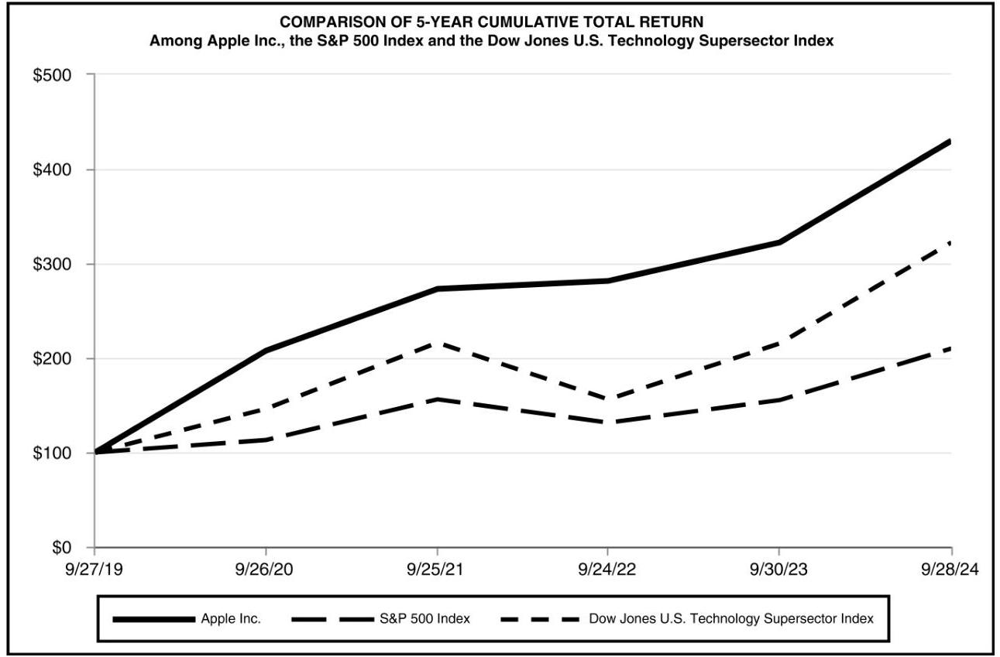

In [46]:
apple_10k_image_only_list= get_markdown_image_only(apple_10k_ocr)
apple_10k_image_only_list

In [47]:
nvidia_10k_text = get_markdown_text_only(nvidia_10k_ocr)

# Split the text into manageable chunks for processing
markdown_splitter = MarkdownTextSplitter(chunk_size=1024, chunk_overlap=512)
nvidia_10k_chunks = markdown_splitter.create_documents([nvidia_10k_text])
nvidia_10k_chunks

[Document(metadata={}, page_content="# UNITED STATES <br> SECURITIES AND EXCHANGE COMMISSION Washington, D.C. 20549 \n\n## FORM 10-K\n\n## 回 ANNUAL REPORT PURSUANT TO SECTION 13 OR 15(d) OF THE SECURITIES EXCHANGE ACT OF 1934\n\nFor the fiscal year ended January 26, 2025\nOR\n![img-0.jpeg](img-0.jpeg)\n\n## NVIDIA CORPORATION\n\n(Exact name of registrant as specified in its charter)\n\n## Delaware\n\n(State or other jurisdiction of incorporation or organization)\n\n## 94-3177549\n\n(I.R.S. Employer\n\nIdentification No.)\n\n## 2788 San Tomas Expressway, Santa Clara, California <br> (Address of principal executive offices)\n\n## Registrant's telephone number, including area code: (408) 486-2000\n\nSecurities registered pursuant to Section 12(b) of the Act:\n\n## Title of each class\n\nCommon Stock, $\\$ 0.001$ par value per share\n\n## Trading Symbol(s)\n\nNVDA\n\n## Name of each exchange on which registered\n\nThe Nasdaq Global Select Market\n\n## Securities registered pursuant to Sect

['',
 '']
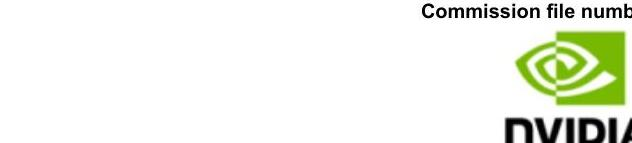
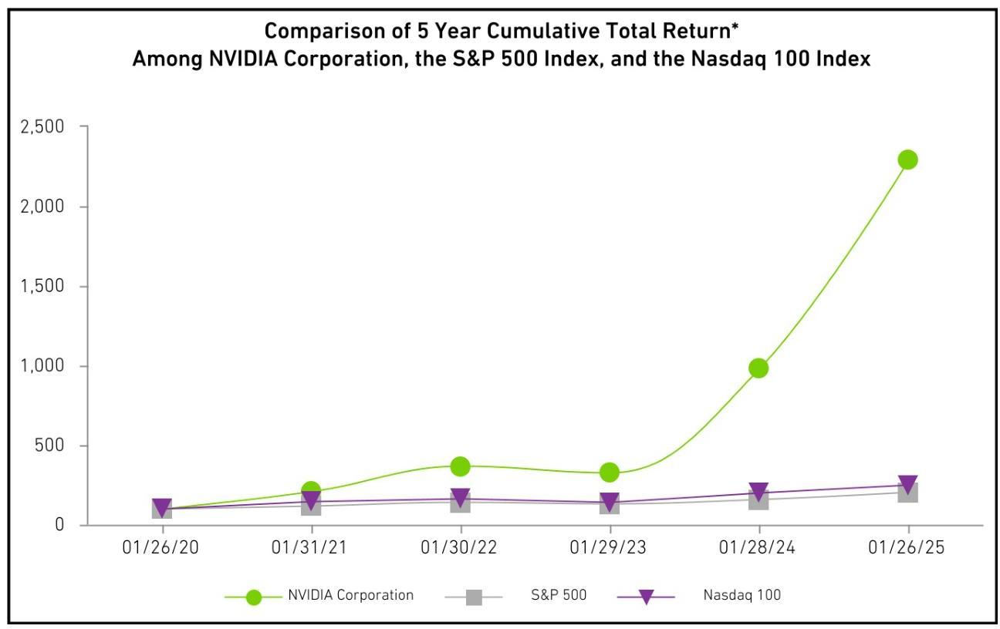

In [45]:
nvidia_10k_image_only_list= get_markdown_image_only(nvidia_10k_ocr)
nvidia_10k_image_only_list

## Embeddings

In [48]:
import cohere

In [51]:
co = cohere.ClientV2(api_key=os.getenv("COHERE_API_KEY"))

In [54]:
def cohere_text_embed(documents: list[str], batch_size: int = 96) -> list[float]:
    if not documents:
        return None
    text_to_embed = [doc.page_content for doc in documents]
    
    all_embeddings = []
    for i in range(0, len(text_to_embed), batch_size):
        batch_texts = text_to_embed[i:i+batch_size]
        response = co.embed(
            texts=batch_texts,
            model="embed-english-v3.0",
            input_type="search_document",
            embedding_types=["float"],
        )
        all_embeddings.extend(response.embeddings.float_)
    
    return all_embeddings

In [57]:
apple_10k_text_embeddings = cohere_text_embed(apple_10k_chunks)
apple_10k_text_embeddings

[[-0.029281616,
  -0.019378662,
  -0.06323242,
  -0.034973145,
  -0.016540527,
  -0.010574341,
  -0.028381348,
  0.04107666,
  -0.0059890747,
  0.021331787,
  0.026657104,
  -0.0073165894,
  -0.008102417,
  -0.051879883,
  0.030563354,
  -0.005138397,
  -0.0006132126,
  0.03427124,
  0.031707764,
  -0.0019359589,
  -0.0063934326,
  -0.007347107,
  0.0066833496,
  -0.05618286,
  -0.005012512,
  0.05368042,
  0.007587433,
  -0.049316406,
  -0.01374054,
  -0.00724411,
  0.0037059784,
  0.006549835,
  0.02609253,
  0.035064697,
  -0.047912598,
  0.07196045,
  0.0044937134,
  0.024627686,
  0.002401352,
  0.040985107,
  0.021194458,
  -0.041809082,
  0.06585693,
  -0.022537231,
  0.02192688,
  0.019454956,
  0.028762817,
  -0.03564453,
  0.005996704,
  -0.007663727,
  0.04071045,
  0.009979248,
  0.04156494,
  0.017318726,
  -0.013916016,
  0.020553589,
  -0.013168335,
  -0.013198853,
  0.007282257,
  0.0019721985,
  0.014915466,
  0.006072998,
  0.03286743,
  0.03552246,
  -0.05041504,
  0

In [58]:
nvidia_10k_text_embeddings = cohere_text_embed(nvidia_10k_chunks)
nvidia_10k_text_embeddings

[[0.006969452,
  -0.0131073,
  -0.010345459,
  -0.023330688,
  -0.014572144,
  -0.00046753883,
  0.0048599243,
  0.0082092285,
  0.032958984,
  -0.005455017,
  -0.018295288,
  -0.004875183,
  -0.039611816,
  -0.031051636,
  -0.0075416565,
  -0.025665283,
  0.015403748,
  0.0036010742,
  0.01739502,
  -0.018203735,
  0.009033203,
  -0.0059394836,
  0.013679504,
  -0.066711426,
  0.001080513,
  0.0017681122,
  0.046142578,
  -0.024307251,
  -0.0046043396,
  -0.024871826,
  0.012084961,
  0.009925842,
  0.031951904,
  -0.016525269,
  0.037841797,
  0.113708496,
  0.034454346,
  0.008415222,
  0.029083252,
  0.008216858,
  -0.004497528,
  -0.035888672,
  0.078186035,
  -0.06137085,
  0.019332886,
  0.03375244,
  0.0067481995,
  -0.010955811,
  -0.011688232,
  0.05810547,
  0.03744507,
  -0.015060425,
  0.020629883,
  0.035125732,
  0.004337311,
  0.013061523,
  -0.024017334,
  0.02947998,
  0.019500732,
  0.010932922,
  -0.007850647,
  0.008651733,
  0.009841919,
  0.006942749,
  -0.040008

## Metadata Creation and Pinecone Upsert

In [71]:
def pinecone_upsert(index, namespace, embeddings, metadata, id):
    '''
    Upsert embeddings and metadata into Pinecone
    '''
    if not embeddings:
        return
    
    # getting the id for entire embedding - will modify this for each chunk

    zip_embeddings = zip(embeddings, metadata)

    for i, (chunk_embedding, chunk_metadata) in enumerate(zip_embeddings):
        chunk_id = f"{id}_{i}"
        if index.fetch([chunk_id])['vectors']:
            print(f"ID {chunk_id} already exists in the database. Skipping upsert.")
            continue
        else:
            index.upsert(
                vectors=[{
                    'id': chunk_id,
                    'values': chunk_embedding,
                    'metadata': chunk_metadata
                }],
                namespace=namespace
            )
            print(f"Upserted {chunk_id} to Pinecone")
    return None

In [72]:
def create_text_metadata(documents: list[str]) -> dict:
    '''
    Create metadata for the embeddings
    '''
    metadata = []
    for doc in documents:
        metadata.append({
            "chunk_content": doc.page_content,
            "type": "text"
        })
    return metadata

# def create_image_metadata(documents: list[str], bucket_name: str) -> dict:
#     '''
#     Create metadata for the embeddings
#     '''
    
#     metadata = []

#     for i, doc in enumerate(documents):
#         blob_name = f"images/image_{i}.jpeg"
#         if upload_base64_to_gcp(doc, blob_name, bucket_name):
#             print(f"Successfully uploaded {blob_name} to GCP")
#             # public_url = get_public_url(bucket_name, blob_name)

#         metadata.append({
#             "chunk_content": blob_name,
#             "type": "image"
#         })
#     return metadata


In [67]:
apple_10k_text_metadata = create_text_metadata(apple_10k_chunks)
nvidia_10k_text_metadata = create_text_metadata(nvidia_10k_chunks)

In [73]:
pinecone_upsert(index, "apple_10k", apple_10k_text_embeddings, apple_10k_text_metadata, "apple_10k_2024")
pinecone_upsert(index, "nvidia_10k", nvidia_10k_text_embeddings, nvidia_10k_text_metadata, "nvidia_10k_2025")

Upserted apple_10k_2024_0 to Pinecone
Upserted apple_10k_2024_1 to Pinecone
Upserted apple_10k_2024_2 to Pinecone
Upserted apple_10k_2024_3 to Pinecone
Upserted apple_10k_2024_4 to Pinecone
Upserted apple_10k_2024_5 to Pinecone
Upserted apple_10k_2024_6 to Pinecone
Upserted apple_10k_2024_7 to Pinecone
Upserted apple_10k_2024_8 to Pinecone
Upserted apple_10k_2024_9 to Pinecone
Upserted apple_10k_2024_10 to Pinecone
Upserted apple_10k_2024_11 to Pinecone
Upserted apple_10k_2024_12 to Pinecone
Upserted apple_10k_2024_13 to Pinecone
Upserted apple_10k_2024_14 to Pinecone
Upserted apple_10k_2024_15 to Pinecone
Upserted apple_10k_2024_16 to Pinecone
Upserted apple_10k_2024_17 to Pinecone
Upserted apple_10k_2024_18 to Pinecone
Upserted apple_10k_2024_19 to Pinecone
Upserted apple_10k_2024_20 to Pinecone
Upserted apple_10k_2024_21 to Pinecone
Upserted apple_10k_2024_22 to Pinecone
Upserted apple_10k_2024_23 to Pinecone
Upserted apple_10k_2024_24 to Pinecone
Upserted apple_10k_2024_25 to Pinec